
# Projet 5 - Segmentation des Clients d'un Site E-Commerce

## Partie 2 de 3

# 1. Résumé

L'objectif du projet est de segmenter des clients du site e-commerce, ce qu'inclu :

* **comprendre les différents types d’utilisateurs** grâce à leur comportement et à leurs données personnelles
* fournir à l’équipe marketing **une description actionable de la segmentation** et de sa logique sous-jacente pour une utilisation optimale
* **proposer un contrat de maintenance** basée sur une analyse de la stabilité des segments au cours du temps

Dans le premier notebook du projet on a consolidé les informations sur les commandes et les clients dans deux datasets. On a aussi fait un nettoyage et un exploration des données pour ce préparer au modélisation.
**Dans ce notebook, on test plusieurs modèles avec des différents features et nombre de clusters.**

# 2. Les Imports

## 2.1 Les Bibliothèques et Styles

In [3]:
#imports: regular expresssions, operating system, math operations
#import re,os,math
import re, os, random, datetime
#from math import sin, cos, sqrt, atan2, radians, degrees
#from cmath import rect, phase
from ast import literal_eval

#data modules
import numpy as np
import pandas as pd
import scipy as sp

#graphic modules
import matplotlib.pyplot as plt
import matplotlib.dates as dates
from matplotlib.colors import ListedColormap

import seaborn as sns

In [4]:
#les functions de sklearn
from sklearn.preprocessing import FunctionTransformer, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA, FactorAnalysis, KernelPCA
from sklearn.cluster import KMeans, AgglomerativeClustering, Birch, DBSCAN
from sklearn.manifold import MDS, Isomap, LocallyLinearEmbedding, TSNE
from sklearn.mixture import GaussianMixture


from sklearn import metrics

#Le module FactorAnalyzer
from factor_analyzer import FactorAnalyzer
from factor_analyzer.factor_analyzer import calculate_bartlett_sphericity
from factor_analyzer.factor_analyzer import calculate_kmo

In [5]:
sns.set() #sets the theme of seaborn
#creates static png images of the plots within the notebook (other option: 'notebook' for interactive plots)
%matplotlib inline 

## 2.2 Les Données

In [4]:
PATH_TO_DATA = os.getcwd() + '\\DataCleaned\\'
customers_df = pd.read_csv(PATH_TO_DATA + 'Olist_Cleaned_Customers' + '.csv')

In [5]:
customers_df

,Unnamed: 0,customer_unique_id,last_purchase_date,recency,number_of_purchases,repeat_customer,monetary,online_timeofday,purchase_timeofday,review_timeofday,...,used_voucher,used_boleto,used_card,order_payment_total,review_score,review_response_time,has_review_title,has_review_message,has_review,review_response_speed
0,0,861eff4711a542e4b93843c6dd7febb0,2017-05-16 15:05:35,-519.100498,1,False,146.87,18.833333,15.083333,22.566667,...,0.0,0.0,1.0,146.87,4.0,4.940741,0.0,0.0,1.0,0.168329
1,1,290c77bc529b7ac935b93aa66c333dc3,2018-01-12 20:48:24,-277.862431,1,False,335.48,21.750000,20.800000,22.716667,...,0.0,0.0,1.0,335.48,5.0,11.946863,0.0,0.0,1.0,0.077239
2,2,060e732b5b29e8181a18229c7b0b2b5e,2018-05-19 16:07:45,-151.057326,1,False,157.73,14.150000,16.116667,12.166667,...,0.0,0.0,1.0,157.73,5.0,0.507627,0.0,0.0,1.0,0.663294
3,3,259dac757896d24d7702b9acbbff3f3c,2018-03-13 16:06:38,-218.058102,1,False,173.30,17.350000,16.100000,18.600000,...,0.0,0.0,1.0,173.30,5.0,4.775544,0.0,0.0,1.0,0.173144
4,4,345ecd01c38d18a9036ed96c73b8d066,2018-07-29 09:51:30,-80.318611,1,False,252.25,5.916667,9.850000,25.983333,...,0.0,0.0,1.0,252.25,5.0,7.083241,1.0,1.0,1.0,0.123713
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96084,96084,1a29b476fee25c95fbafc67c5ac95cf8,2018-04-07 15:48:17,-193.070845,1,False,88.78,13.516667,15.800000,11.250000,...,0.0,0.0,1.0,88.78,4.0,14.468796,1.0,0.0,1.0,0.064646
96085,96085,d52a67c98be1cf6a5c84435bd38d095d,2018-04-04 08:20:22,-196.381898,1,False,129.06,9.466667,8.333333,10.600000,...,0.0,0.0,1.0,129.06,5.0,4.441725,0.0,0.0,1.0,0.183765
96086,96086,e9f50caf99f032f0bf3c55141f019d99,2018-04-08 20:11:50,-191.887824,1,False,56.04,22.933333,20.183333,25.683333,...,0.0,0.0,1.0,56.04,1.0,4.070220,1.0,1.0,1.0,0.197230
96087,96087,73c2643a0a458b49f58cea58833b192e,2017-11-03 21:08:33,-347.848438,1,False,711.07,22.350000,21.133333,23.566667,...,0.0,0.0,1.0,711.07,5.0,2.982153,0.0,0.0,1.0,0.251120


In [6]:
customers_df.drop(columns=['Unnamed: 0'],inplace=True)
customers_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96089 entries, 0 to 96088
Data columns (total 39 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   customer_unique_id                 96089 non-null  object 
 1   last_purchase_date                 96089 non-null  object 
 2   recency                            96089 non-null  float64
 3   number_of_purchases                96089 non-null  int64  
 4   repeat_customer                    96089 non-null  bool   
 5   monetary                           96089 non-null  float64
 6   online_timeofday                   96089 non-null  float64
 7   purchase_timeofday                 96089 non-null  float64
 8   review_timeofday                   96089 non-null  float64
 9   delivery_time                      96089 non-null  float64
 10  delivery_speed                     96089 non-null  float64
 11  delivery_delay                     96089 non-null  flo

# 3. Les Généralités et Fonctions

## 3.1 Initialisation des Dictionnaires et Préferences

In [7]:
seed = 42

In [8]:
#Creating the projections takes the most time, so one might not want to run them. Especially, if one has already done so.
global_do_projections = True

In [9]:
all_my_models = {}
all_my_projections = {}

## 3.2 Le Prétraitement

### 3.2.1 Transformers Personnalisés

In [10]:
logscale_transformer = FunctionTransformer(np.log, inverse_func = np.exp, check_inverse = True)
log1pscale_transformer = FunctionTransformer(np.log1p, inverse_func = np.expm1, check_inverse = True)

### 3.2.2 Création des Préprocesseurs

In [11]:
def create_preprocessor_X(logscale_features = [], standardscale_features = [], log1pscale_features = []) :

    preprocessor_X = ColumnTransformer(transformers = [  
                                                         ('logscale', Pipeline([('log', logscale_transformer),
                                                                                ('standard', StandardScaler())]), 
                                                                      logscale_features),
                                                         ('log1pscale', Pipeline([('log1p', log1pscale_transformer),
                                                                                  ('standard', StandardScaler())]), 
                                                                      log1pscale_features),
                                                         ('standardscale', StandardScaler(), standardscale_features),
                                                        ], remainder = 'passthrough')
    return preprocessor_X

## 3.3 Evaluation, Collection des Informations

In [12]:
def test_model(X_scaled, model_type = "KMeans"):
    '''Run the Kmeans (or others) model with different cluster sizes and output clustering metrics in form of a dictionnary.'''
    model_dict = {}
    model_list = []
    score = []
    silhouette = []
    calinski_harabasz = []
    davies_bouldin = []
    n_clusters = []
    for i in range(3,20):
        if model_type == "KMeans":
            model = KMeans(n_clusters=i, random_state=33)
        elif model_type == "GaussianMixture":
            model = GaussianMixture(n_components=i, random_state=33)
        elif model_type == "Birch":
            model = Birch(n_clusters=i)
        model_list.append(model)
        X_labels = model.fit_predict(X_scaled)
        if model_type in ["KMeans", "GaussianMixture"]:
            score.append(model.score(X_scaled))
        else :
            score.append(0)
        silhouette.append(metrics.silhouette_score(X_scaled, X_labels))
        calinski_harabasz.append(metrics.calinski_harabasz_score(X_scaled, X_labels))
        davies_bouldin.append(metrics.davies_bouldin_score(X_scaled, X_labels))
        n_clusters.append(i)
    model_dict["models"] = model_list
    model_dict["n_clusters"] = n_clusters
    model_dict["score"] = score
    model_dict["silouette_score"] = silhouette
    model_dict["c_h_score"] = calinski_harabasz
    model_dict["d_b_score"] = davies_bouldin
    return model_dict

In [13]:
def create_projections_dict(projection_version, X_labels, X_labels_reduced):
    projections_dict = {}
    for key, proj in all_my_projections[projection_version].items():
        if key not in ["MDS"]:
            projections_dict[key] = (proj["X_proj"], X_labels)
        else:
            projections_dict[key] = (proj["X_proj"], X_labels_reduced)
    return projections_dict

## 3.4 Visualisation

In [14]:
def display_scree_plot(pca, name='',savefigure = False):
    '''Display a scree plot for the pca'''

    scree = pca.explained_variance_ratio_*100
    plt.bar(np.arange(len(scree))+1, scree)
    plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red",marker='o')
    plt.xlabel("Rang de l'axe d'inertie")
    plt.ylabel("Pourcentage d'inertie")
    plt.title("Eboulis des valeurs propres")
    #plt.title("Scree plot")
    if savefigure :
        plt.savefig(os.getcwd() + '\\Figures\\' + name +'_ScreePlot', dpi = 200)
    plt.show(block=False)

In [15]:
def display_circles(pcs, n_comp, pca, axis_ranks, labels=None, label_rotation=0, lims=None):
    """Display correlation circles, one for each factorial plane"""

    # For each factorial plane
    for d1, d2 in axis_ranks: 
        if d2 < n_comp:

            # Initialise the matplotlib figure
            fig, ax = plt.subplots(figsize=(10,10))

            # Determine the limits of the chart
            if lims is not None :
                xmin, xmax, ymin, ymax = lims
            elif pcs.shape[1] < 30 :
                xmin, xmax, ymin, ymax = -1, 1, -1, 1
            else :
                xmin, xmax, ymin, ymax = min(pcs[d1,:]), max(pcs[d1,:]), min(pcs[d2,:]), max(pcs[d2,:])

            # Add arrows
            # If there are more than 30 arrows, we do not display the triangle at the end
            if pcs.shape[1] < 30 :
                plt.quiver(np.zeros(pcs.shape[1]), np.zeros(pcs.shape[1]),
                   pcs[d1,:], pcs[d2,:], 
                   angles='xy', scale_units='xy', scale=1, color="grey")
                # (see the doc : https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html)
            else:
                lines = [[[0,0],[x,y]] for x,y in pcs[[d1,d2]].T]
                ax.add_collection(LineCollection(lines, axes=ax, alpha=.1, color='black'))
            
            # Display variable names
            if labels is not None:  
                for i,(x, y) in enumerate(pcs[[d1,d2]].T):
                    if x >= xmin and x <= xmax and y >= ymin and y <= ymax :
                        plt.text(x, y, labels[i], fontsize='14', ha='center', va='center', 
                                 rotation=label_rotation, color="blue", alpha=0.5)
            
            # Display circle
            circle = plt.Circle((0,0), 1, facecolor='none', edgecolor='b')
            plt.gca().add_artist(circle)

            # Define the limits of the chart
            #plt.xlim(xmin, xmax)
            #plt.ylim(ymin, ymax)
        
            # Display grid lines
            plt.plot([-1, 1], [0, 0], color='grey', ls='--')
            plt.plot([0, 0], [-1, 1], color='grey', ls='--')

            # Label the axes, with the percentage of variance explained
            plt.xlabel('PC{} ({}%)'.format(d1+1, round(100*pca.explained_variance_ratio_[d1],1)))
            plt.ylabel('PC{} ({}%)'.format(d2+1, round(100*pca.explained_variance_ratio_[d2],1)))

            plt.title("Correlation Circle (PC{} and PC{})".format(d1+1, d2+1))
            plt.show(block=False)

In [53]:
def plot_model_evaluation(model_dict, figsize=(16,8)):
    '''Plot the Clustering Metrics saved in a dictionary'''  
    n_clusters = model_dict["n_clusters"]
    fig, axs = plt.subplots(2,2, figsize=figsize)
    
    #the smaller the better
    axs[0,0].plot(n_clusters, model_dict['score'])
    axs[0,0].set_title("Score", y=0.9)

    #The score is bounded between -1 for incorrect clustering and +1 for highly dense clustering. 
    #Scores around zero indicate overlapping clusters.
    axs[0,1].plot(n_clusters, model_dict['silouette_score'])
    axs[0,1].set_title("Silouhette", y=0.9)

    #Zero is the lowest possible score. Values closer to zero indicate a better partition.
    axs[1,0].plot(n_clusters, model_dict['d_b_score'])
    axs[1,0].set_title("Davies Bouldin", y=0.9)
    axs[1,0].set_xlabel("Nombre de Clusters")
    
    #The score is higher when clusters are dense and well separated, 
    #which relates to a standard concept of a cluster
    axs[1,1].plot(n_clusters, model_dict['c_h_score'])
    axs[1,1].set_title("Calinski Harabasz", y=0.9)
    axs[1,1].set_xlabel("Nombre de Clusters")

    fig.tight_layout()
    plt.show()

In [17]:
def plot_model_2D_projections(projections_dict):
    '''Plot the Clustering in a 2D projections'''  
    x_total = (len(projections_dict) // 2)
    fig, axs = plt.subplots(x_total, 2, figsize=(16,8*x_total))
    for i, (key, proj) in enumerate(projections_dict.items()):
        x = i // 2
        y = i % 2
        X_proj, X_labels = proj
        axs[x,y].scatter(X_proj[:,0], X_proj[:,1], c=X_labels, 
                         cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels))), s=1)
        axs[x,y].set_title(key)
        axs[x,y].set_xlabel('Composante #1')
        axs[x,y].set_ylabel('Composante #2')

    fig.tight_layout()
    plt.show()

# 4. Exploration des Données

## 4.1 Matrix de Corrélation

In [18]:
X = customers_df.copy()

<AxesSubplot:>

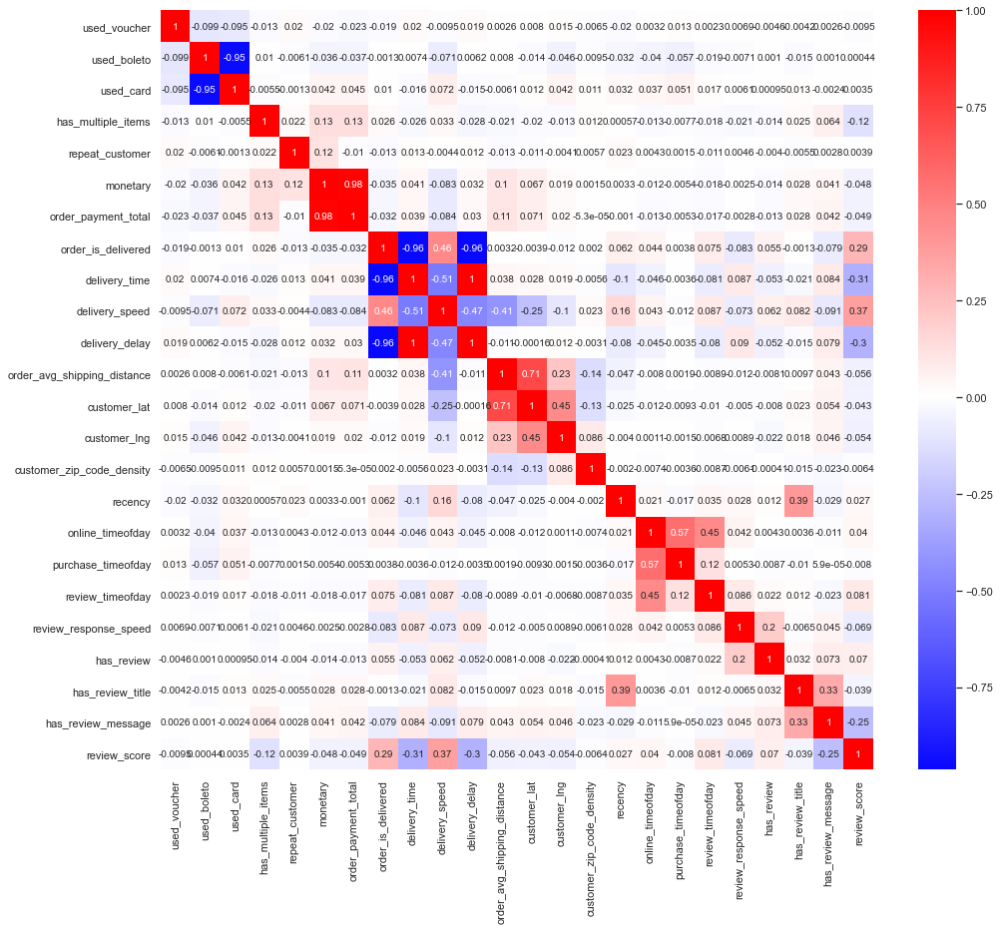

In [19]:
features_ordered = ['used_voucher', 'used_boleto', 'used_card',
                    'has_multiple_items', 'repeat_customer',
                    'monetary', 'order_payment_total', 'order_is_delivered',
                    'delivery_time', 'delivery_speed', 'delivery_delay', 'order_avg_shipping_distance',
                    'customer_lat', 'customer_lng', 'customer_zip_code_density',
                    'recency', 'online_timeofday', 'purchase_timeofday','review_timeofday',
                    'review_response_speed', 'has_review', 'has_review_title', 'has_review_message', 'review_score',]
corr = X[features_ordered].dropna().corr()
fig, ax = plt.subplots(figsize = (16,14))
sns.heatmap(corr, center = 0, cmap = 'bwr', annot = True, cbar = True)

## 4.2 Réduction de Dimension

### 4.2.1 Choix des Features

In [20]:
passthrough_features =[]
standardscale_features = ['delivery_speed', 'review_response_speed', 'has_review_title', 'has_review_message',
                          'has_multiple_items', 'repeat_customer', 'used_voucher', 'used_boleto']
standardscale_features += ['recency', 'purchase_timeofday', 'review_timeofday',
                           'delivery_delay', 'review_score']
log1pscale_features = ['order_payment_total', 'order_avg_shipping_distance']
logscale_features = ['customer_zip_code_density']
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [21]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)
all_components = len(X_scaled.columns)

In [22]:
X_scaled.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 96088 entries, 0 to 96088
Data columns (total 16 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   customer_zip_code_density    96088 non-null  float64
 1   order_payment_total          96088 non-null  float64
 2   order_avg_shipping_distance  96088 non-null  float64
 3   delivery_speed               96088 non-null  float64
 4   review_response_speed        96088 non-null  float64
 5   has_review_title             96088 non-null  float64
 6   has_review_message           96088 non-null  float64
 7   has_multiple_items           96088 non-null  float64
 8   repeat_customer              96088 non-null  float64
 9   used_voucher                 96088 non-null  float64
 10  used_boleto                  96088 non-null  float64
 11  recency                      96088 non-null  float64
 12  purchase_timeofday           96088 non-null  float64
 13  review_timeofday

### 4.2.2 PCA

In [23]:
# Create the PCA model
pca = PCA(n_components=all_components)

# Fit the model with the standardised data
X_pca = pca.fit_transform(X_scaled)

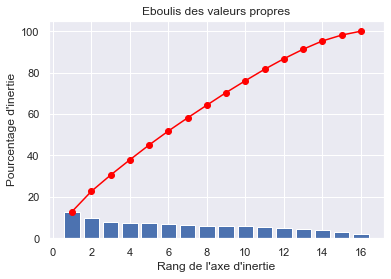

In [24]:
display_scree_plot(pca, name='PCA')

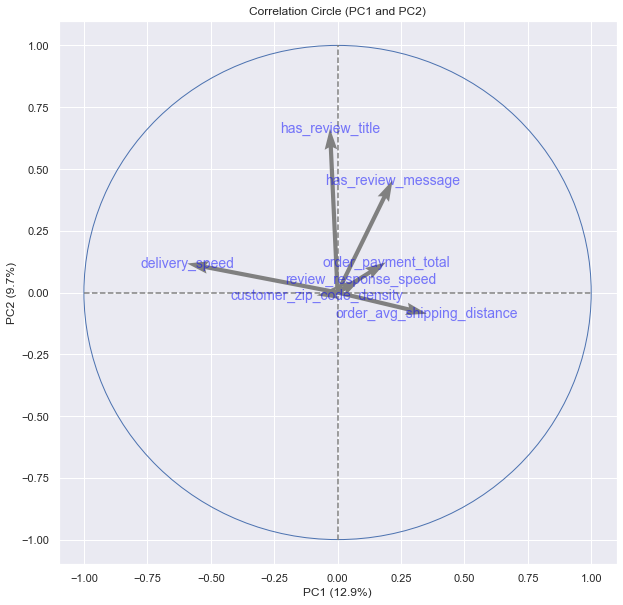

In [25]:
# Generate a correlation circle
display_circles(pca.components_[:,0:7], all_components, pca, [(0,1)], labels = np.array(X_scaled.columns),) 

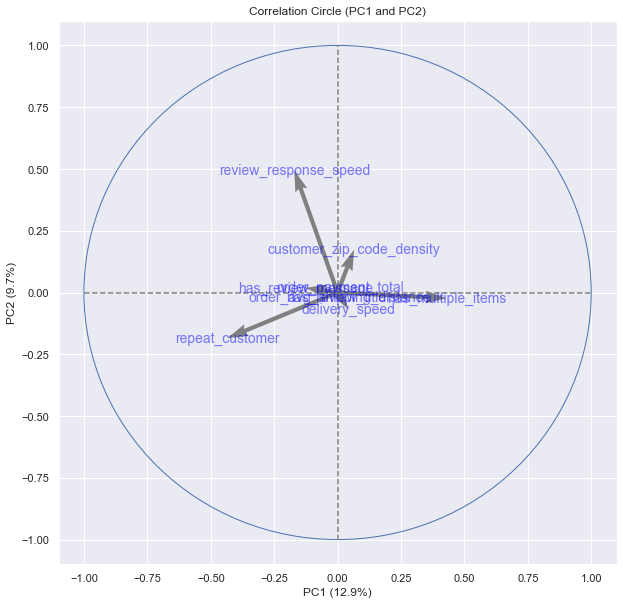

In [26]:
# Generate a correlation circle
display_circles(pca.components_[:,7:], all_components, pca, [(0,1)], labels = np.array(X_scaled.columns),) 

<AxesSubplot:>

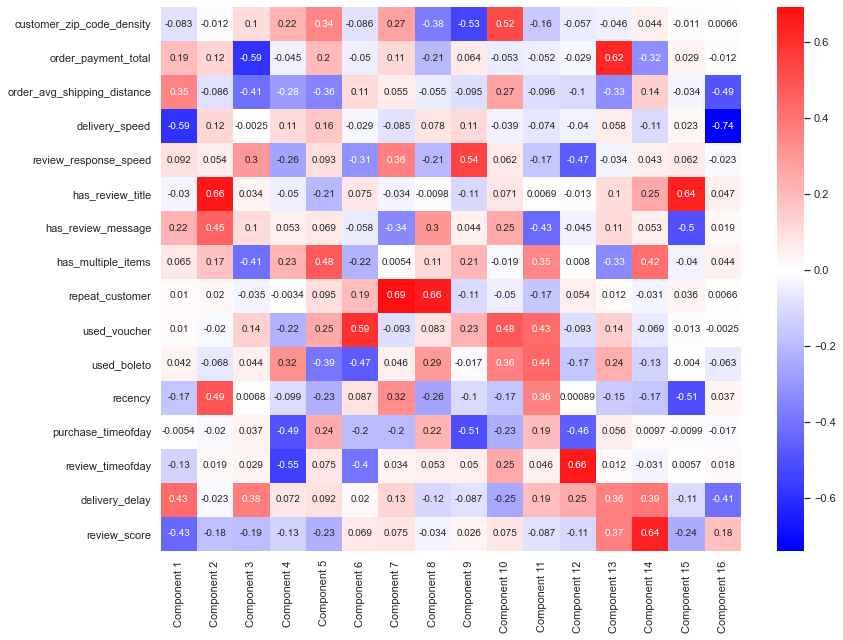

In [27]:
comps = pd.DataFrame(pca.components_, columns=X_scaled.columns, 
             index=['Component ' + str(i+1) for i in range(pca.components_.shape[0])]).T
fig, ax = plt.subplots(figsize = (13,10))
sns.heatmap(comps, center = 0, cmap = 'bwr', annot = True, cbar = True)

Text(0, 0.5, 'Composante #2')

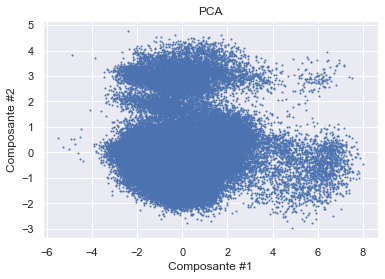

In [28]:
plt.scatter(X_pca[:,0], X_pca[:,1], s=1)
plt.title('PCA')
plt.xlabel('Composante #1')
plt.ylabel('Composante #2')

Text(0, 0.5, 'Composante #4')

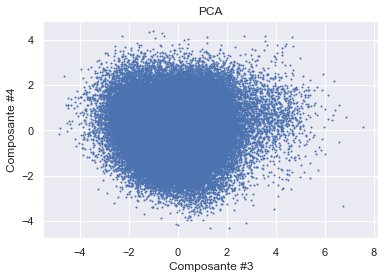

In [29]:
plt.scatter(X_pca[:,2], X_pca[:,3], s=1)
plt.title('PCA')
plt.xlabel('Composante #3')
plt.ylabel('Composante #4')

### 4.2.3 Factor Analysis

In [30]:
#CHECK ADEQUACY
#Bartlett
#p-value should be 0 (statistically sig.)
chi_square_value,p_value=calculate_bartlett_sphericity(X_scaled)
print(chi_square_value, p_value)

#KMO
#Value should be 0.6<
kmo_all,kmo_model=calculate_kmo(X_scaled)
print(kmo_model)

136221.44459931107 0.0
0.505998521198658


In [31]:
passthrough_features =[]
passthrough_features = ['delivery_speed', 'review_response_speed',
                          'repeat_customer', 'used_voucher', 'used_boleto']
standardscale_features = ['recency', 'purchase_timeofday', 'review_timeofday',
                           'delivery_delay', 'review_score']
log1pscale_features = ['order_payment_total']
logscale_features = ['customer_zip_code_density']
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [32]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)
all_components = len(X_scaled.columns)

In [33]:
#CHECK ADEQUACY
#Bartlett
#p-value should be 0 (statistically sig.)
chi_square_value,p_value=calculate_bartlett_sphericity(X_scaled)
print(chi_square_value, p_value)

#KMO
#Value should be 0.6<
kmo_all,kmo_model=calculate_kmo(X_scaled)
print(kmo_model)

53114.511823061366 0.0
0.6108624405910011


c:\users\bookj\environments\jupenv\lib\site-packages\factor_analyzer\utils.py:249: UserWarning: The inverse of the variance-covariance matrix was calculated using the Moore-Penrose generalized matrix inversion, due to its determinant being at or very close to zero.
  warnings.warn('The inverse of the variance-covariance matrix '


In [34]:
fa = FactorAnalyzer(all_components, rotation=None)
fa.fit(X_scaled)
ev, v = fa.get_eigenvalues()

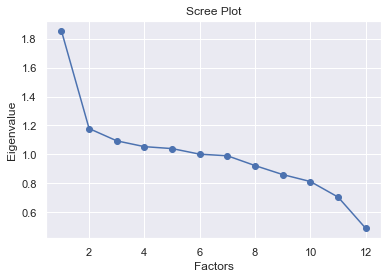

In [35]:
plt.scatter(range(1,X_scaled.shape[1]+1),ev)
plt.plot(range(1,X_scaled.shape[1]+1),ev)
plt.title('Scree Plot')
plt.xlabel('Factors')
plt.ylabel('Eigenvalue')
plt.show()

In [36]:
#varimax, promax, oblimin, oblimax, quartimin, quartimax, equamax
fa = FactorAnalyzer(1, rotation='varimax')
fa.fit(X_scaled)
ev, v = fa.get_eigenvalues()

c:\users\bookj\environments\jupenv\lib\site-packages\factor_analyzer\factor_analyzer.py:656: UserWarning: No rotation will be performed when the number of factors equals 1.
  warnings.warn('No rotation will be performed when '


In [37]:
loadings = pd.DataFrame(fa.loadings_, columns=['Factor ' + str(i+1) for i in range(fa.loadings_.shape[1])], 
                        index=X_scaled.columns)
loadings

,Factor 1
customer_zip_code_density,0.051199
order_payment_total,-0.115016
recency,0.149092
purchase_timeofday,0.002584
review_timeofday,0.121830
delivery_delay,-0.584960
review_score,0.469513
delivery_speed,0.812062
review_response_speed,-0.100882
repeat_customer,-0.006086


In [38]:
pd.DataFrame(fa.get_communalities(), columns = ['Communality'], index=X_scaled.columns).sort_values(by='Communality',
                                                                                                   ascending=False)

,Communality
delivery_speed,0.659445
delivery_delay,0.342178
review_score,0.220442
recency,0.022228
review_timeofday,0.014843
order_payment_total,0.013229
review_response_speed,0.010177
customer_zip_code_density,0.002621
used_boleto,0.002100
used_voucher,0.000198


## 4.3 Projection en 2D

### 4.3.4 Choix des Features

In [39]:
#passthrough_features =[]
passthrough_features = ['delivery_speed', 'review_response_speed', 'has_review_title', 'has_review_message',
                          'has_multiple_items', 'repeat_customer', 'used_voucher', 'used_boleto']
standardscale_features = ['recency', 'purchase_timeofday', 'review_timeofday',
                           'delivery_delay', 'review_score']
log1pscale_features = ['order_payment_total', 'order_avg_shipping_distance']
logscale_features = ['customer_zip_code_density']
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [40]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)
all_components = len(X_scaled.columns)

### 4.3.5 Réduction de Nombre d'Entrées

In [41]:
seed=42
X_reduced = X_scaled.sample(frac=0.05, random_state=seed).astype(np.float32)
X_reduced

,customer_zip_code_density,order_payment_total,order_avg_shipping_distance,recency,purchase_timeofday,review_timeofday,delivery_delay,review_score,delivery_speed,review_response_speed,has_review_title,has_review_message,has_multiple_items,repeat_customer,used_voucher,used_boleto
36909,0.127666,-0.922211,-0.210527,0.234129,-1.112484,-0.906439,-0.006406,-2.297030,0.247829,0.644757,0.0,0.0,0.0,0.0,0.0,0.0
54623,-0.991452,-0.153872,0.535400,-0.388032,1.734555,-2.076979,-0.169253,0.689147,0.483281,0.159264,0.0,0.0,0.0,0.0,0.0,0.0
44651,-1.284504,0.931002,1.160912,0.801317,-1.098494,0.031187,-0.148818,-0.057397,0.382437,0.265302,0.0,0.0,0.0,0.0,0.0,0.0
26894,-0.764144,1.516786,1.348365,-0.728092,0.912621,-1.423030,-0.276617,0.689147,0.558551,0.411409,0.0,1.0,1.0,0.0,0.0,0.0
25782,0.209203,0.772265,-2.524258,1.024893,0.387982,-0.739220,-0.080289,0.689147,0.581235,0.217858,1.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36174,1.246784,0.857752,0.963983,-0.370982,-0.203111,-0.760122,-0.274935,0.689147,0.578661,0.386863,0.0,0.0,0.0,0.0,0.0,1.0
59655,1.188559,0.229236,0.805022,0.477146,0.286552,-1.443932,1.999461,-0.803942,0.000000,0.701173,0.0,1.0,0.0,0.0,0.0,0.0
10329,0.540699,-1.589324,0.310131,1.250232,-1.801510,1.079297,-0.102412,0.689147,0.463202,0.199480,0.0,0.0,0.0,0.0,0.0,0.0
40204,-0.578419,-1.019287,0.497497,0.741725,-1.808505,0.804579,-0.233658,0.689147,0.573870,0.513067,0.0,0.0,0.0,0.0,0.0,0.0


### 4.3.6 MDS

In [42]:
mds = MDS(n_components=2)
X_reduced_mds = mds.fit_transform(X_reduced)

Text(0, 0.5, 'Composante #2')

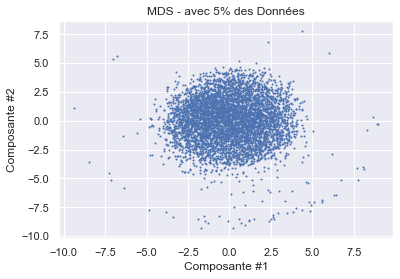

In [43]:
plt.scatter(X_reduced_mds[:,0], X_reduced_mds[:,1], s=1)
plt.title('MDS - avec 5% des Données')
plt.xlabel('Composante #1')
plt.ylabel('Composante #2')

### 4.3.7 Isomap

In [44]:
iso = Isomap(n_components=2)
X_reduced_iso = iso.fit_transform(X_reduced)

Text(0, 0.5, 'Composante #2')

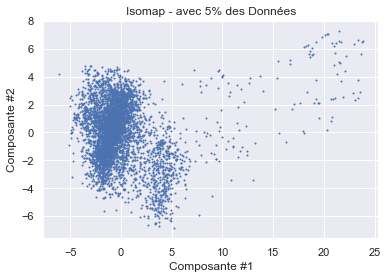

In [45]:
plt.scatter(X_reduced_iso[:,0], X_reduced_iso[:,1], s=1)
plt.title('Isomap - avec 5% des Données')
plt.xlabel('Composante #1')
plt.ylabel('Composante #2')

### 4.3.8 Locally Linear Embedding

In [46]:
lle = LocallyLinearEmbedding(n_components=2)
X_reduced_lle = lle.fit_transform(X_reduced)

Text(0, 0.5, 'Composante #2')

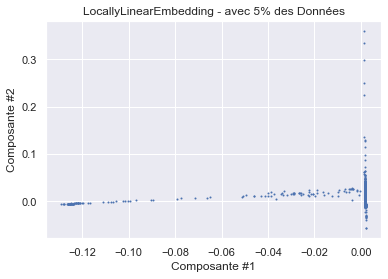

In [47]:
plt.scatter(X_reduced_lle[:,0], X_reduced_lle[:,1], s=1)
plt.title('LocallyLinearEmbedding - avec 5% des Données')
plt.xlabel('Composante #1')
plt.ylabel('Composante #2')

### 4.3.9 t-SNE

#### Paramètres de Défaut

In [48]:
tsne = TSNE(n_components=2, init='pca')
X_reduced_tsne0 = tsne.fit_transform(X_reduced)

Text(0, 0.5, 'Composante #2')

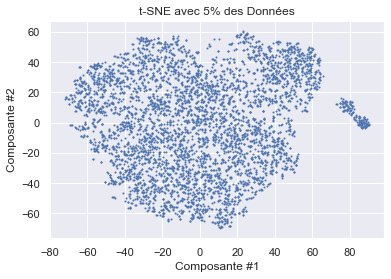

In [49]:
plt.scatter(X_reduced_tsne0[:,0], X_reduced_tsne0[:,1], s=1)
plt.title('t-SNE avec 5% des Données')
plt.xlabel('Composante #1')
plt.ylabel('Composante #2')

# -- BREAK Store/Reload Data --

In [51]:
import dill
dill.dump_session('notebook_envChap4.db')

In [1]:
import dill
dill.load_session('notebook_envChap4.db')

# 5. Modèles - Vérsion 0

## 5.1 Sélection des Features

In [98]:
passthrough_features = ['repeat_customer']
standardscale_features = ['recency', 'review_score']
log1pscale_features = ['order_payment_total']
logscale_features = []
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [99]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)

X_reduced = X_scaled.sample(frac=0.05, random_state=seed).astype(np.float32)
all_components = len(X_scaled.columns)

## 5.2  Créations des Projections

In [56]:
projection_version = "Version0"
do_projection = True & global_do_projections

In [57]:
if do_projection :
    all_my_projections[projection_version] = {}

#### PCA

In [58]:
if do_projection :
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)
    all_my_projections[projection_version]["PCA"] = {"X_proj" : X_pca, "model": pca}

#### MDS

In [59]:
if do_projection :
    mds = MDS(n_components=2)
    X_reduced_mds = mds.fit_transform(X_reduced)
    all_my_projections[projection_version]["MDS"] = {"X_proj" : X_reduced_mds, "model": mds}

#### Isomap

In [60]:
if do_projection :
    iso = Isomap(n_components=2)
    X_reduced_iso = iso.fit_transform(X_reduced)
    X_iso = iso.transform(X_scaled)
    all_my_projections[projection_version]["Isomap"] = {"X_proj" : X_iso, "model": iso}

#### t_SNE

In [61]:
if do_projection :
    tsne = TSNE(n_components=2, init='pca')
    X_tsne0 = tsne.fit_transform(X_scaled)
    all_my_projections[projection_version]["TSNE_0"] = {"X_proj" : X_tsne0, "model": tsne}

## -- BREAK Store/Reload Data --

In [62]:
dill.dump_session('notebook_env.db')

In [2]:
dill.load_session('notebook_env.db')

## 5.3 K-Means - Vérsion 0

In [100]:
model_name = "KMeans_0"

### 5.3.1 Evaluation du Modèle

In [65]:
model_dict = test_model(X_reduced)
all_my_models[model_name] = model_dict

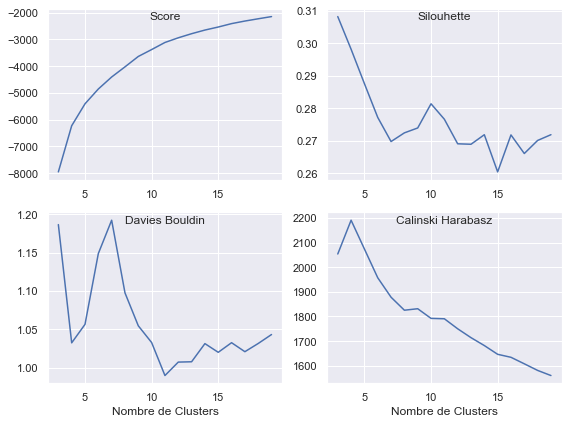

In [698]:
model_dict = all_my_models["KMeans_0"]
plot_model_evaluation(model_dict, figsize=(8,6))

### 5.3.2 Choisir un Modèle

In [101]:
n_clusters = 4
km = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = km.fit_predict(X_scaled)
X_labels_reduced = km.predict(X_reduced.astype(float))

### 5.3.3 Visualisation des Clusters en 2-D

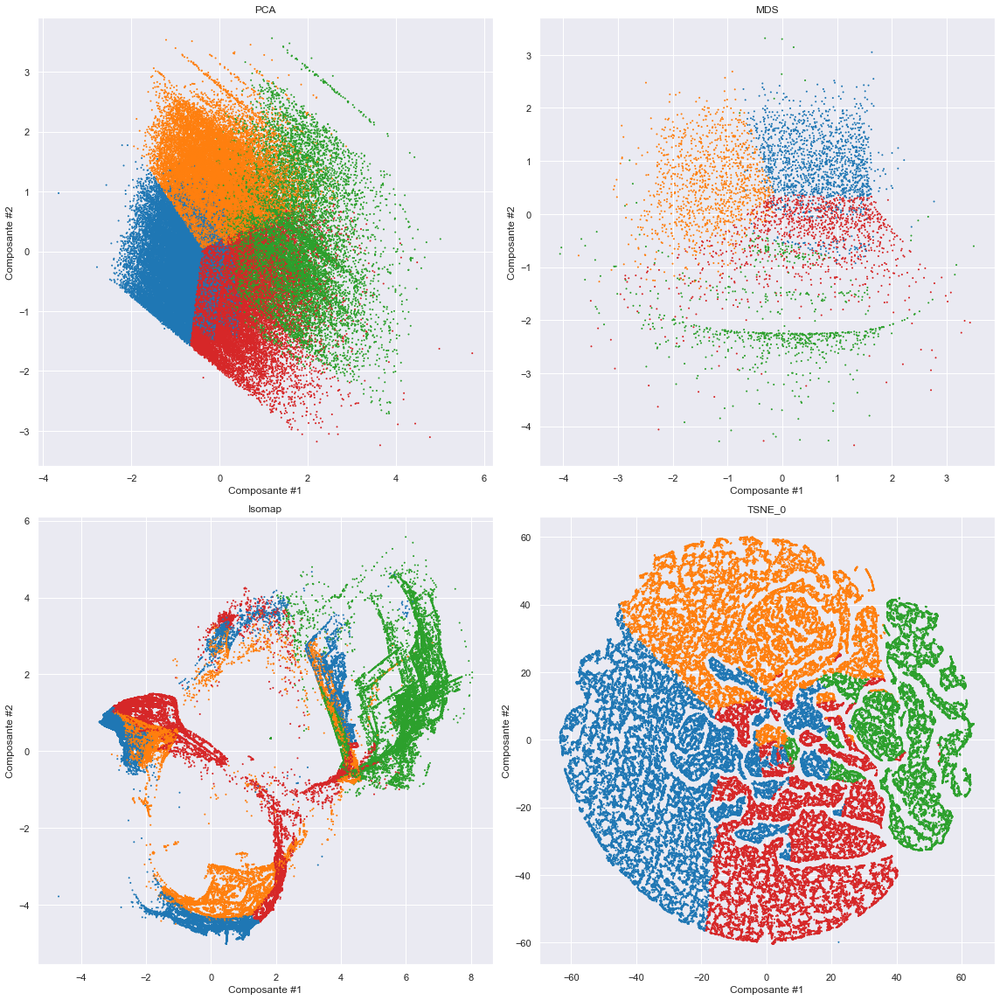

In [668]:
projection_version = "Version0"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

### 5.3.4 Distributions des Features par Groupe

In [102]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}
data = X_scaled.copy()
data['labels'] = X_labels

#### Tableau - résumé

In [672]:
pd.DataFrame(km.cluster_centers_, columns=X_scaled.columns).merge(
    pd.Series(km.labels_, name="fraction").value_counts(normalize=True).sort_index(),
    right_index=True, left_index=True)

,order_payment_total,recency,review_score,repeat_customer,fraction
0,-0.697226,0.637927,0.392993,0.033510,0.332071
1,-0.190163,-1.211966,0.367662,0.028677,0.259824
2,0.148376,-0.033087,-1.975800,0.026260,0.162466
3,1.047444,0.441436,0.386822,0.033933,0.245639


#### Tableau - détails

In [72]:
data.groupby('labels').describe().T

labels                                0             1             2  \
order_payment_total count  31908.000000  24966.000000  15611.000000   
                    mean      -0.698896     -0.187974      0.148614   
                    std        0.570838      0.783241      0.973317   
                    min       -5.884510     -2.653588     -2.519897   
                    25%       -1.118477     -0.726414     -0.505065   
                    50%       -0.644293     -0.179118      0.101527   
                    75%       -0.229910      0.324253      0.686578   
                    max        0.288640      3.187162      4.407333   
recency             count  31908.000000  24966.000000  15611.000000   
                    mean       0.636579     -1.212574     -0.033180   
                    std        0.557691      0.561322      0.898035   
                    min       -0.794544     -2.971724     -3.159611   
                    25%        0.175074     -1.617156     -0.492680   
                    50%        0.669678     -1.161434      0.088020   
                    75%        1.120939     -0.767217      0.554422   
                    max        1.611766     -0.141610      1.878712   
review_score        count  31908.000000  24966.000000  15611.000000   
                    mean       0.392931      0.367502     -1.975998   
                    std        0.477097      0.500747      0.520286   
                    min       -2.297030     -1.550486     -2.297030   
                    25%       -0.057397     -0.057397     -2.297030   
                    50%        0.689147      0.689147     -2.297030   
                    75%        0.689147      0.689147     -1.550486   
                    max        0.689147      0.689147     -0.803942   
repeat_customer     count  31908.000000  24966.000000  15611.000000   
                    mean       0.033565      0.028679      0.026264   
                    std        0.180110      0.166906      0.159923   
                    min        0.000000      0.000000      0.000000   
                    25%        0.000000      0.000000      0.000000   
                    50%        0.000000      0.000000      0.000000   
                    75%        0.000000      0.000000      0.000000   
                    max        1.000000      1.000000      1.000000   

labels                                3  
order_payment_total count  23603.000000  
                    mean       1.045347  
                    std        0.741670  
                    min        0.107629  
                    25%        0.497342  
                    50%        0.825650  
                    75%        1.391565  
                    max        6.011733  
recency             count  23603.000000  
                    mean       0.443975  
                    std        0.695024  
                    min       -2.222140  
                    25%       -0.077513  
                    50%        0.503350  
                    75%        1.017420  
                    max        1.872943  
review_score        count  23603.000000  
                    mean       0.387010  
                    std        0.485015  
                    min       -2.297030  
                    25%       -0.057397  
                    50%        0.689147  
                    75%        0.689147  
                    max        0.689147  
repeat_customer     count  23603.000000  
                    mean       0.033852  
                    std        0.180851  
                    min        0.000000  
                    25%        0.000000  
                    50%        0.000000  
                    75%        0.000000  
                    max        1.000000

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

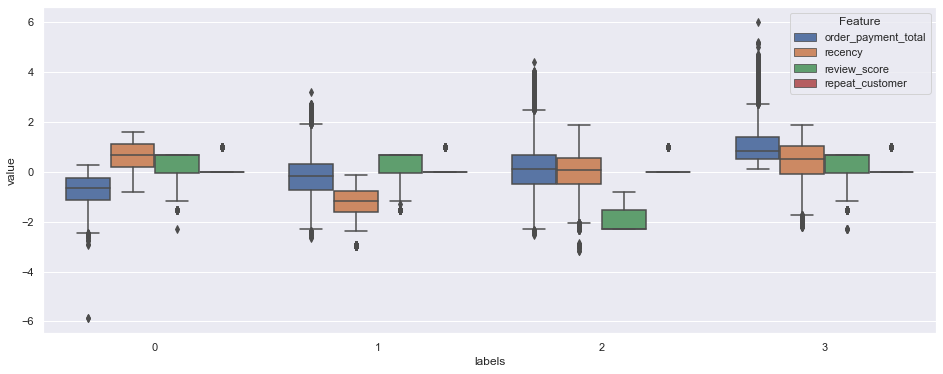

In [701]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

<AxesSubplot:xlabel='Feature', ylabel='value'>

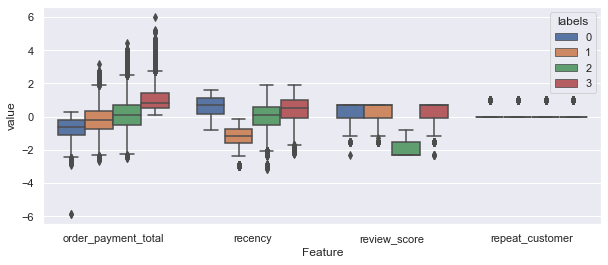

In [702]:
fig, ax = plt.subplots(figsize = (10,4))
sns.boxplot(x="Feature", y="value", hue="labels", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

#### Scatterplots

Text(0, 0.5, 'order_payment_total')

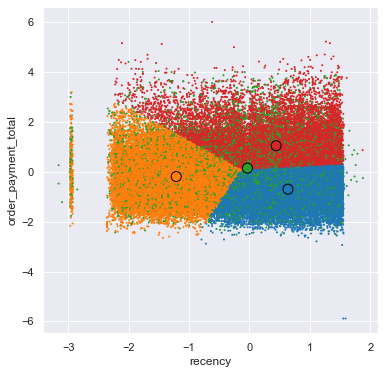

In [103]:
my_cmap = sns.color_palette('tab10')[:4]
fig, ax = plt.subplots(figsize = (6,6))
plt.scatter(X_scaled['recency'], X_scaled['order_payment_total'], c=X_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels))), s=1)
plt.scatter(km.cluster_centers_[:, 1], km.cluster_centers_[:, 0], s=100, c=my_cmap, edgecolors='black')
plt.xlabel('recency')
plt.ylabel('order_payment_total')

Text(0, 0.5, 'repeat_customer')

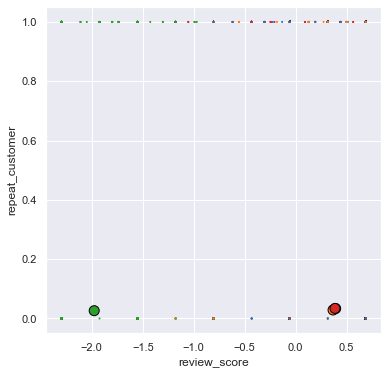

In [105]:
my_cmap = sns.color_palette('tab10')[:4]
fig, ax = plt.subplots(figsize = (6,6))
plt.scatter(X_scaled['review_score'], X_scaled['repeat_customer'], c=X_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels))), s=1)
plt.scatter(km.cluster_centers_[:, 2], km.cluster_centers_[:, 3], s=100, c=my_cmap, edgecolors='black')
plt.xlabel('review_score')
plt.ylabel('repeat_customer')

## 5.4 GaussianMixture - Vérsion 0

In [673]:
model_name = "GaussianMixture_0"

### 5.4.1 Evaluation du Modèle

In [675]:
model_dict = test_model(X_reduced, "GaussianMixture")
all_my_models[model_name] = model_dict

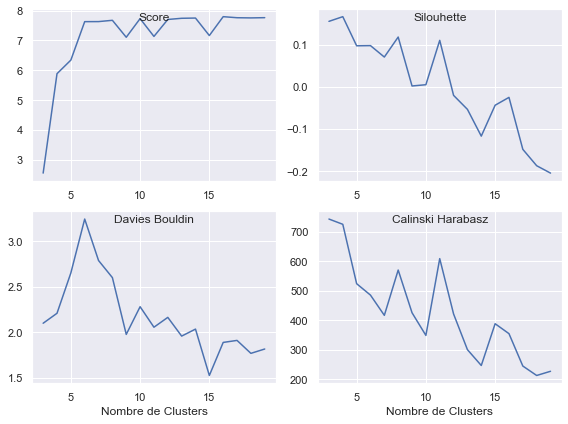

In [676]:
plot_model_evaluation(model_dict, figsize=(8,6))

### 5.4.2 Choisir un Modèle

In [677]:
n_clusters = 4
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 5.4.3 Visualisation des Clusters en 2-D

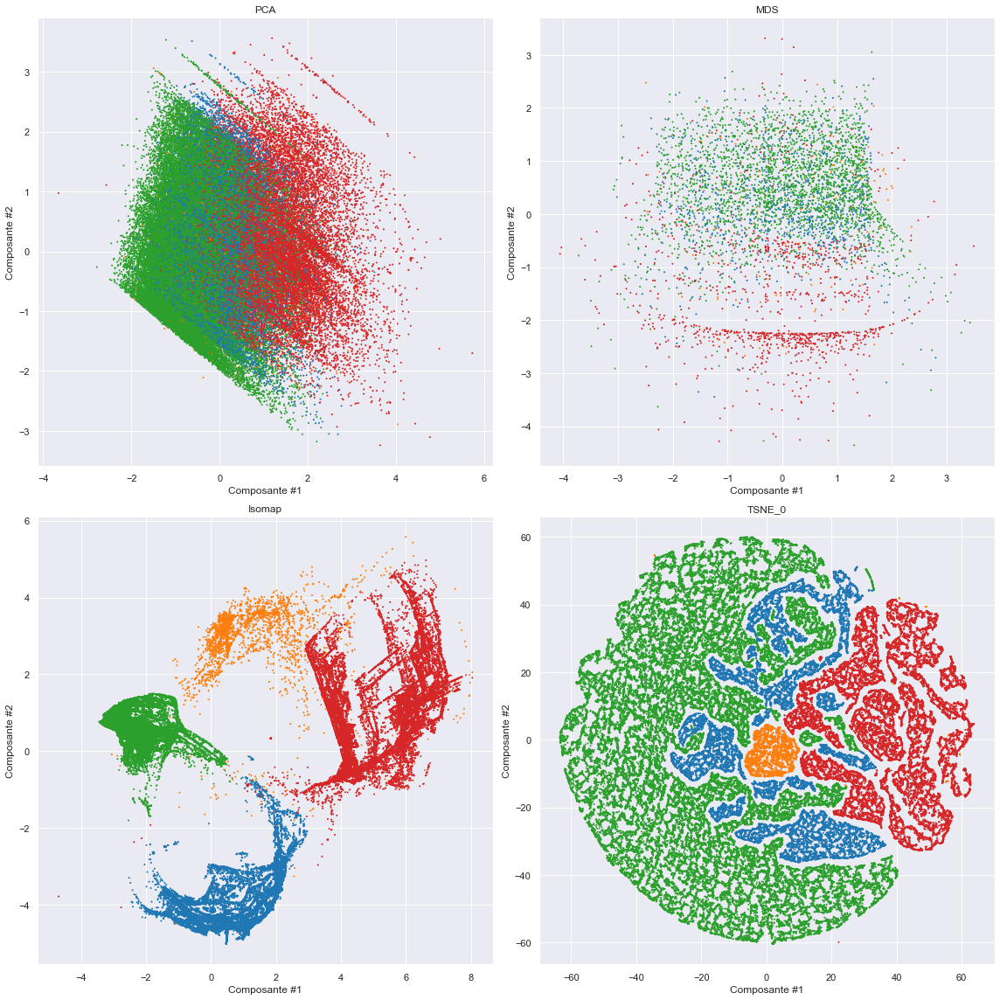

In [678]:
projection_version = "Version0"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [79]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 5.4.4 Distributions des Features par Groupe

In [679]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}
data = X_scaled.copy()
data['labels'] = X_labels

#### Tableau - resumé

In [81]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,order_payment_total,recency,review_score,repeat_customer,weights
0,-0.029977,-0.019311,-0.057397,0.0,0.186929
1,0.040291,0.126782,0.022003,1.0,0.031180
2,-0.028102,0.020980,0.689147,0.0,0.553700
3,0.087239,-0.052411,-1.628179,0.0,0.228192


#### Tableau - détails

In [82]:
data.groupby('labels').describe().T

labels                                0            1             2  \
order_payment_total count  1.796400e+04  2996.000000  5.320400e+04   
                    mean  -2.998651e-02     0.040291 -2.810191e-02   
                    std    9.844157e-01     0.849903  9.965222e-01   
                    min   -2.653588e+00    -2.373319 -2.936358e+00   
                    25%   -7.128105e-01    -0.535269 -7.294342e-01   
                    50%   -7.967820e-02    -0.001765 -7.531103e-02   
                    75%    5.570630e-01     0.556712  5.647607e-01   
                    max    4.695665e+00     4.408529  5.163559e+00   
recency             count  1.796400e+04  2996.000000  5.320400e+04   
                    mean  -1.931737e-02     0.126782  2.097949e-02   
                    std    9.975993e-01     0.947539  1.014460e+00   
                    min   -2.971724e+00    -2.947949 -2.970209e+00   
                    25%   -7.313301e-01    -0.512982 -7.287225e-01   
                    50%    9.696533e-02     0.258862  1.365878e-01   
                    75%    7.887259e-01     0.886689  8.570198e-01   
                    max    1.553150e+00     1.872943  1.571963e+00   
review_score        count  1.796400e+04  2996.000000  5.320400e+04   
                    mean  -5.739745e-02     0.022003  6.891468e-01   
                    std    2.081726e-17     0.851067  2.220467e-16   
                    min   -5.739745e-02    -2.297030  6.891468e-01   
                    25%   -5.739745e-02    -0.430670  6.891468e-01   
                    50%   -5.739745e-02     0.315875  6.891468e-01   
                    75%   -5.739745e-02     0.689147  6.891468e-01   
                    max   -5.739745e-02     0.689147  6.891468e-01   
repeat_customer     count  1.796400e+04  2996.000000  5.320400e+04   
                    mean   0.000000e+00     1.000000  0.000000e+00   
                    std    0.000000e+00     0.000000  0.000000e+00   
                    min    0.000000e+00     1.000000  0.000000e+00   
                    25%    0.000000e+00     1.000000  0.000000e+00   
                    50%    0.000000e+00     1.000000  0.000000e+00   
                    75%    0.000000e+00     1.000000  0.000000e+00   
                    max    0.000000e+00     1.000000  0.000000e+00   

labels                                3  
order_payment_total count  21924.000000  
                    mean       0.087261  
                    std        1.034319  
                    min       -5.884510  
                    25%       -0.646413  
                    50%        0.031048  
                    75%        0.694327  
                    max        6.011733  
recency             count  21924.000000  
                    mean      -0.052409  
                    std        0.970084  
                    min       -3.159611  
                    25%       -0.665180  
                    50%        0.100045  
                    75%        0.650810  
                    max        1.878712  
review_score        count  21924.000000  
                    mean      -1.628362  
                    std        0.690656  
                    min       -2.297030  
                    25%       -2.297030  
                    50%       -1.550486  
                    75%       -0.803942  
                    max        0.315875  
repeat_customer     count  21924.000000  
                    mean       0.000000  
                    std        0.000000  
                    min        0.000000  
                    25%        0.000000  
                    50%        0.000000  
                    75%        0.000000  
                    max        0.000000

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

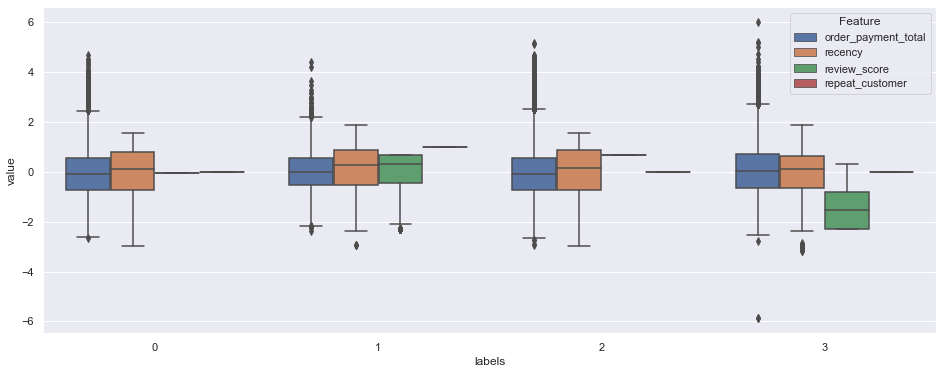

In [680]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

<AxesSubplot:xlabel='Feature', ylabel='value'>

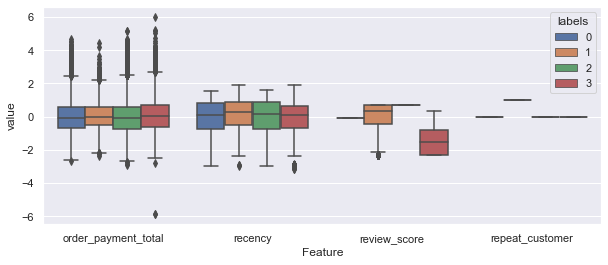

In [681]:
fig, ax = plt.subplots(figsize = (10,4))
sns.boxplot(x="Feature", y="value", hue="labels", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

### 5.4.5 Choisir un Modèle -2

In [84]:
n_clusters = 8
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 5.4.6 Visualisation des Clusters en 2-D -2

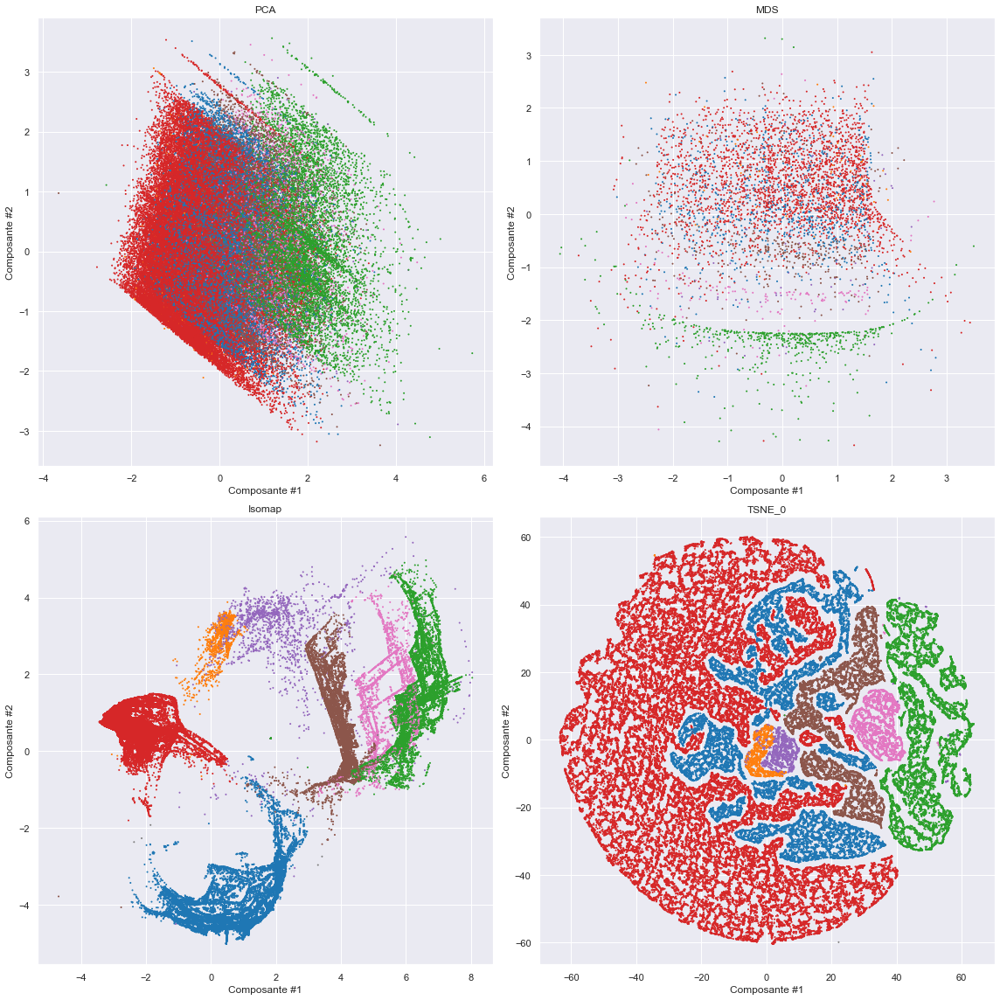

In [85]:
projection_version = "Version0"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [86]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 5.4.7 Distributions des Features par Groupe -2

In [87]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - résumé

In [88]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,order_payment_total,recency,review_score,repeat_customer,weights
0,-0.029987,-0.019317,-0.057397,0.0,0.186953
1,0.005531,0.117870,0.689147,1.0,0.014303
2,0.181741,-0.040932,-2.297030,0.0,0.110690
3,-0.028102,0.020979,0.689147,0.0,0.553701
4,0.069751,0.134334,-0.543425,1.0,0.016876
5,-0.024402,-0.065543,-0.803942,0.0,0.086691
6,0.063293,-0.056090,-1.550486,0.0,0.030618
7,-0.176526,-0.166692,-0.663950,0.0,0.000167


#### Tableau - détails

In [89]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                0             1             2  \
order_payment_total count  1.796400e+04  1.375000e+03  1.063600e+04   
                    mean  -2.998651e-02  5.508900e-03  1.817408e-01   
                    std    9.844157e-01  8.364339e-01  1.063533e+00   
                    min   -2.653588e+00 -2.373319e+00 -5.884510e+00   
                    25%   -7.128105e-01 -5.515666e-01 -5.661769e-01   
                    50%   -7.967820e-02 -6.085340e-02  1.111319e-01   
                    75%    5.570630e-01  5.221448e-01  7.928207e-01   
                    max    4.695665e+00  4.408529e+00  6.011733e+00   
recency             count  1.796400e+04  1.375000e+03  1.063600e+04   
                    mean  -1.931737e-02  1.179238e-01 -4.093183e-02   
                    std    9.975993e-01  9.613989e-01  9.556414e-01   
                    min   -2.971724e+00 -2.926392e+00 -3.159611e+00   
                    25%   -7.313301e-01 -5.665274e-01 -5.550357e-01   
                    50%    9.696533e-02  2.479029e-01  1.323568e-01   
                    75%    7.887259e-01  9.146402e-01  5.986601e-01   
                    max    1.553150e+00  1.872943e+00  1.878712e+00   
review_score        count  1.796400e+04  1.375000e+03  1.063600e+04   
                    mean  -5.739745e-02  6.891468e-01 -2.297030e+00   
                    std    2.081726e-17  1.110627e-16  8.882202e-16   
                    min   -5.739745e-02  6.891468e-01 -2.297030e+00   
                    25%   -5.739745e-02  6.891468e-01 -2.297030e+00   
                    50%   -5.739745e-02  6.891468e-01 -2.297030e+00   
                    75%   -5.739745e-02  6.891468e-01 -2.297030e+00   
                    max   -5.739745e-02  6.891468e-01 -2.297030e+00   
repeat_customer     count  1.796400e+04  1.375000e+03  1.063600e+04   
                    mean   0.000000e+00  1.000000e+00  0.000000e+00   
                    std    0.000000e+00  0.000000e+00  0.000000e+00   
                    min    0.000000e+00  1.000000e+00  0.000000e+00   
                    25%    0.000000e+00  1.000000e+00  0.000000e+00   
                    50%    0.000000e+00  1.000000e+00  0.000000e+00   
                    75%    0.000000e+00  1.000000e+00  0.000000e+00   
                    max    0.000000e+00  1.000000e+00  0.000000e+00   

labels                                3            4             5  \
order_payment_total count  5.320400e+04  1621.000000  8.330000e+03   
                    mean  -2.810191e-02     0.069795 -2.440373e-02   
                    std    9.965222e-01     0.860319  9.881557e-01   
                    min   -2.936358e+00    -2.240456 -5.884510e+00   
                    25%   -7.294342e-01    -0.521430 -7.297871e-01   
                    50%   -7.531103e-02     0.031377 -6.531832e-02   
                    75%    5.647607e-01     0.592272  5.731578e-01   
                    max    5.163559e+00     4.192449  5.162278e+00   
recency             count  5.320400e+04  1621.000000  8.330000e+03   
                    mean   2.097949e-02     0.134295 -6.554275e-02   
                    std    1.014460e+00     0.935853  9.874385e-01   
                    min   -2.970209e+00    -2.947949 -2.970562e+00   
                    25%   -7.287225e-01    -0.475151 -7.438980e-01   
                    50%    1.365878e-01     0.268646  6.966796e-02   
                    75%    8.570198e-01     0.856937  6.990590e-01   
                    max    1.571963e+00     1.787829  1.609604e+00   
review_score        count  5.320400e+04  1621.000000  8.330000e+03   
                    mean   6.891468e-01    -0.543896 -8.039417e-01   
                    std    2.220467e-16     0.800550  1.110290e-16   
                    min    6.891468e-01    -2.297030 -8.039417e-01   
                    25%    6.891468e-01    -0.803942 -8.039417e-01   
                    50%    6.891468e-01    -0.430670 -8.039417e-01   
                    75%    6.891468e-01    -0.

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

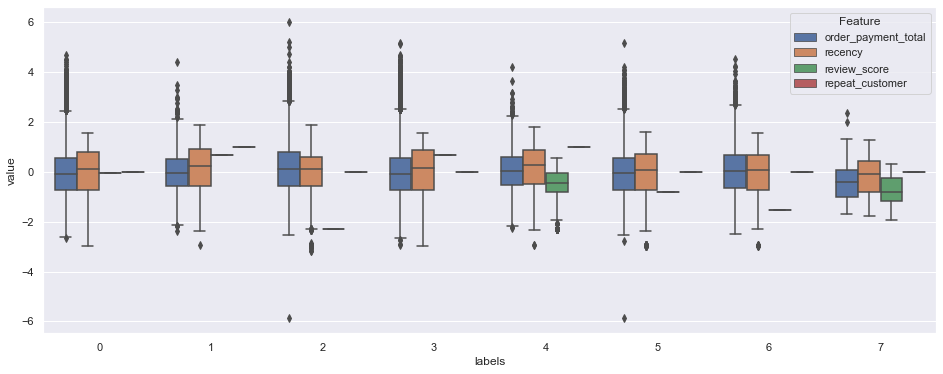

In [90]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

## 5.5 BIRCH - Vérsion 0

In [682]:
model_name = "BIRCH_0"

### 5.5.1 Evaluation du Modèle

In [683]:
model_dict = test_model(X_reduced, "Birch")
all_my_models[model_name] = model_dict

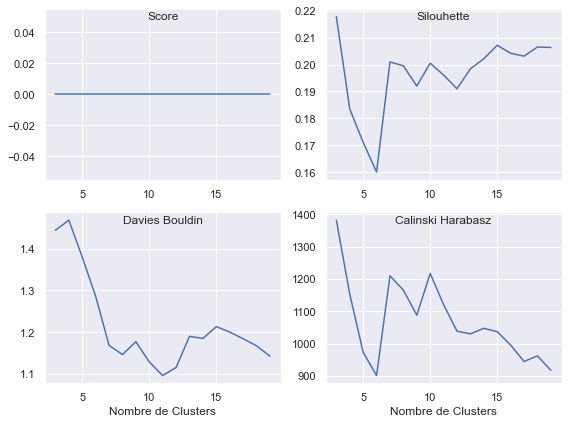

In [685]:
plot_model_evaluation(model_dict, figsize=(8,6))

### 5.5.2 Choisir un Modèle

In [94]:
n_clusters = 7
bm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = bm.fit_predict(X_scaled)
X_labels_reduced = bm.predict(X_reduced.astype(float))

### 5.5.3 Visualisation des Clusters en 2-D

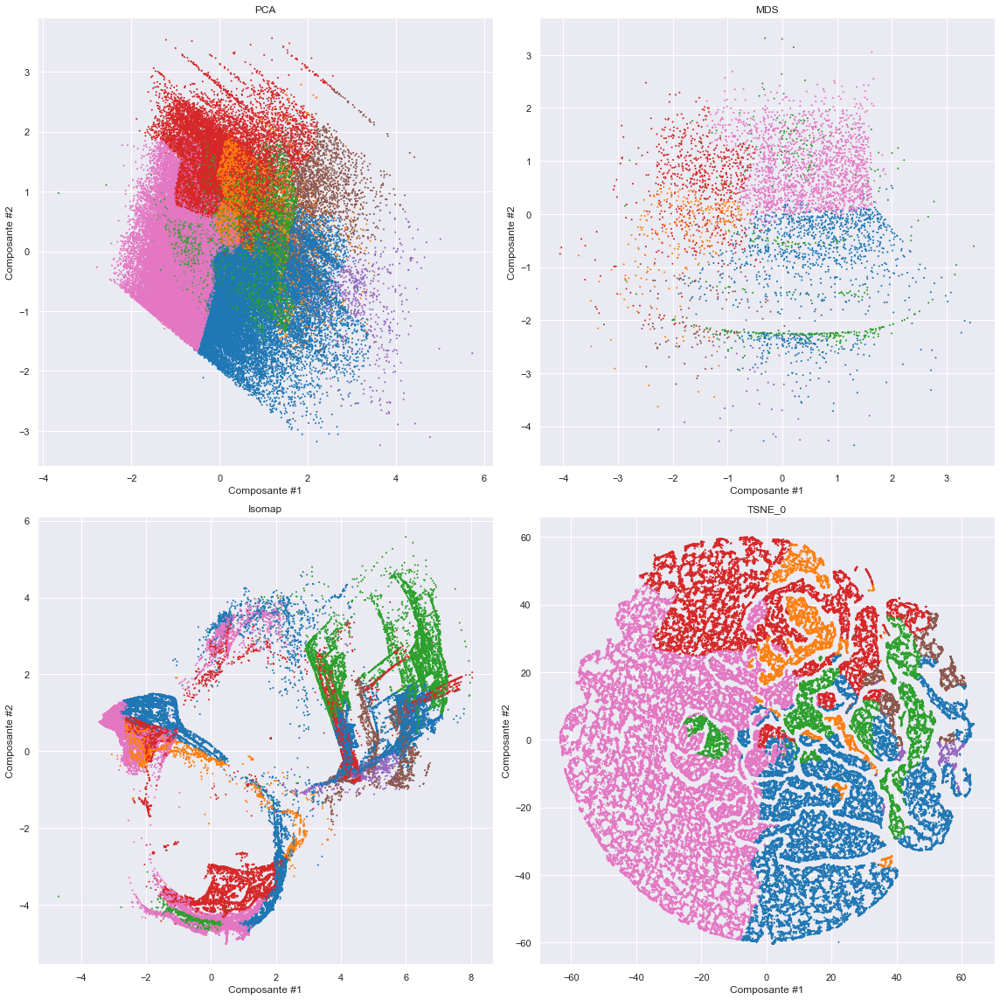

In [95]:
projection_version = "Version0"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [96]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 5.5.4 Distributions des Features par Groupe

In [97]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - résumé

#### Tableau - détails

In [99]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                0            1            2  \
order_payment_total count  24601.000000  5768.000000  8954.000000   
                    mean       0.925908     1.143896    -0.844400   
                    std        0.712493     0.831204     0.509346   
                    min       -1.102068     0.056348    -5.884510   
                    25%        0.448991     0.546852    -1.190361   
                    50%        0.823092     0.867111    -0.812159   
                    75%        1.308895     1.479390    -0.487416   
                    max        4.673832     5.163559     0.435257   
recency             count  24601.000000  5768.000000  8954.000000   
                    mean       0.501572    -1.349789     0.319626   
                    std        0.607100     0.535105     0.640625   
                    min       -2.132357    -2.966267    -1.484151   
                    25%        0.044654    -1.759060    -0.163881   
                    50%        0.503217    -1.366971     0.334118   
                    75%        1.005745    -0.923810     0.744684   
                    max        1.872943     0.326246     1.878712   
review_score        count  24601.000000  5768.000000  8954.000000   
                    mean      -0.334334     0.628121    -1.489469   
                    std        1.083326     0.227321     0.843669   
                    min       -2.297030    -1.550486    -2.297030   
                    25%       -0.803942     0.689147    -2.297030   
                    50%       -0.057397     0.689147    -1.550486   
                    75%        0.689147     0.689147    -0.803942   
                    max        0.689147     0.689147    -0.057397   
repeat_customer     count  24601.000000  5768.000000  8954.000000   
                    mean       0.046949     0.003121     0.011168   
                    std        0.211535     0.055781     0.105094   
                    min        0.000000     0.000000     0.000000   
                    25%        0.000000     0.000000     0.000000   
                    50%        0.000000     0.000000     0.000000   
                    75%        0.000000     0.000000     0.000000   
                    max        1.000000     1.000000     1.000000   

labels                                3           4            5             6  
order_payment_total count  15550.000000  623.000000  2196.000000  38396.000000  
                    mean      -0.385736    2.655210     0.848150     -0.503543  
                    std        0.632186    0.661806     0.688441      0.659949  
                    min       -2.653588    1.615346    -0.490326     -2.936358  
                    25%       -0.799299    2.148786     0.293494     -1.014719  
                    50%       -0.383549    2.512583     0.784747     -0.453333  
                    75%        0.052068    3.123463     1.330449      0.032857  
                    max        1.229602    6.011733     3.166997      0.765885  
recency             count  15550.000000  623.000000  2196.000000  38396.000000  
                    mean      -1.388917   -0.121746    -1.287654      0.444986  
                    std        0.496509    0.647441     0.583193      0.684544  
                    min       -3.159611   -2.059948    -2.966621     -1.373505  
                    25%       -1.758192   -0.424513    -1.692309     -0.147725  
                    50%       -1.369328   -0.168328    -1.264066      0.495549  
                    75%       -0.997046    0.173343    -0.893971      1.038797  
                    max       -0.122230    1.491930     0.182717      1.610699  
review_score        count  15550.000000  623.000000  2196.000000  38396.000000  
                    mean       0.126723   -1.968694    -1.834803      0.552761  
                    std        0.791739    0.535046     0.561812      0.290950  
                    min       -2.297030   -2.297030    -2.297030     -1.177214  
                    2

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

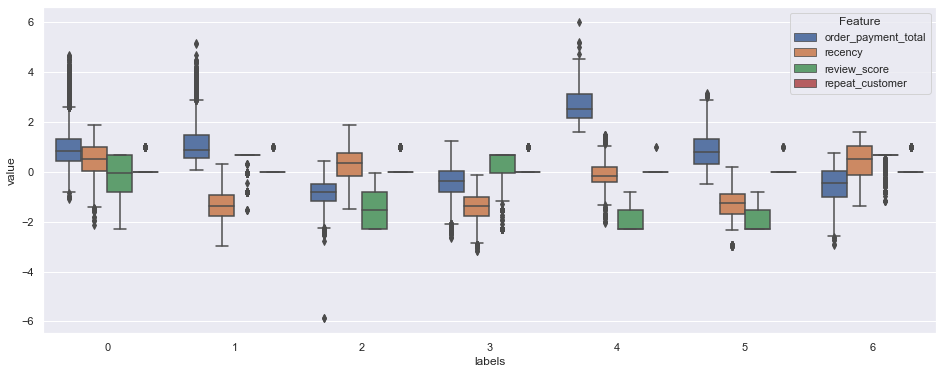

In [100]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

# 6. Modèles - Vérsion 1

## 6.1 Sélection des Features

In [29]:
passthrough_features = []
standardscale_features = ['recency', 'review_score']
log1pscale_features = ['order_payment_total']
logscale_features = []
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [30]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)

X_reduced = X_scaled.sample(frac=0.05, random_state=seed).astype(np.float32)
all_components = len(X_scaled.columns)

## 6.2  Créations des Projections

In [619]:
projection_version = "Version1"
do_projection = True & global_do_projections

In [104]:
if do_projection :
    all_my_projections[projection_version] = {}

#### PCA

In [105]:
if do_projection :
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)
    all_my_projections[projection_version]["PCA"] = {"X_proj" : X_pca, "model": pca}

#### MDS

In [106]:
if do_projection :
    mds = MDS(n_components=2)
    X_reduced_mds = mds.fit_transform(X_reduced)
    all_my_projections[projection_version]["MDS"] = {"X_proj" : X_reduced_mds, "model": mds}

#### Isomap

In [107]:
if do_projection :
    iso = Isomap(n_components=2)
    X_reduced_iso = iso.fit_transform(X_reduced)
    X_iso = iso.transform(X_scaled)
    all_my_projections[projection_version]["Isomap"] = {"X_proj" : X_iso, "model": iso}

#### t_SNE

In [108]:
if do_projection :
    tsne = TSNE(n_components=2, init='pca')
    X_tsne0 = tsne.fit_transform(X_scaled)
    all_my_projections[projection_version]["TSNE_0"] = {"X_proj" : X_tsne0, "model": tsne}

## -- BREAK Store/Reload Data --

In [109]:
dill.dump_session('notebook_env.db')

In [3]:
import dill
dill.load_session('notebook_env.db')

## 6.3 K-Means - Vérsion 1

In [94]:
model_name = "KMeans_1"

### 6.3.1 Evaluation du Modèle

In [621]:
model_dict = test_model(X_reduced)
all_my_models[model_name] = model_dict

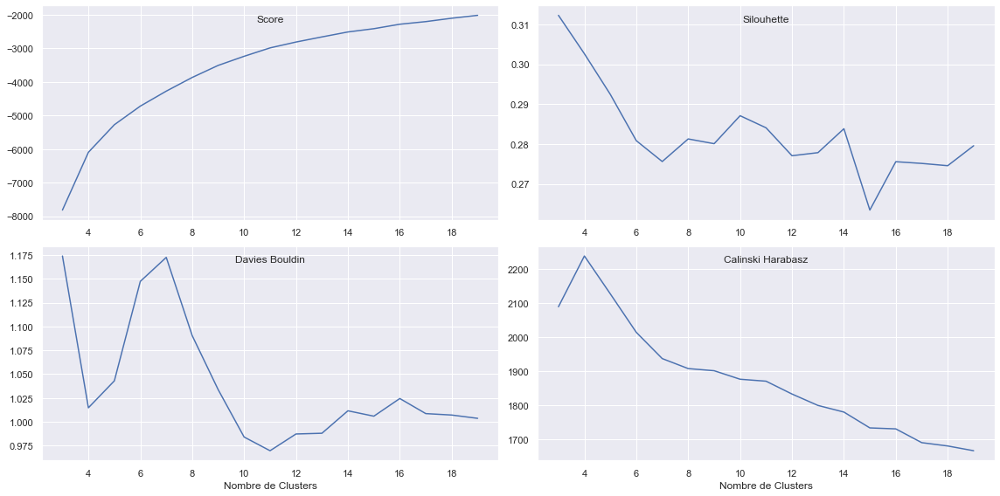

In [706]:
model_dict = all_my_models["KMeans_1"]
plot_model_evaluation(model_dict)

### 6.3.2 Choisir un Modèle

In [95]:
n_clusters = 4
km = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = km.fit_predict(X_scaled)
X_labels_reduced = km.predict(X_reduced.astype(float))

### 6.3.3 Visualisation des Clusters en 2-D

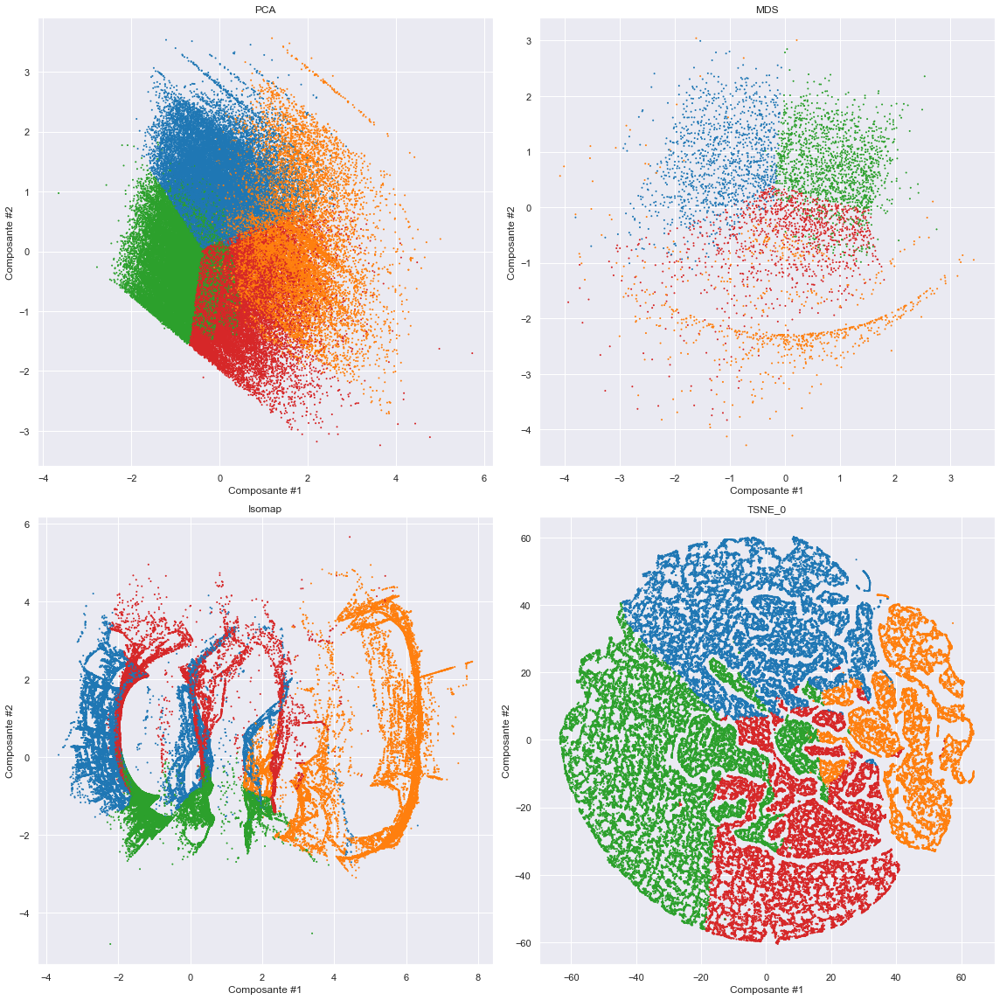

In [624]:
projection_version = 'Version1'
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

### 6.3.4 Distributions des Features par Groupe

In [7]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}
data = X_scaled.copy()
data['labels'] = X_labels

#### Tableau - résumé

In [10]:
pd.DataFrame(km.cluster_centers_, columns=X_scaled.columns).merge(
    pd.Series(km.labels_, name="fraction").value_counts(normalize=True).sort_index(),
    right_index=True, left_index=True)

,order_payment_total,recency,review_score,fraction
0,-0.175163,-1.210569,0.369466,0.260907
1,0.147798,-0.034617,-1.974788,0.162611
2,-0.704222,0.631319,0.392874,0.331040
3,1.042115,0.459609,0.386216,0.245442


In [35]:
display(pd.DataFrame(preprocessor_X.named_transformers_['standardscale'].inverse_transform(km.cluster_centers_.T[1:4].T), 
                     columns=X_scaled.columns.values[1:3], index=[i for i in range(4)]))

,recency,review_score
0,-473.874237,4.571786
1,-293.491398,1.431645
2,-191.341410,4.603141
3,-217.680550,4.594222


In [42]:
preprocessor_X.named_transformers_['log1pscale'].inverse_transform(km.cluster_centers_.T[0])

array([ 95.56021127, 124.04683619,  62.22317476, 254.84271256])

In [45]:
display(pd.Series(preprocessor_X.named_transformers_['log1pscale'].inverse_transform(km.cluster_centers_.T[0]), 
                  name=X_scaled.columns.values[0], index=[i for i in range(4)]))

0     95.560211
1    124.046836
2     62.223175
3    254.842713
Name: order_payment_total, dtype: float64

#### Tableau - détails

In [627]:
data.groupby('labels').describe().T

labels                                0             1             2  \
order_payment_total count  25070.000000  15625.000000  31809.000000   
                    mean      -0.176852      0.148411     -0.704818   
                    std        0.787155      0.973395      0.568637   
                    min       -2.653588     -2.519897     -5.884510   
                    25%       -0.714204     -0.505065     -1.121233   
                    50%       -0.166656      0.101216     -0.648821   
                    75%        0.337690      0.686870     -0.237231   
                    max        3.187162      4.407333      0.262394   
recency             count  25070.000000  15625.000000  31809.000000   
                    mean      -1.211283     -0.034113      0.631940   
                    std        0.561485      0.898192      0.559593   
                    min       -2.971724     -3.159611     -0.879425   
                    25%       -1.616050     -0.493681      0.165404   
                    50%       -1.160408      0.087129      0.659702   
                    75%       -0.766559      0.553666      1.115593   
                    max       -0.141610      1.878712      1.611766   
review_score        count  25070.000000  15625.000000  31809.000000   
                    mean       0.368797     -1.975139      0.392729   
                    std        0.499389      0.520941      0.477120   
                    min       -1.550486     -2.297030     -2.297030   
                    25%       -0.057397     -2.297030     -0.057397   
                    50%        0.689147     -2.297030      0.689147   
                    75%        0.689147     -1.550486      0.689147   
                    max        0.689147     -0.803942      0.689147   

labels                                3  
order_payment_total count  23584.000000  
                    mean       1.040294  
                    std        0.742839  
                    min        0.107629  
                    25%        0.492499  
                    50%        0.822190  
                    75%        1.386748  
                    max        6.011733  
recency             count  23584.000000  
                    mean       0.457875  
                    std        0.688256  
                    min       -2.222140  
                    25%       -0.042585  
                    50%        0.516141  
                    75%        1.025986  
                    max        1.872943  
review_score        count  23584.000000  
                    mean       0.386851  
                    std        0.485292  
                    min       -2.297030  
                    25%       -0.057397  
                    50%        0.689147  
                    75%        0.689147  
                    max        0.689147

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

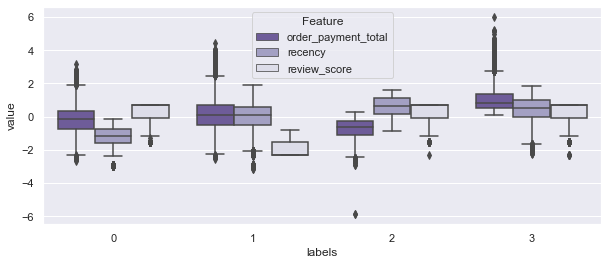

In [720]:
fig, ax = plt.subplots(figsize = (10,4))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']),
           palette = 'Purples_r')

<AxesSubplot:xlabel='Feature', ylabel='value'>

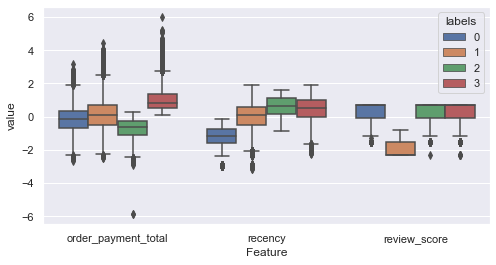

In [716]:
fig, ax = plt.subplots(figsize = (8,4))
sns.boxplot(x="Feature", y="value", hue="labels", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

#### Scatterplots

Text(0, 0.5, 'order_payment_total')

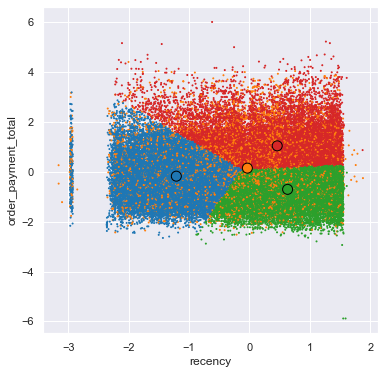

In [97]:
my_cmap = sns.color_palette('tab10')[:4]
fig, ax = plt.subplots(figsize = (6,6))
plt.scatter(X_scaled['recency'], X_scaled['order_payment_total'], c=X_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels))), s=1)
plt.scatter(km.cluster_centers_[:, 1], km.cluster_centers_[:, 0], s=100, c=my_cmap, edgecolors='black')
plt.xlabel('recency')
plt.ylabel('order_payment_total')

### 6.3.5 Choisir un Modèle -2

In [630]:
n_clusters = 5
km = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = km.fit_predict(X_scaled)
X_labels_reduced = km.predict(X_reduced.astype(float))

In [631]:
data = X_scaled.copy()
data['labels'] = X_labels

### 6.3.6 Visualisation des Clusters en 2-D -2

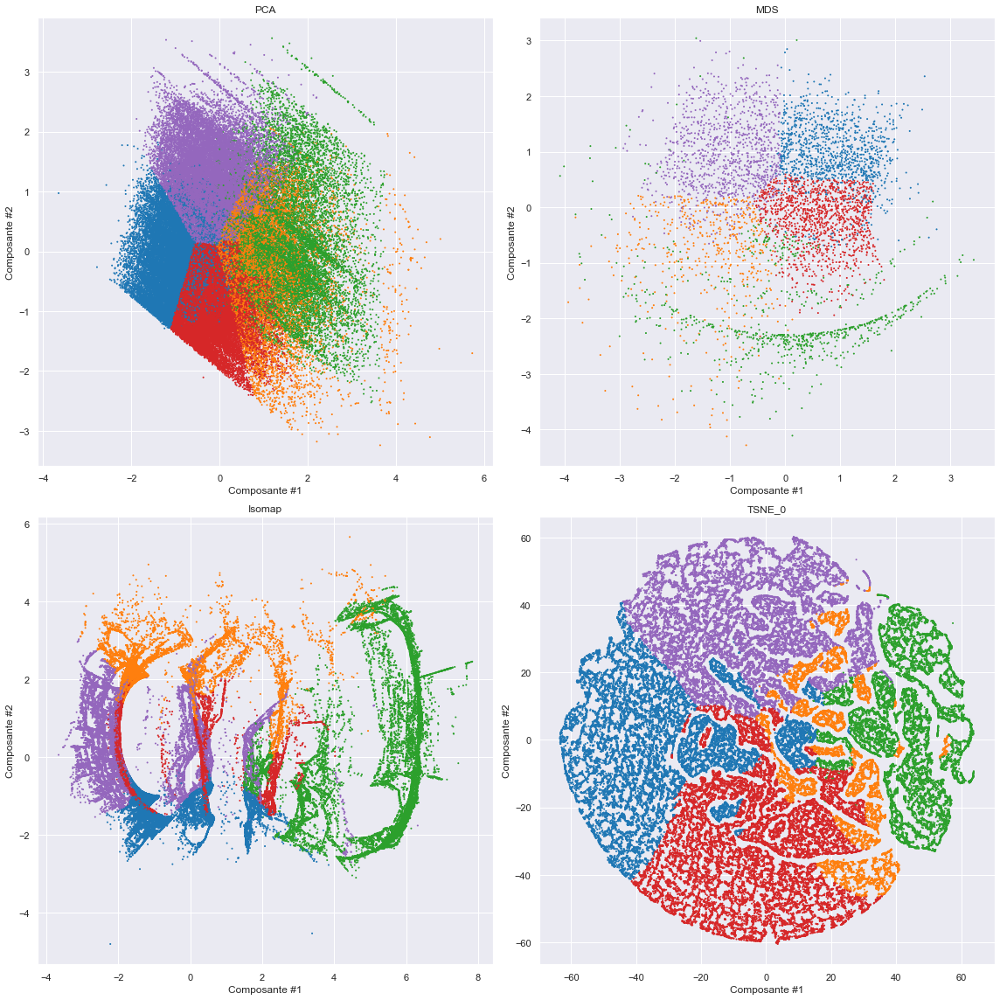

In [191]:
projection_version
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

### 6.3.7 Distributions des Features par Groupe -2

In [192]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - résumé

In [193]:
pd.DataFrame(km.cluster_centers_, columns=X_scaled.columns).merge(
    pd.Series(km.labels_, name="fraction").value_counts(normalize=True).sort_index(),
    right_index=True, left_index=True)

,order_payment_total,recency,review_score,fraction
0,-0.957454,0.560229,0.371115,0.238469
1,1.626471,-0.468529,0.273798,0.109306
2,0.104007,-0.028073,-2.000628,0.156617
3,0.442151,0.764435,0.414489,0.261833
4,-0.351019,-1.190371,0.369634,0.233775


#### Tableau - détails

In [194]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                0             1             2  \
order_payment_total count  22914.000000  10503.000000  15049.000000   
                    mean      -0.957986      1.631753      0.103725   
                    std        0.461883      0.776583      0.919864   
                    min       -5.884510      0.469468     -2.519897   
                    25%       -1.295877      1.024200     -0.522198   
                    50%       -0.890388      1.449839      0.072368   
                    75%       -0.589977      2.122650      0.662164   
                    max       -0.146770      6.011733      3.367489   
recency             count  22914.000000  10503.000000  15049.000000   
                    mean       0.559756     -0.463667     -0.028237   
                    std        0.563784      0.818236      0.897901   
                    min       -0.879425     -2.966073     -3.159611   
                    25%        0.097061     -1.001272     -0.475640   
                    50%        0.543935     -0.428571      0.091164   
                    75%        1.042471      0.059962      0.550320   
                    max        1.610699      1.609604      1.878712   
review_score        count  22914.000000  10503.000000  15049.000000   
                    mean       0.371171      0.272398     -2.000429   
                    std        0.497288      0.636206      0.499044   
                    min       -2.297030     -2.297030     -2.297030   
                    25%       -0.057397     -0.057397     -2.297030   
                    50%        0.689147      0.689147     -2.297030   
                    75%        0.689147      0.689147     -1.550486   
                    max        0.689147      0.689147     -0.803942   

labels                                3             4  
order_payment_total count  25159.000000  22463.000000  
                    mean       0.440698     -0.348817  
                    std        0.486828      0.646736  
                    min       -0.386074     -2.653588  
                    25%        0.069394     -0.788683  
                    50%        0.372764     -0.309293  
                    75%        0.719881      0.144228  
                    max        2.455626      1.395398  
recency             count  25159.000000  22463.000000  
                    mean       0.763640     -1.190574  
                    std        0.503882      0.569797  
                    min       -0.391344     -2.971724  
                    25%        0.377264     -1.601650  
                    50%        0.804425     -1.138545  
                    75%        1.196239     -0.730361  
                    max        1.872943     -0.135043  
review_score        count  25159.000000  22463.000000  
                    mean       0.414654      0.369771  
                    std        0.456034      0.500918  
                    min       -1.177214     -1.550486  
                    25%       -0.057397     -0.057397  
                    50%        0.689147      0.689147  
                    75%        0.689147      0.689147  
                    max        0.689147      0.689147

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

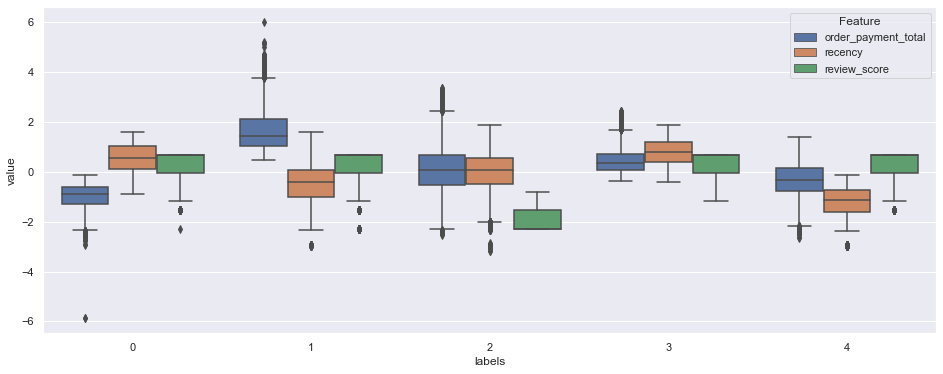

In [195]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

<AxesSubplot:xlabel='Feature', ylabel='value'>

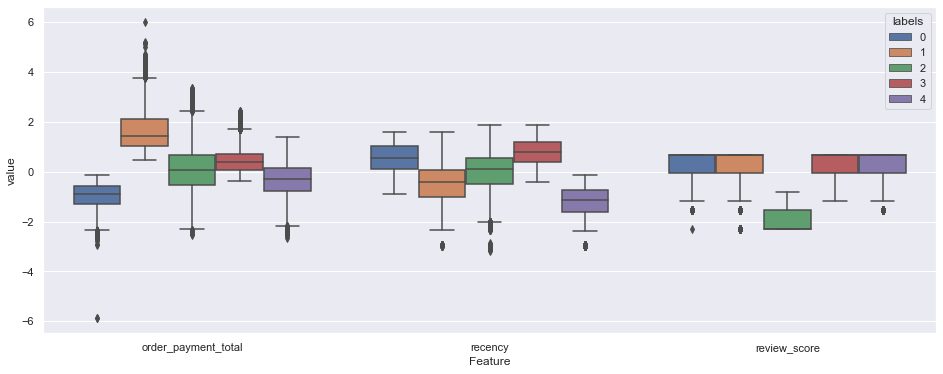

In [632]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="Feature", y="value", hue="labels", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

### 6.3.8 Choisir un Modèle -3

In [196]:
n_clusters = 10
km = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = km.fit_predict(X_scaled)
X_labels_reduced = km.predict(X_reduced.astype(float))

### 6.3.9 Visualisation des Clusters en 2-D -3

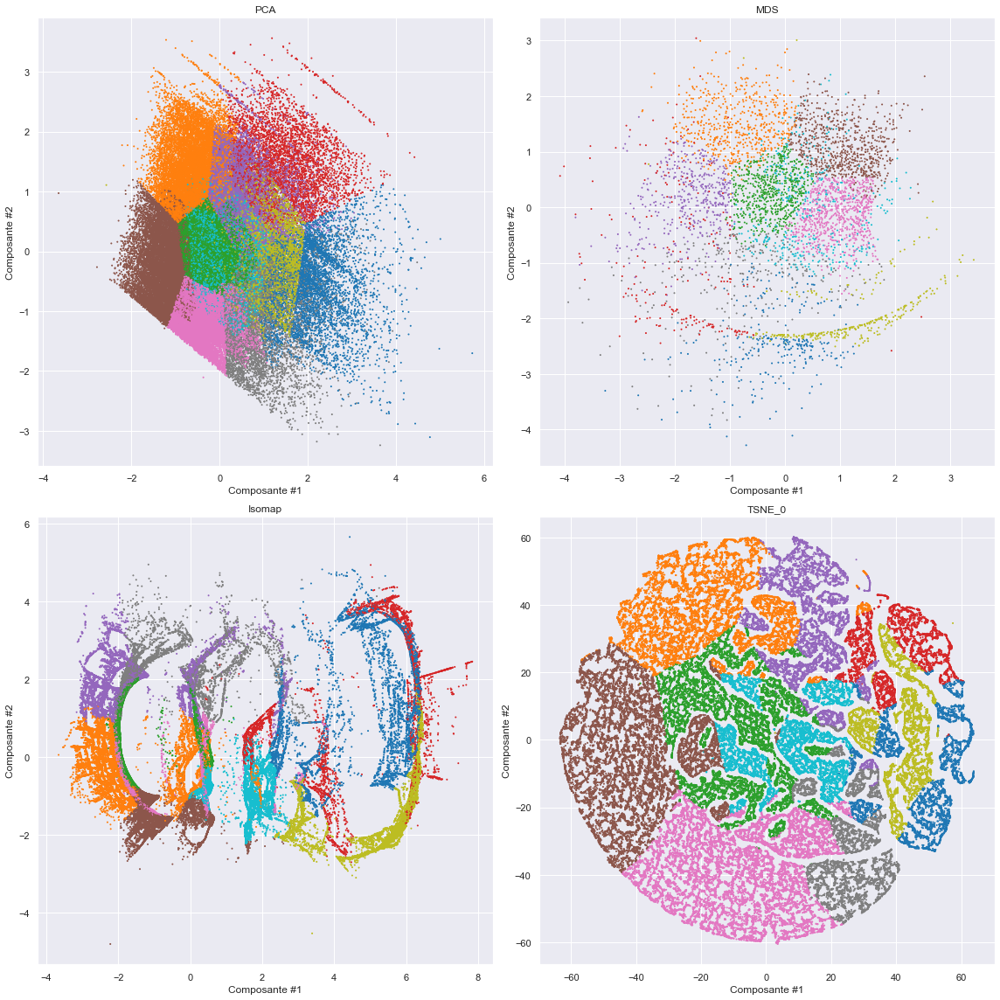

In [197]:
projection_version = 'Version1'
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

### 6.3.10 Distributions des Features par Groupe -3

In [198]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - résumé

In [199]:
pd.DataFrame(km.cluster_centers_, columns=X_scaled.columns).merge(
    pd.Series(km.labels_, name="fraction").value_counts(normalize=True).sort_index(),
    right_index=True, left_index=True)

,order_payment_total,recency,review_score,fraction
0,1.213875,0.258268,-1.919661,0.058301
1,-0.881183,-1.186717,0.469738,0.124001
2,0.203569,-0.175222,0.550857,0.144680
3,-0.128471,-1.446078,-1.677336,0.046988
4,0.744005,-1.459412,0.430900,0.090552
5,-1.069091,0.718011,0.551624,0.156846
6,0.353919,1.036403,0.498670,0.163527
7,1.973294,0.321152,0.419410,0.064066
8,-0.521847,0.425932,-2.143156,0.063910
9,-0.409777,0.317329,-0.507506,0.087128


#### Tableau - détails

In [200]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                               0             1             2  \
order_payment_total count  5602.000000  11915.000000  13902.000000   
                    mean      1.213774     -0.881050      0.203197   
                    std       0.709645      0.471897      0.432928   
                    min       0.233627     -2.880980     -0.767511   
                    25%       0.699171     -1.221434     -0.119716   
                    50%       1.033158     -0.820589      0.193248   
                    75%       1.527617     -0.501868      0.521129   
                    max       6.011733     -0.032402      1.255348   
recency             count  5602.000000  11915.000000  13902.000000   
                    mean      0.257742     -1.186608     -0.176115   
                    std       0.657984      0.533972      0.337790   
                    min      -2.223947     -2.971724     -1.021170   
                    25%      -0.219481     -1.563065     -0.415575   
                    50%       0.302750     -1.128732     -0.187760   
                    75%       0.718468     -0.775426      0.093824   
                    max       1.787829     -0.226771      0.497426   
review_score        count  5602.000000  11915.000000  13902.000000   
                    mean     -1.920393      0.468778      0.550734   
                    std       0.566193      0.380589      0.289218   
                    min      -2.297030     -0.803942     -0.617306   
                    25%      -2.297030     -0.057397      0.689147   
                    50%      -2.297030      0.689147      0.689147   
                    75%      -1.550486      0.689147      0.689147   
                    max      -0.803942      0.689147      0.689147   

labels                               3            4             5  \
order_payment_total count  4515.000000  8701.000000  15071.000000   
                    mean     -0.129139     0.744187     -1.070069   
                    std       0.732511     0.606332      0.436214   
                    min      -2.431793    -0.318691     -5.884510   
                    25%      -0.629874     0.274458     -1.363765   
                    50%      -0.104983     0.654130     -1.028219   
                    75%       0.354271     1.099738     -0.707351   
                    max       3.166997     3.625928     -0.273512   
recency             count  4515.000000  8701.000000  15071.000000   
                    mean     -1.445949    -1.459545      0.716327   
                    std       0.516955     0.465654      0.505285   
                    min      -3.159611    -2.970152     -0.356044   
                    25%      -1.825642    -1.811888      0.309380   
                    50%      -1.418970    -1.432155      0.735367   
                    75%      -1.042864    -1.093577      1.147753   
                    max      -0.325414    -0.495977      1.610699   
review_score        count  4515.000000  8701.000000  15071.000000   
                    mean     -1.676481     0.430896      0.551202   
                    std       0.663284     0.419191      0.297959   
                    min      -2.297030    -0.803942     -0.803942   
                    25%      -2.297030    -0.057397      0.689147   
                    50%      -1.550486     0.689147      0.689147   
                    75%      -0.803942     0.689147      0.689147   
                    max      -0.555094     0.689147      0.689147   

labels                                6            7            8            9  
order_payment_total count  15713.000000  6156.000000  6141.000000  8372.000000  
                    mean       0.353529     1.972968    -0.521847    -0.404649  
                    std        0.436532     0.661104     0.596247     0.541730  
                    min       -0.507764     0.990410    -5.884510    -2.519897  
                    25%        0.006121     1.455980    -0.919391    -0.747611  
                    50%        0.3321

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

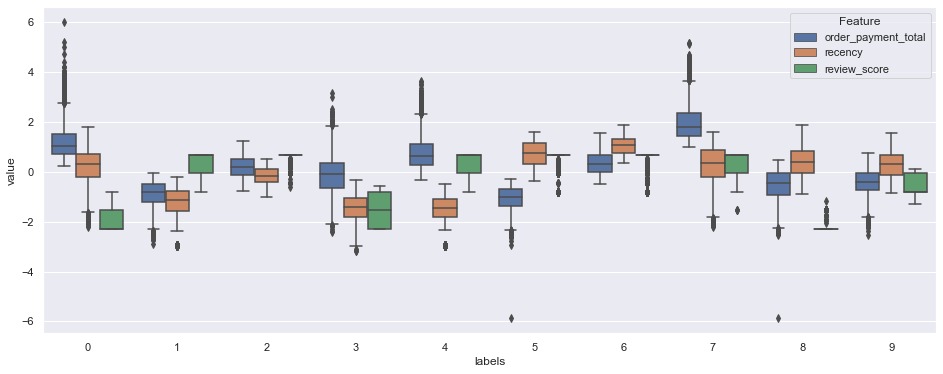

In [201]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

## 6.4 GaussianMixture - Vérsion 1

In [202]:
model_name = "GaussianMixture_1"

### 6.4.1 Evaluation du Modèle

In [203]:
model_dict = test_model(X_reduced, "GaussianMixture")
all_my_models[model_name] = model_dict

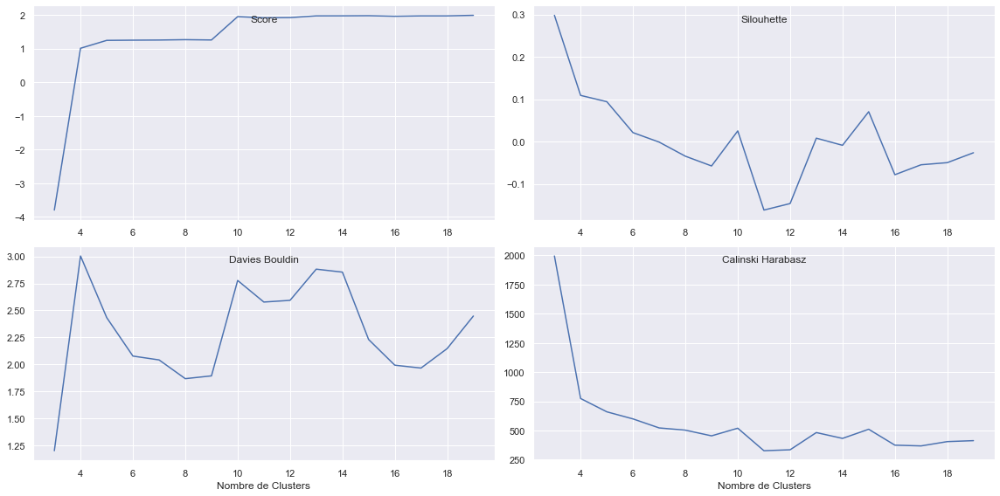

In [204]:
plot_model_evaluation(model_dict)

### 6.4.2 Choisir un Modèle

In [205]:
n_clusters = 3
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels_reduced = gm.predict(X_reduced.astype(float))
X_labels = gm.fit_predict(X_scaled)

In [206]:
gm.weights_

array([0.33057976, 0.40119277, 0.26822747])

In [207]:
gm.means_

array([[-0.015425  , -0.8559745 ,  0.51220534],
       [-0.03351195,  0.7402335 ,  0.52743863],
       [ 0.06913514, -0.05222613, -1.42017252]])

### 6.4.3 Visualisation des Clusters en 2-D

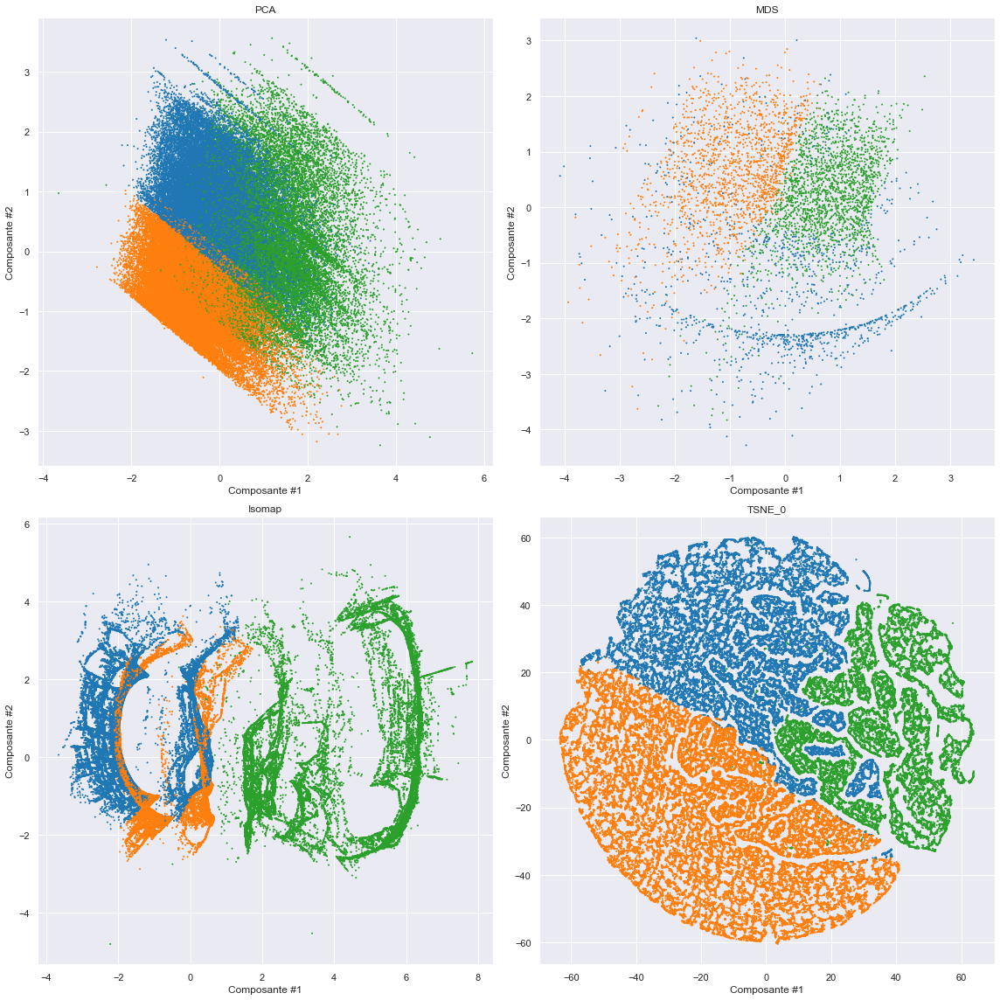

In [208]:
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [209]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 6.4.4 Distributions des Features par Groupe

In [210]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - resumé

In [211]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,order_payment_total,recency,review_score,weights
0,-0.015425,-0.855975,0.512205,0.330580
1,-0.033512,0.740234,0.527439,0.401193
2,0.069135,-0.052226,-1.420173,0.268227


#### Tableau - détails

In [212]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                0             1             2
order_payment_total count  32445.000000  40858.000000  22785.000000
                    mean      -0.019340     -0.034800      0.089943
                    std        0.992547      0.986319      1.029181
                    min       -2.880980     -2.936358     -5.884510
                    25%       -0.713607     -0.726363     -0.637156
                    50%       -0.082918     -0.071078      0.034334
                    75%        0.566387      0.558951      0.694375
                    max        5.163559      4.673832      6.011733
recency             count  32445.000000  40858.000000  22785.000000
                    mean      -0.940989      0.773298     -0.046742
                    std        0.630171      0.458935      0.968866
                    min       -2.971724     -0.083200     -3.159611
                    25%       -1.420651      0.377107     -0.658762
                    50%       -0.853645      0.778441      0.105727
                    75%       -0.364161      1.174953      0.653944
                    max        0.051742      1.872943      1.878712
review_score        count  32445.000000  40858.000000  22785.000000
                    mean       0.491488      0.507486     -1.609884
                    std        0.328538      0.319104      0.695249
                    min       -0.181821     -0.244034     -2.297030
                    25%       -0.057397      0.689147     -2.297030
                    50%        0.689147      0.689147     -1.550486
                    75%        0.689147      0.689147     -0.803942
                    max        0.689147      0.689147     -0.223296

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

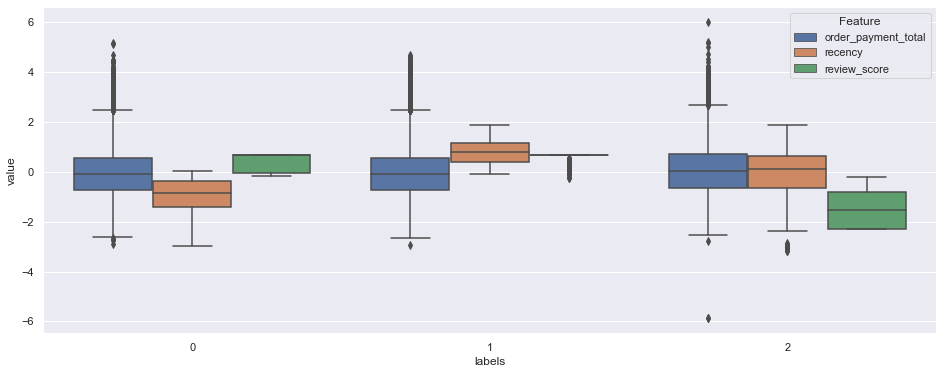

In [213]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

## 6.5 BIRCH - Vérsion 1

In [214]:
model_name = "BIRCH_1"

### 6.5.1 Evaluation du Modèle

In [215]:
model_dict = test_model(X_reduced, "Birch")
all_my_models[model_name] = model_dict

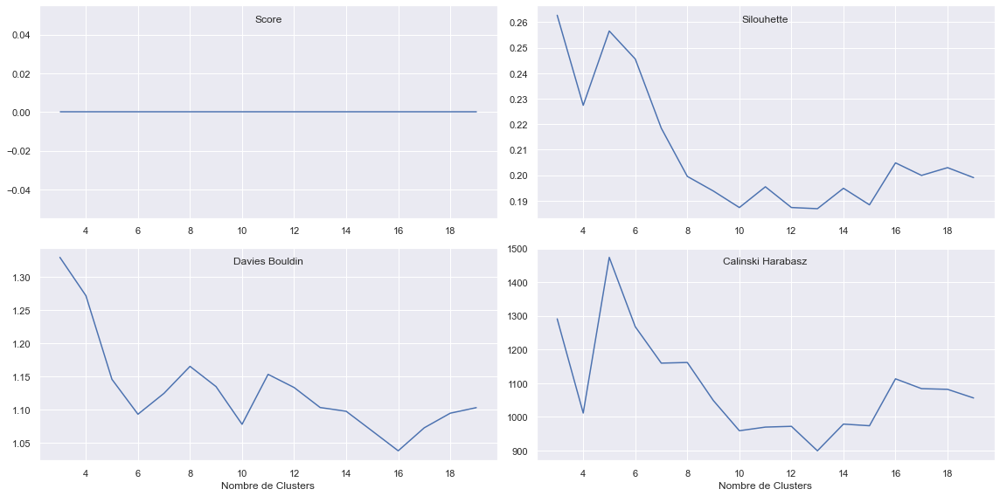

In [216]:
plot_model_evaluation(model_dict)

### 6.5.2 Choisir un Modèle

In [217]:
n_clusters = 5
bm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = bm.fit_predict(X_scaled)
X_labels_reduced = bm.predict(X_reduced.astype(float))

### 6.5.3 Visualisation des Clusters en 2-D

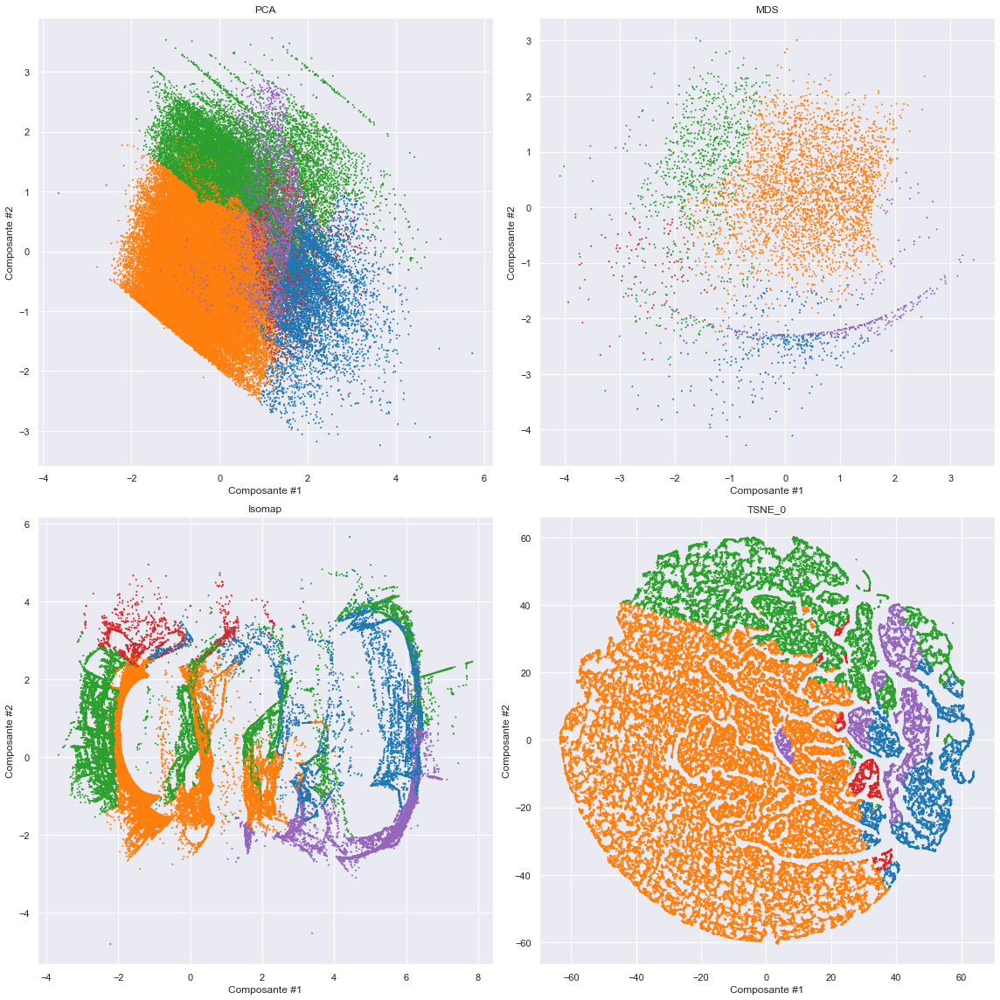

In [218]:
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [219]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 6.5.4 Distributions des Features par Groupe

In [220]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau

In [221]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                               0             1             2  \
order_payment_total count  7185.000000  63227.000000  17664.000000   
                    mean      1.132835     -0.087265     -0.110004   
                    std       0.947776      0.889765      0.850422   
                    min      -0.273092     -2.936358     -2.653588   
                    25%       0.405702     -0.721395     -0.702113   
                    50%       0.865144     -0.085565     -0.109025   
                    75%       1.642665      0.521129      0.444902   
                    max       6.011733      2.705337      4.536640   
recency             count  7185.000000  63227.000000  17664.000000   
                    mean      0.364829      0.387389     -1.507425   
                    std       0.604450      0.703892      0.468816   
                    min      -1.505915     -1.437881     -3.159611   
                    25%      -0.129486     -0.194180     -1.844954   
                    50%       0.377161      0.418127     -1.493063   
                    75%       0.794226      0.985022     -1.167292   
                    max       1.787829      1.872943      0.151303   
review_score        count  7185.000000  63227.000000  17664.000000   
                    mean     -1.877036      0.400240     -0.010272   
                    std       0.741531      0.469827      0.929022   
                    min      -2.297030     -1.177214     -2.297030   
                    25%      -2.297030     -0.057397     -0.803942   
                    50%      -2.297030      0.689147      0.689147   
                    75%      -1.550486      0.689147      0.689147   
                    max       0.689147      0.689147      0.689147   

labels                               3            4  
order_payment_total count  1812.000000  6200.000000  
                    mean      2.399645    -0.810804  
                    std       0.599475     0.528146  
                    min       1.340671    -5.884510  
                    25%       1.932373    -1.163604  
                    50%       2.322815    -0.742100  
                    75%       2.776282    -0.388604  
                    max       5.163559     0.103185  
recency             count  1812.000000  6200.000000  
                    mean     -1.008062     0.215972  
                    std       0.697527     0.867032  
                    min      -2.964532    -2.287356  
                    25%      -1.494082    -0.274574  
                    50%      -0.978587     0.331823  
                    75%      -0.502848     0.886491  
                    max       0.679949     1.878712  
review_score        count  1812.000000  6200.000000  
                    mean      0.505807    -2.024923  
                    std       0.356818     0.471088  
                    min      -1.550486    -2.297030  
                    25%       0.689147    -2.297030  
                    50%       0.689147    -2.297030  
                    75%       0.689147    -1.550486  
                    max       0.689147    -0.430670

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

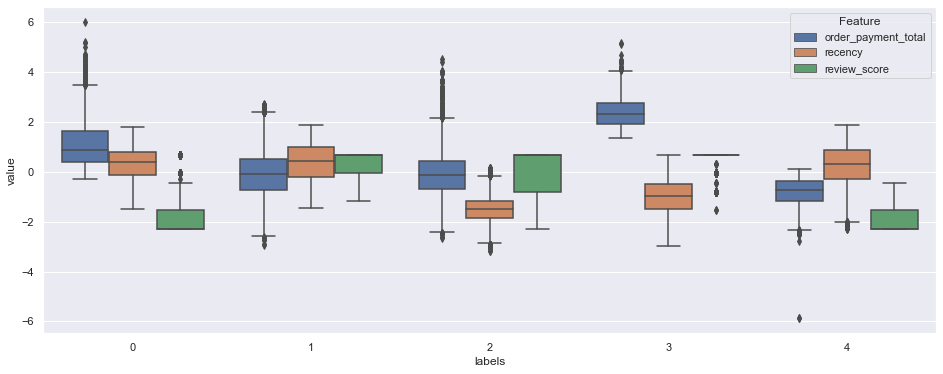

In [222]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

## 6.6 DBSCAN - Vérsion 1

In [31]:
model_name = "DBSCAN_1"

### 6.3.1 Evaluation du Modèle

In [35]:
eps_list = np.linspace(0.2, 0.5, 20)
e_list = []
nclusters_list = []
noisepoints_list = []
silhouette_list = []
c_h_list = []
d_b_list = []

X_db=X_reduced

for e in eps_list :
    db = DBSCAN(eps=e)
    X_labels= db.fit_predict(X_db)
    #core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
    #core_samples_mask[db.core_sample_indices_] = True
    labels = db.labels_

    # Number of clusters in labels, ignoring noise if present.
    n_clusters_ = len(set(X_labels)-set({-1}))
    n_noise_ = list(labels).count(-1)
    
    print(e, n_clusters_, n_noise_)
    
    if n_clusters_ > 1:
        e_list.append(e)
        nclusters_list.append(n_clusters_)
        noisepoints_list.append(n_noise_)
        silhouette_list.append(metrics.silhouette_score(X_db, X_labels))
        c_h_list.append(metrics.calinski_harabasz_score(X_db, X_labels))
        d_b_list.append(metrics.davies_bouldin_score(X_db, X_labels))

0.2 35 548
0.21578947368421053 30 486
0.23157894736842105 29 431
0.2473684210526316 25 373
0.26315789473684215 25 327
0.2789473684210526 24 287
0.2947368421052632 21 273
0.3105263157894737 18 241
0.3263157894736842 15 213
0.34210526315789475 12 200
0.35789473684210527 10 186
0.37368421052631584 6 172
0.3894736842105263 5 126
0.4052631578947369 4 106
0.4210526315789474 4 99
0.4368421052631579 4 90
0.45263157894736844 3 83
0.46842105263157896 2 81
0.4842105263157895 3 69
0.5 3 61


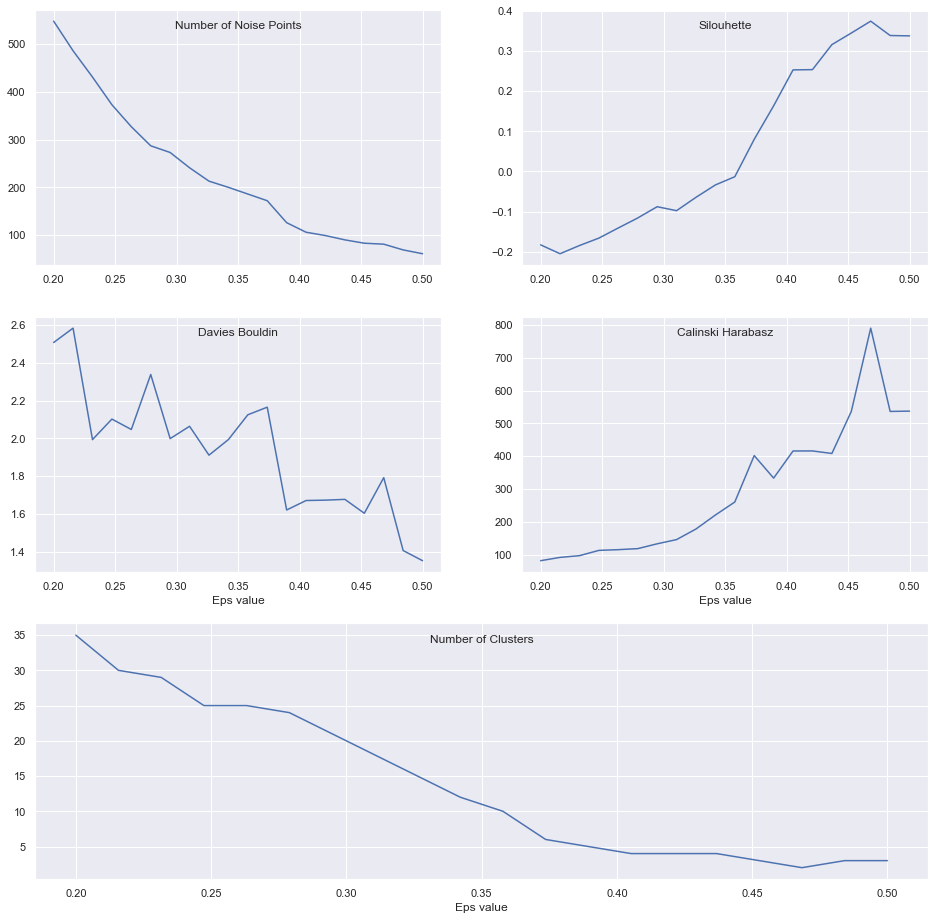

In [36]:
plt.figure(figsize=(16, 16))
ax1 = plt.subplot(3,2,1)
ax2 = plt.subplot(3,2,2)
ax3 = plt.subplot(3,2,3)
ax4 = plt.subplot(3,2,4)
ax5 = plt.subplot(3,1,3)
axs = [ax1, ax2, ax3, ax4, ax5]
    
#the smaller the better
axs[0].plot(e_list, noisepoints_list)
axs[0].set_title("Number of Noise Points", y=0.9)

#The score is bounded between -1 for incorrect clustering and +1 for highly dense clustering. 
#Scores around zero indicate overlapping clusters.
axs[1].plot(e_list, silhouette_list)
axs[1].set_title("Silouhette", y=0.9)

#Zero is the lowest possible score. Values closer to zero indicate a better partition.
axs[2].plot(e_list, d_b_list)
axs[2].set_title("Davies Bouldin", y=0.9)
axs[2].set_xlabel("Eps value")

#The score is higher when clusters are dense and well separated, 
#which relates to a standard concept of a cluster
axs[3].plot(e_list, c_h_list)
axs[3].set_title("Calinski Harabasz", y=0.9)
axs[3].set_xlabel("Eps value")

#The score is higher when clusters are dense and well separated, 
#which relates to a standard concept of a cluster
axs[4].plot(e_list, nclusters_list)
axs[4].set_title("Number of Clusters", y=0.9)
axs[4].set_xlabel("Eps value")

fig.tight_layout()

In [45]:
for ms in np.linspace(10,60,10):
    e=0.4
    db = DBSCAN(eps=e, min_samples=ms)
    X_labels = db.fit_predict(X_scaled)
    labels = db.labels_
    # Number of clusters in labels, ignoring noise if present.
    n_clusters_ = len(set(X_labels)-set({-1}))
    n_noise_ = list(labels).count(-1)
    print(ms, n_clusters_, n_noise_)

10.0 5 128
15.555555555555555 4 216
21.11111111111111 3 341
26.666666666666664 3 438
32.22222222222222 2 590
37.77777777777778 2 702
43.33333333333333 2 863
48.888888888888886 1 975
54.44444444444444 1 1098
60.0 1 1197


### 6.3.2 Choisir un Modèle

In [47]:
e=0.4
ms=15
db = DBSCAN(eps=e, min_samples=ms)
X_labels = db.fit_predict(X_scaled)
labels = db.labels_
# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(X_labels)-set({-1}))
n_noise_ = list(labels).count(-1)
print(ms, n_clusters_, n_noise_)

15 4 202


### 6.3.4 Distributions des Features par Groupe

In [48]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}
data = X_scaled.copy()
data['labels'] = X_labels

#### Tableau - détails

In [49]:
data.groupby('labels').describe().T

labels                             -1             0             1  \
order_payment_total count  202.000000  95648.000000  1.300000e+02   
                    mean     2.101067     -0.004484 -1.590189e-02   
                    std      2.309844      0.991150  8.752545e-01   
                    min     -5.884510     -2.716282 -1.837565e+00   
                    25%      0.585196     -0.700339 -6.916858e-01   
                    50%      2.944570     -0.050595 -4.253571e-02   
                    75%      3.937432      0.587363  5.952231e-01   
                    max      6.011733      4.530821  1.797086e+00   
recency             count  202.000000  95648.000000  1.300000e+02   
                    mean    -1.403891      0.010308 -2.948446e+00   
                    std      1.579339      0.986625  1.333637e-02   
                    min     -2.971724     -2.360281 -2.970209e+00   
                    25%     -2.944094     -0.697903 -2.960640e+00   
                    50%     -1.831560      0.130585 -2.947415e+00   
                    75%     -0.254846      0.813772 -2.938047e+00   
                    max      1.609604      1.878712 -2.925777e+00   
review_score        count  202.000000  95648.000000  1.300000e+02   
                    mean    -0.759593      0.002535  6.891468e-01   
                    std      0.925310      0.998345  1.114518e-16   
                    min     -2.297030     -2.297030  6.891468e-01   
                    25%     -1.550486     -0.057397  6.891468e-01   
                    50%     -0.803942      0.689147  6.891468e-01   
                    75%     -0.057397      0.689147  6.891468e-01   
                    max      0.689147      0.689147  6.891468e-01   

labels                                2             3  
order_payment_total count  7.700000e+01  3.100000e+01  
                    mean   2.282415e-01 -3.560479e-01  
                    std    7.971019e-01  4.218048e-01  
                    min   -1.240714e+00 -1.108606e+00  
                    25%   -2.839134e-01 -6.674603e-01  
                    50%    1.183128e-01 -3.948354e-01  
                    75%    7.578185e-01  9.964897e-03  
                    max    1.775393e+00  3.826541e-01  
recency             count  7.700000e+01  3.100000e+01  
                    mean  -2.956782e+00 -2.947294e+00  
                    std    4.132982e-02  1.386490e-02  
                    min   -3.159611e+00 -2.966140e+00  
                    25%   -2.963856e+00 -2.959159e+00  
                    50%   -2.953064e+00 -2.951268e+00  
                    75%   -2.940530e+00 -2.932299e+00  
                    max   -2.850174e+00 -2.926097e+00  
review_score        count  7.700000e+01  3.100000e+01  
                    mean  -2.297030e+00 -5.739745e-02  
                    std    4.470013e-16  1.410719e-17  
                    min   -2.297030e+00 -5.739745e-02  
                    25%   -2.297030e+00 -5.739745e-02  
                    50%   -2.297030e+00 -5.739745e-02  
                    75%   -2.297030e+00 -5.739745e-02  
                    max   -2.297030e+00 -5.739745e-02

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

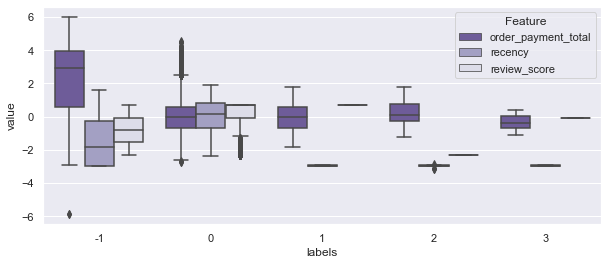

In [50]:
fig, ax = plt.subplots(figsize = (10,4))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']),
           palette = 'Purples_r')

<AxesSubplot:xlabel='Feature', ylabel='value'>

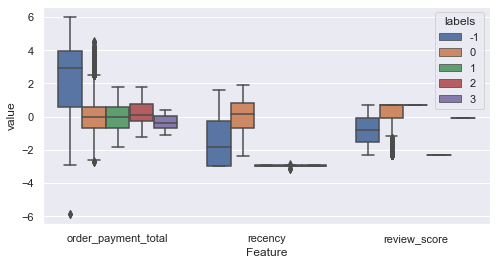

In [51]:
fig, ax = plt.subplots(figsize = (8,4))
sns.boxplot(x="Feature", y="value", hue="labels", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

# 6b. Modèles - Vérsion 1b

## 6b.1 Sélection des Features

In [633]:
passthrough_features = []
standardscale_features = ['recency', 'review_score', 'order_payment_total']
log1pscale_features = []
logscale_features = []
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [634]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)

X_reduced = X_scaled.sample(frac=0.05, random_state=seed).astype(np.float32)
all_components = len(X_scaled.columns)

## 6b.2  Créations des Projections

In [635]:
projection_version = "Version1b"
do_projection = True & global_do_projections

In [155]:
if do_projection :
    all_my_projections[projection_version] = {}

#### PCA

In [156]:
if do_projection :
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)
    all_my_projections[projection_version]["PCA"] = {"X_proj" : X_pca, "model": pca}

#### MDS

In [157]:
if do_projection :
    mds = MDS(n_components=2)
    X_reduced_mds = mds.fit_transform(X_reduced)
    all_my_projections[projection_version]["MDS"] = {"X_proj" : X_reduced_mds, "model": mds}

#### Isomap

In [158]:
if do_projection :
    iso = Isomap(n_components=2)
    X_reduced_iso = iso.fit_transform(X_reduced)
    X_iso = iso.transform(X_scaled)
    all_my_projections[projection_version]["Isomap"] = {"X_proj" : X_iso, "model": iso}

#### t_SNE

In [159]:
if do_projection :
    tsne = TSNE(n_components=2, init='pca')
    X_tsne0 = tsne.fit_transform(X_scaled)
    all_my_projections[projection_version]["TSNE_0"] = {"X_proj" : X_tsne0, "model": tsne}

## -- BREAK Store/Reload Data --

In [160]:
dill.dump_session('notebook_env.db')

In [161]:
dill.load_session('notebook_env.db')

## 6b.3 K-Means - Vérsion 1b

In [636]:
model_name = "KMeans_1b"

### 6b.3.1 Evaluation du Modèle

In [265]:
model_dict = test_model(X_reduced)
all_my_models[model_name] = model_dict

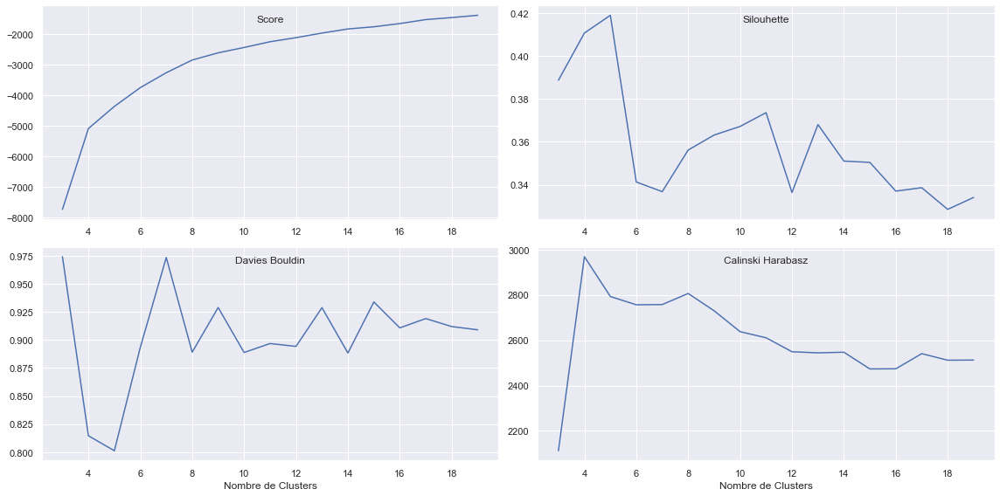

In [266]:
plot_model_evaluation(model_dict)

### 6b.3.2 Choisir un Modèle

In [640]:
n_clusters = 4
km = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = km.fit_predict(X_scaled)
X_labels_reduced = km.predict(X_reduced.astype(float))

In [641]:
data = X_scaled.copy()
data['labels'] = X_labels

### 6b.3.3 Visualisation des Clusters en 2-D

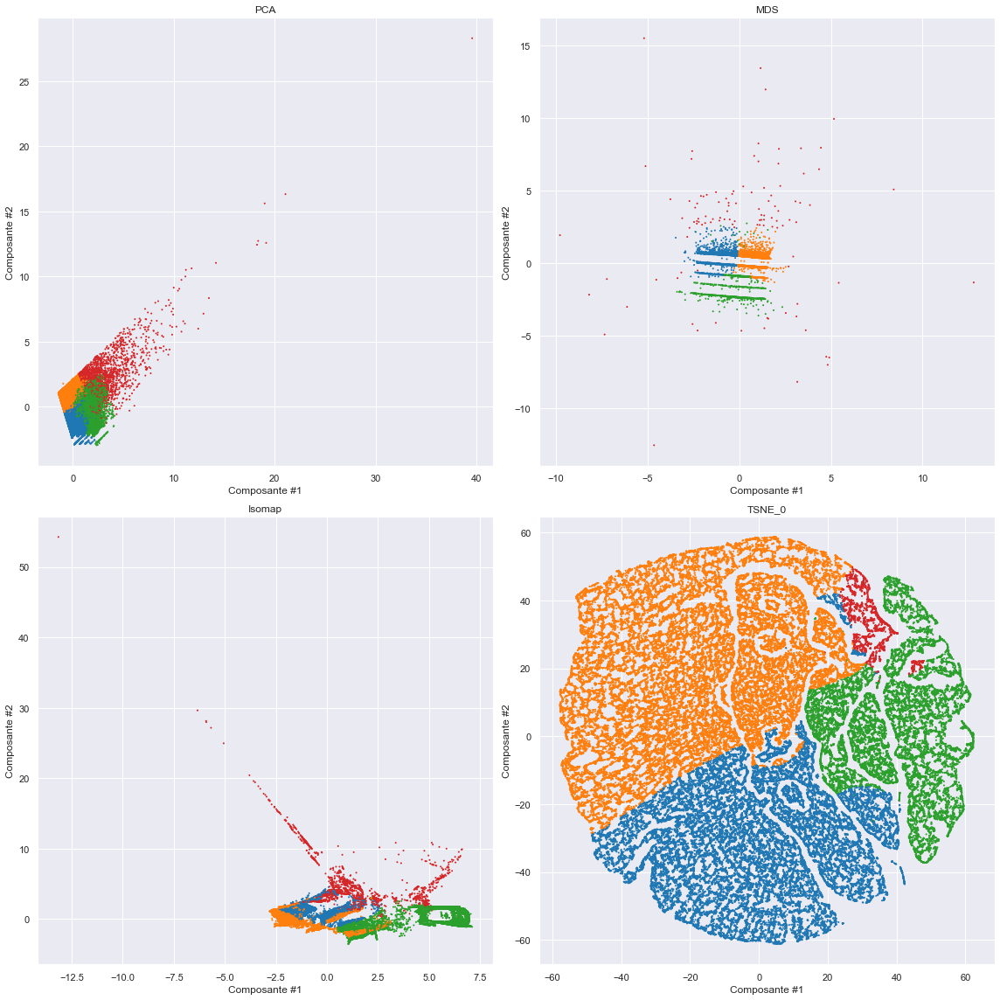

In [642]:
projection_version = 'Version1b'
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

### 6b.3.4 Distributions des Features par Groupe

In [643]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - résumé

In [644]:
pd.DataFrame(km.cluster_centers_, columns=X_scaled.columns).merge(
    pd.Series(km.labels_, name="fraction").value_counts(normalize=True).sort_index(),
    right_index=True, left_index=True)

,recency,review_score,order_payment_total,fraction
0,-1.006000,0.406474,-0.128960,0.339824
1,0.764453,0.439676,-0.130505,0.451836
2,-0.017815,-1.811025,-0.043386,0.184955
3,-0.012688,-0.078919,4.734463,0.023385


#### Tableau - détails

In [645]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                0             1             2  \
recency             count  32653.000000  43416.000000  17772.000000   
                    mean      -1.005919      0.764497     -0.017812   
                    std        0.620210      0.473862      0.857285   
                    min       -2.971724     -0.125452     -3.159611   
                    25%       -1.473855      0.359132     -0.417153   
                    50%       -0.941826      0.784057      0.107493   
                    75%       -0.457667      1.179439      0.516232   
                    max       -0.112982      1.872943      1.878712   
review_score        count  32653.000000  43416.000000  17772.000000   
                    mean       0.406500      0.439664     -1.810969   
                    std        0.453146      0.421807      0.627473   
                    min       -1.550486     -0.803942     -2.297030   
                    25%       -0.057397     -0.057397     -2.297030   
                    50%        0.689147      0.689147     -2.297030   
                    75%        0.689147      0.689147     -1.550486   
                    max        0.689147      0.689147     -0.617306   
order_payment_total count  32653.000000  43416.000000  17772.000000   
                    mean      -0.128837     -0.130542     -0.043254   
                    std        0.492036      0.479945      0.570821   
                    min       -0.680725     -0.726021     -0.726021   
                    25%       -0.452759     -0.455323     -0.428919   
                    50%       -0.276207     -0.266446     -0.216854   
                    75%        0.015317      0.026180      0.128929   
                    max        2.804119      2.504048      2.825485   

labels                               3  
recency             count  2247.000000  
                    mean     -0.012732  
                    std       1.011390  
                    min      -2.964532  
                    25%      -0.761179  
                    50%       0.093211  
                    75%       0.834927  
                    max       1.609604  
review_score        count  2247.000000  
                    mean     -0.078938  
                    std       1.070650  
                    min      -2.297030  
                    25%      -0.803942  
                    50%       0.689147  
                    75%       0.689147  
                    max       0.689147  
order_payment_total count  2247.000000  
                    mean      4.736634  
                    std       3.033200  
                    min       2.207576  
                    25%       2.971247  
                    50%       3.798253  
                    75%       5.441581  
                    max      60.736923

#### Boxplots

(-5.0, 15.0)

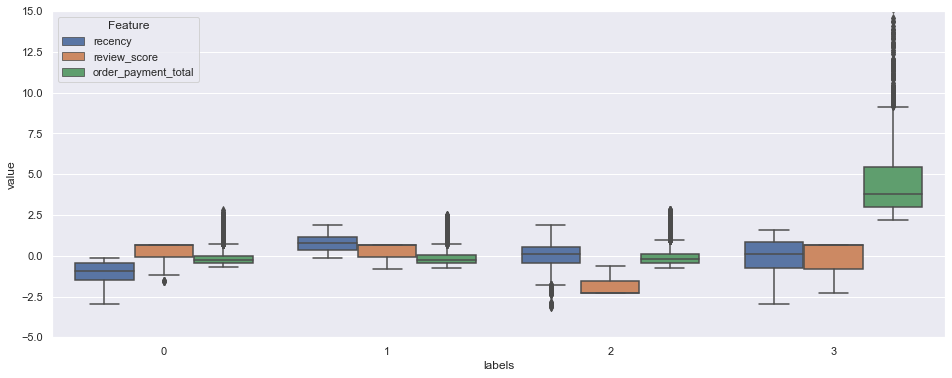

In [646]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5, 15)

(-5.0, 5.0)

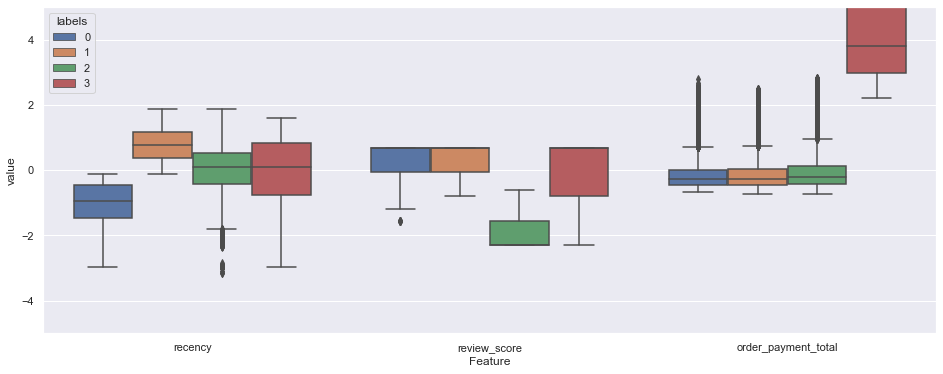

In [647]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="Feature", y="value", hue="labels", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5, 5)

## 6b.4 GaussianMixture - Vérsion 1b

In [274]:
model_name = "GaussianMixture_6b"

### 6b.4.1 Evaluation du Modèle

In [275]:
model_dict = test_model(X_reduced, "GaussianMixture")
all_my_models[model_name] = model_dict

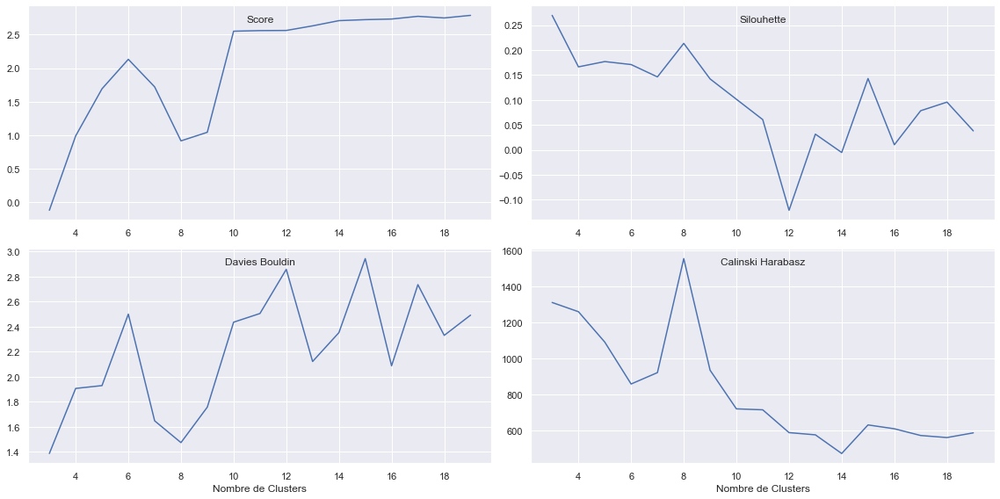

In [276]:
plot_model_evaluation(model_dict)

### 6b.4.2 Choisir un Modèle

In [277]:
n_clusters = 8
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 6b.4.3 Visualisation des Clusters en 2-D

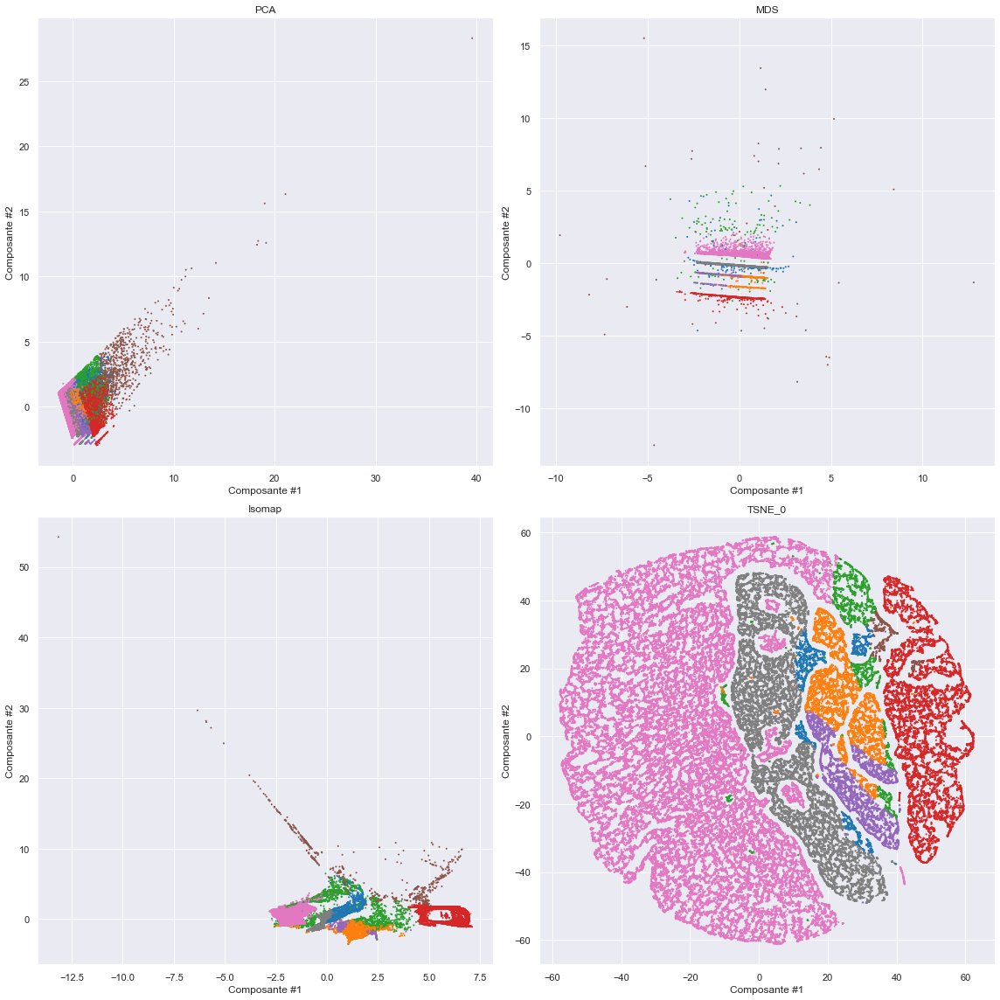

In [278]:
projection_version = 'Version1b'
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [279]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 6b.4.4 Distributions des Features par Groupe

In [280]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - resumé

In [281]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,recency,review_score,order_payment_total,weights
0,-0.100322,-0.057397,1.107870,0.027504
1,0.504849,-0.993526,-0.131268,0.062824
2,-0.150783,-0.088094,1.882506,0.030979
3,-0.040445,-2.297030,-0.002565,0.109209
4,-0.721297,-0.955393,-0.363223,0.046708
5,0.019031,-0.728955,5.951338,0.010268
6,0.025679,0.689147,-0.148409,0.549983
7,-0.003062,-0.057397,-0.263226,0.162526


#### Tableau

In [282]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                               0            1            2  \
recency             count  2215.000000  6357.000000  2941.000000   
                    mean     -0.073185     0.565196    -0.148795   
                    std       1.017773     0.601727     1.070314   
                    min      -2.965700    -1.380490    -2.966206   
                    25%      -0.787972     0.195943    -0.976887   
                    50%       0.045510     0.587208    -0.076239   
                    75%       0.739165     1.038341     0.782323   
                    max       1.528483     1.773861     1.563815   
review_score        count  2215.000000  6357.000000  2941.000000   
                    mean     -0.057397    -1.009320     0.005257   
                    std       0.000000     0.363563     0.814933   
                    min      -0.057397    -2.110394    -2.110394   
                    25%      -0.057397    -1.550486    -0.803942   
                    50%      -0.057397    -0.803942     0.689147   
                    75%      -0.057397    -0.803942     0.689147   
                    max      -0.057397     0.315875     0.689147   
order_payment_total count  2215.000000  6357.000000  2941.000000   
                    mean      1.377704    -0.122160     2.036620   
                    std       1.115093     0.324543     1.417000   
                    min       0.370445    -0.726021    -0.637903   
                    25%       0.635161    -0.396443     0.907703   
                    50%       0.936986    -0.160425     2.086126   
                    75%       1.742783     0.095339     2.932451   
                    max       6.249154     0.793585     5.677306   

labels                                3            4           5  \
recency             count  1.049600e+04  4414.000000  767.000000   
                    mean  -4.083867e-02    -0.862155    0.014926   
                    std    9.560755e-01     0.727690    1.031764   
                    min   -3.159611e+00    -2.970562   -2.959412   
                    25%   -5.539514e-01    -1.452621   -0.664686   
                    50%    1.323568e-01    -0.801326    0.182452   
                    75%    5.946948e-01    -0.248372    0.845302   
                    max    1.878712e+00     0.380219    1.609604   
review_score        count  1.049600e+04  4414.000000  767.000000   
                    mean  -2.297030e+00    -0.951903   -0.857962   
                    std    8.882207e-16     0.308113    1.301531   
                    min   -2.297030e+00    -2.110394   -2.297030   
                    25%   -2.297030e+00    -0.803942   -2.297030   
                    50%   -2.297030e+00    -0.803942   -0.803942   
                    75%   -2.297030e+00    -0.803942    0.689147   
                    max   -2.297030e+00     0.129239    0.689147   
order_payment_total count  1.049600e+04  4414.000000  767.000000   
                    mean  -2.276110e-03    -0.373722    7.148938   
                    std    6.283780e-01     0.173693    4.066855   
                    min   -7.260214e-01    -0.664037    2.417504   
                    25%   -4.173928e-01    -0.512326    4.569796   
                    50%   -1.996266e-01    -0.406856    6.590878   
                    75%    1.627886e-01    -0.265119    8.410960   
                    max    3.111882e+00     0.202889   60.736923   

labels                                6             7  
recency             count  5.284600e+04  1.605200e+04  
                    mean   2.611297e-02 -9.373097e-03  
                    std    1.011623e+00  9.938869e-01  
                    min   -2.970209e+00 -2.971724e+00  
                    25%   -7.217006e-01 -7.228546e-01  
                    50%    1.391415e-01  1.058383e-01  
                    75%    8.601313e-01  7.961197e-01  
                    max    1.872943e+00  1.611766e+00  
review_score        count  5.284600e+04  1.605200e+04  
                    mean   6.891468e-0

#### Boxplots

(-5.0, 15.0)

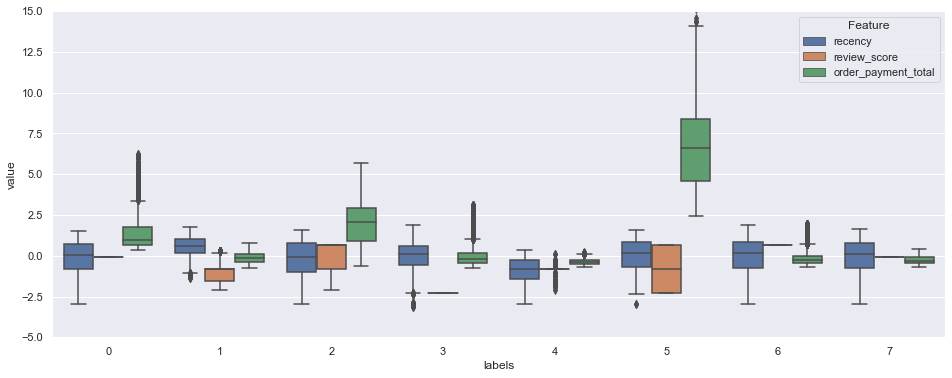

In [283]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5, 15)

### 6b.4.5 Choisir un deuxième Modèle -2

In [287]:
n_clusters = 4
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 6b.4.6 Visualisation des Clusters en 2-D -2

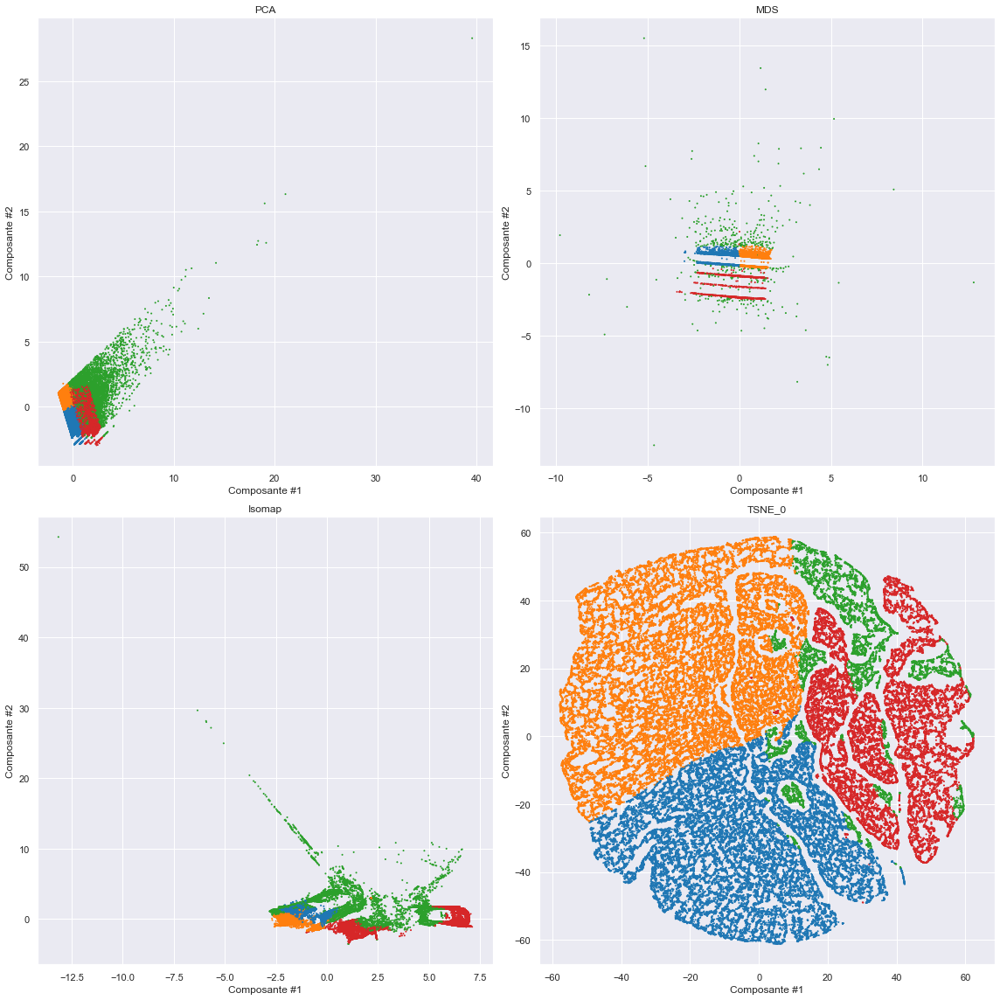

In [288]:
projection_version = 'Version1b'
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [289]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 6b.4.7 Distributions des Features par Groupe - 2

In [290]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - résumé

In [291]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,recency,review_score,order_payment_total,weights
0,-0.836031,0.525753,-0.232373,0.297304
1,0.756941,0.543516,-0.212401,0.352943
2,-0.061249,-0.231436,1.797299,0.110215
3,-0.049476,-1.346896,-0.225597,0.239537


#### Tableau - détails

In [292]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                0             1            2  \
recency             count  29991.000000  37017.000000  9208.000000   
                    mean      -0.920728      0.786733    -0.069778   
                    std        0.635717      0.452467     1.014689   
                    min       -2.971724     -0.161906    -2.966621   
                    25%       -1.406075      0.399004    -0.768236   
                    50%       -0.834240      0.789164     0.041220   
                    75%       -0.337822      1.182393     0.752978   
                    max        0.080439      1.872943     1.655003   
review_score        count  29991.000000  37017.000000  9208.000000   
                    mean       0.490414      0.515565    -0.209070   
                    std        0.329102      0.314039     1.094379   
                    min       -0.181821     -0.244034    -2.297030   
                    25%       -0.057397      0.689147    -0.803942   
                    50%        0.689147      0.689147    -0.057397   
                    75%        0.689147      0.689147     0.689147   
                    max        0.689147      0.689147     0.689147   
order_payment_total count  29991.000000  37017.000000  9208.000000   
                    mean      -0.237931     -0.214334     2.099749   
                    std        0.293887      0.316192     2.165001   
                    min       -0.680725     -0.682884     0.397254   
                    25%       -0.466389     -0.464545     0.929508   
                    50%       -0.312372     -0.287408     1.367390   
                    75%       -0.069203     -0.028675     2.426849   
                    max        0.775683      0.878195    60.736923   

labels                                3  
recency             count  19872.000000  
                    mean      -0.043599  
                    std        0.964666  
                    min       -3.159611  
                    25%       -0.650466  
                    50%        0.109862  
                    75%        0.651811  
                    max        1.878712  
review_score        count  19872.000000  
                    mean      -1.603640  
                    std        0.695191  
                    min       -2.297030  
                    25%       -2.297030  
                    50%       -1.550486  
                    75%       -0.803942  
                    max       -0.206706  
order_payment_total count  19872.000000  
                    mean      -0.214608  
                    std        0.295105  
                    min       -0.726021  
                    25%       -0.451146  
                    50%       -0.278771  
                    75%       -0.025976  
                    max        0.690038

#### Boxplots

(-5.0, 15.0)

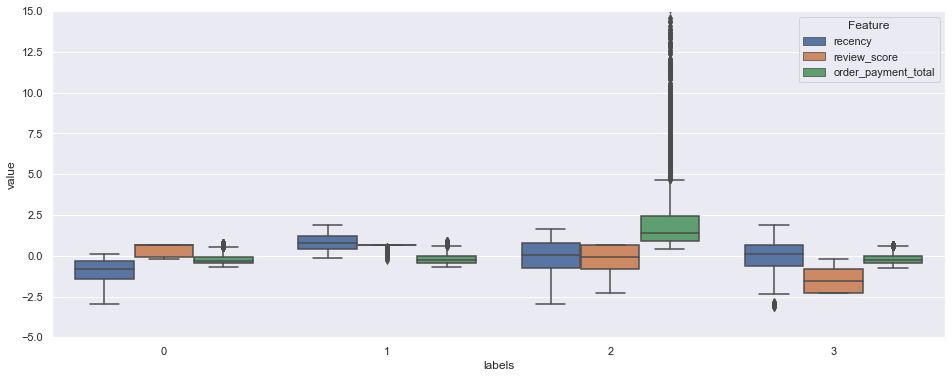

In [293]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5, 15)

## 6b.5 BIRCH - Vérsion 1b

In [294]:
model_name = "BIRCH_1b"

### 6b.5.1 Evaluation du Modèle

In [295]:
model_dict = test_model(X_reduced, "Birch")
all_my_models[model_name] = model_dict

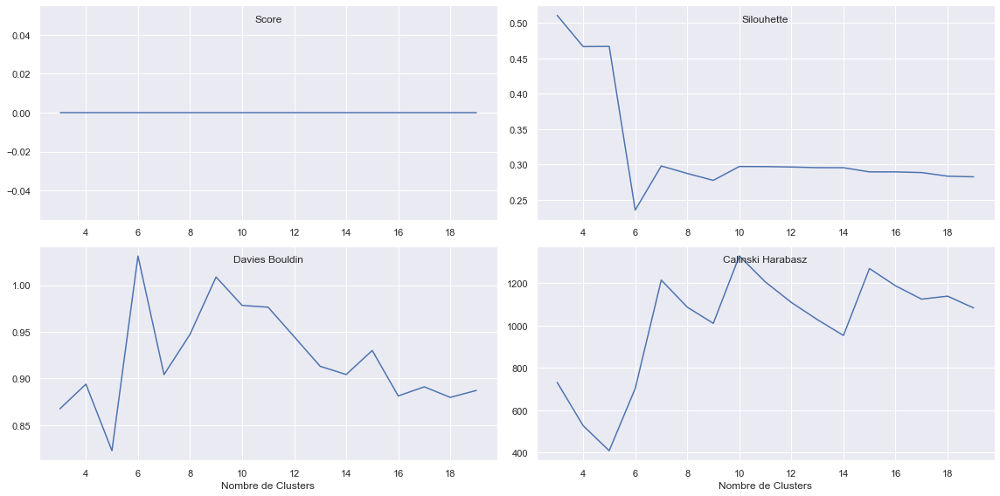

In [296]:
plot_model_evaluation(model_dict)

### 6b.5.2 Choisir un Modèle

In [297]:
n_clusters = 5
bm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = bm.fit_predict(X_scaled)
X_labels_reduced = bm.predict(X_reduced.astype(float))

### 6b.5.3 Visualisation des Clusters en 2-D

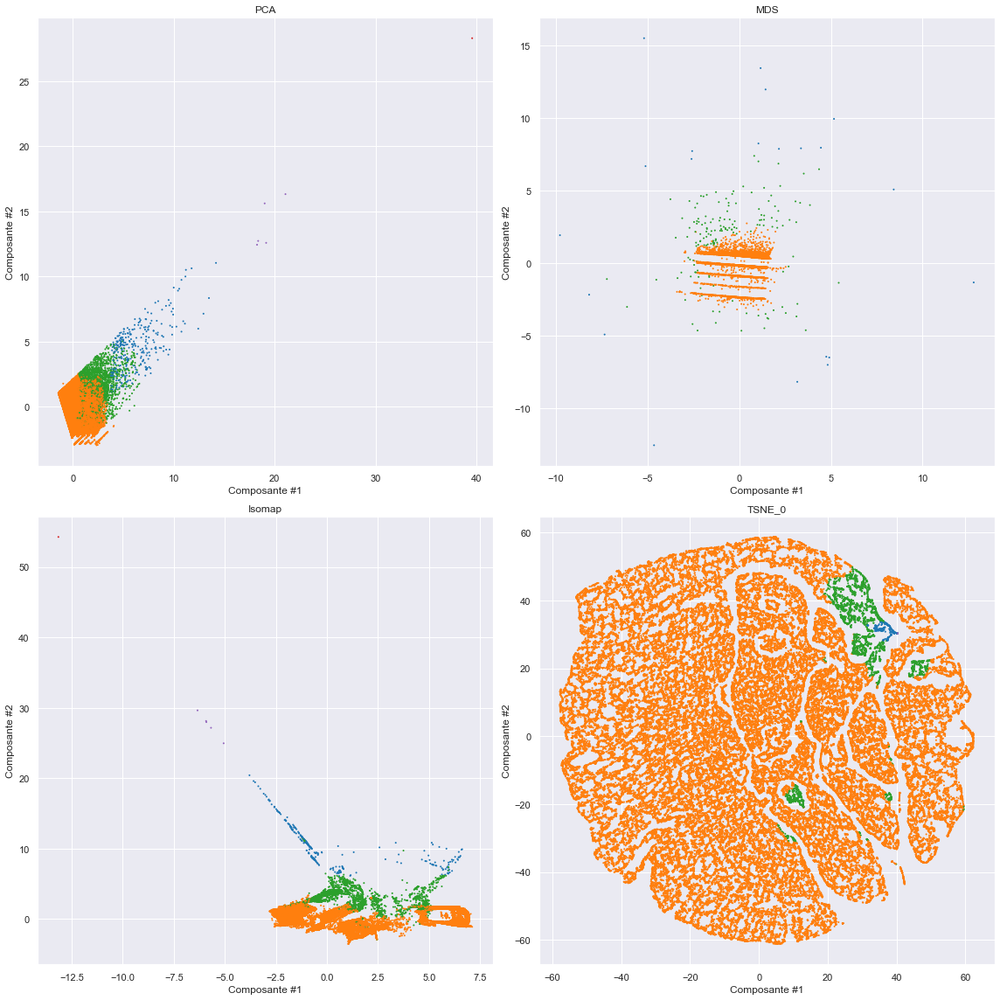

In [298]:
projection_version = 'Version1b'
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [299]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 6b.5.4 Distributions des Features par Groupe

In [300]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - resumé

#### Tableau - détails

In [301]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                              0             1            2          3  \
recency             count  323.000000  92480.000000  3279.000000   1.000000   
                    mean    -0.155455      0.015767    -0.428812  -0.618709   
                    std      1.142938      0.993466     1.069400        NaN   
                    min     -2.222140     -3.159611    -2.964532  -0.618709   
                    25%     -1.258269     -0.683953    -1.381155  -0.618709   
                    50%     -0.200658      0.138654    -0.385719  -0.618709   
                    75%      0.867747      0.816473     0.454014  -0.618709   
                    max      1.609604      1.878712     1.537035  -0.618709   
review_score        count  323.000000  92480.000000  3279.000000   1.000000   
                    mean    -0.131358      0.001298    -0.021728  -2.297030   
                    std      1.146040      0.998221     1.031839        NaN   
                    min     -2.297030     -2.297030    -2.297030  -2.297030   
                    25%     -0.803942     -0.057397    -0.803942  -2.297030   
                    50%      0.689147      0.689147     0.689147  -2.297030   
                    75%      0.689147      0.689147     0.689147  -2.297030   
                    max      0.689147      0.689147     0.689147  -2.297030   
order_payment_total count  323.000000  92480.000000  3279.000000   1.000000   
                    mean     9.544406     -0.140666     2.963149  60.736923   
                    std      2.825472      0.449230     1.425874        NaN   
                    min      5.935859     -0.726021     0.700564  60.736923   
                    25%      7.829823     -0.451410     2.014560  60.736923   
                    50%      8.640725     -0.267076     2.691890  60.736923   
                    75%     10.372014      0.022199     3.732288  60.736923   
                    max     20.907513      2.511470     7.814192  60.736923   

labels                             4  
recency             count   5.000000  
                    mean   -0.244189  
                    std     1.557413  
                    min    -2.110190  
                    25%    -1.452399  
                    50%    -0.254817  
                    75%     1.265180  
                    max     1.331280  
review_score        count   5.000000  
                    mean   -0.803942  
                    std     1.493088  
                    min    -2.297030  
                    25%    -2.297030  
                    50%    -0.803942  
                    75%     0.689147  
                    max     0.689147  
order_payment_total count   5.000000  
                    mean   29.802495  
                    std     1.983618  
                    min    26.629597  
                    25%    29.531437  
                    50%    30.411048  
                    75%    30.442985  
                    max    31.997407

#### Boxplots

(-5.0, 15.0)

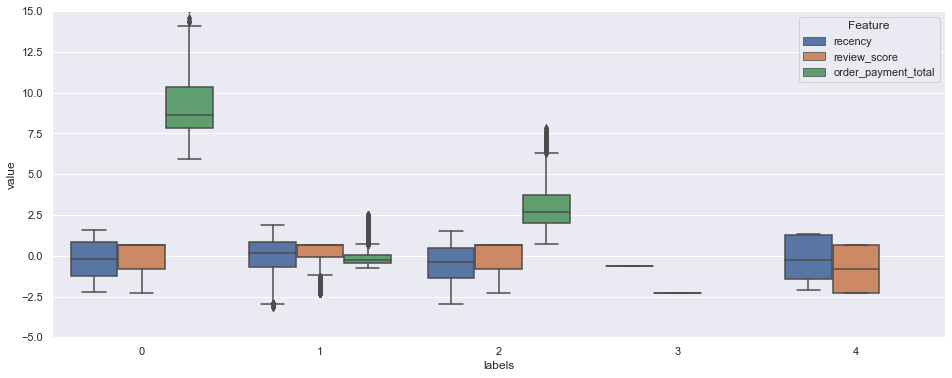

In [302]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5,15)

# 7. Modèles - Vérsion 2

## 7.1 Sélection des Features

In [46]:
passthrough_features = []
standardscale_features = ['recency', 'review_score']
log1pscale_features = ['order_payment_total']
logscale_features = ['customer_zip_code_density_3digits']
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [47]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)

X_reduced = X_scaled.sample(frac=0.05, random_state=seed).astype(np.float32)
all_components = len(X_scaled.columns)

## 7.2  Créations des Projections

In [305]:
projection_version = "Version2"

In [306]:
all_my_projections[projection_version] = {}

#### PCA

In [307]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

In [308]:
all_my_projections[projection_version]["PCA"] = {"X_proj" : X_pca, "model": pca}

#### MDS

In [309]:
mds = MDS(n_components=2)
X_reduced_mds = mds.fit_transform(X_reduced)

In [310]:
all_my_projections[projection_version]["MDS"] = {"X_proj" : X_reduced_mds, "model": mds}

#### Isomap

In [311]:
iso = Isomap(n_components=2)
X_reduced_iso = iso.fit_transform(X_reduced)
X_iso = iso.transform(X_scaled)

In [312]:
all_my_projections[projection_version]["Isomap"] = {"X_proj" : X_iso, "model": iso}

#### t_SNE

In [313]:
tsne = TSNE(n_components=2, init='pca')
X_tsne0 = tsne.fit_transform(X_scaled)

In [314]:
all_my_projections[projection_version]["TSNE_0"] = {"X_proj" : X_tsne0, "model": tsne}

## -- BREAK Store/Reload Data --

In [315]:
dill.dump_session('notebook_env.db')

In [316]:
dill.load_session('notebook_env.db')

## 7.3 K-Means - Vérsion 2

In [48]:
model_name = "KMeans_2"

### 7.3.1 Evaluation du Modèle

In [49]:
model_dict = test_model(X_reduced)
all_my_models[model_name] = model_dict

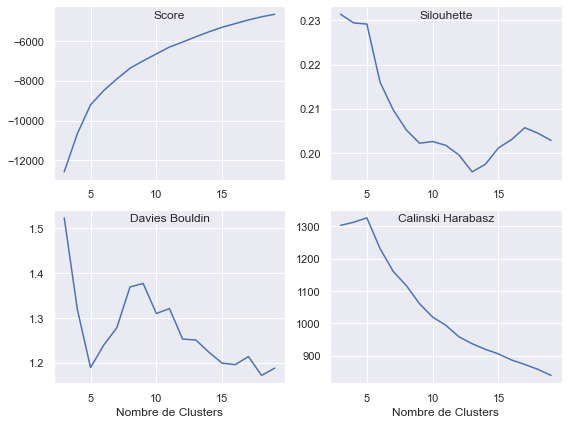

In [54]:
model_dict = all_my_models["KMeans_2"]
plot_model_evaluation(model_dict, figsize=(8,6))

### 7.3.2 Choisir un Modèle

In [55]:
n_clusters = 5
km = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = km.fit_predict(X_scaled)
X_labels_reduced = km.predict(X_reduced.astype(float))

### 7.3.3 Visualisation des Clusters en 2-D

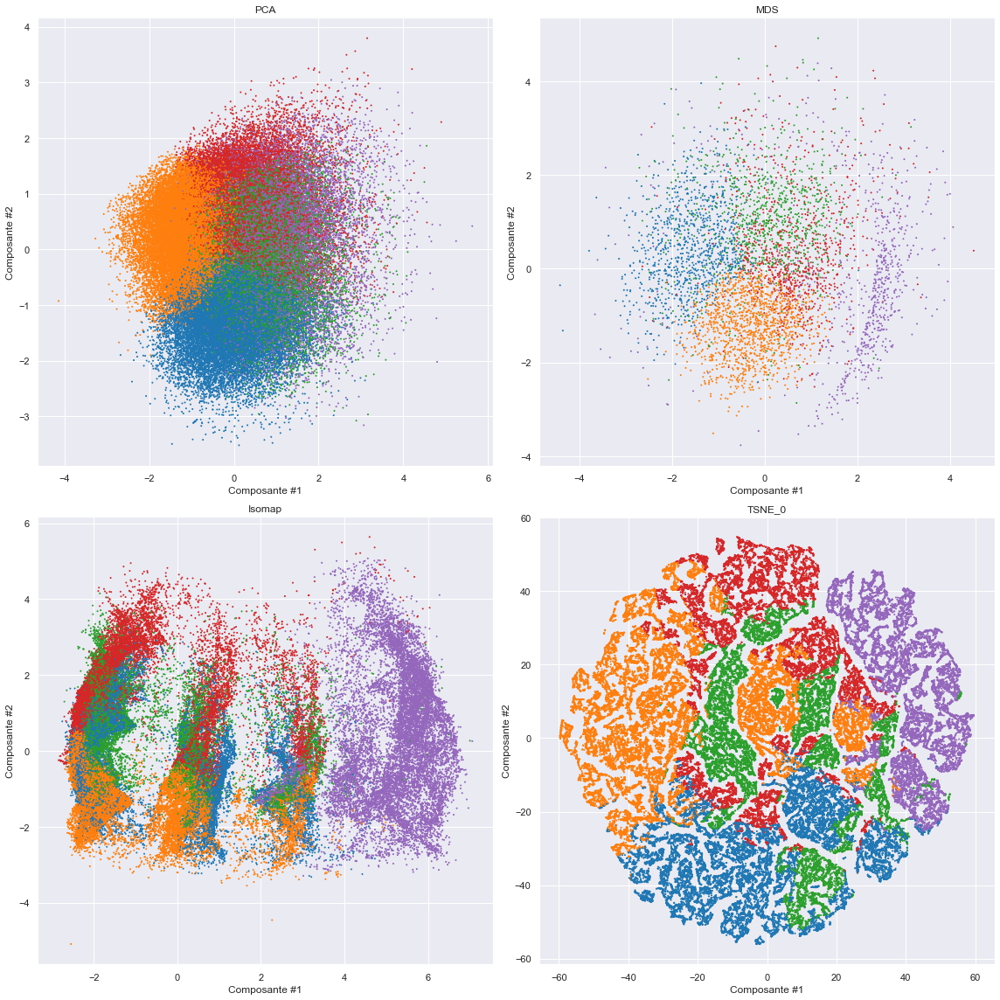

In [56]:
projection_version = "Version2"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

### 7.3.4 Distributions des Features par Groupe

In [57]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau

In [58]:
pd.DataFrame(km.cluster_centers_, columns=X_scaled.columns).merge(
    pd.Series(km.labels_, name="fraction").value_counts(normalize=True).sort_index(),
    right_index=True, left_index=True)

,customer_zip_code_density_3digits,order_payment_total,recency,review_score,fraction
0,0.204755,-0.234491,-1.292046,0.355828,0.211691
1,0.558633,-0.668789,0.645685,0.388976,0.275685
2,-1.380094,-0.032353,0.177535,0.326415,0.181979
3,0.283043,1.205405,0.375013,0.367372,0.181063
4,0.017253,0.147765,-0.032625,-2.061121,0.149582


In [59]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0             1  \
customer_zip_code_density_3digits count  20341.000000  26490.000000   
                                  mean       0.201597      0.559693   
                                  std        0.777712      0.630849   
                                  min       -2.692599     -1.105850   
                                  25%       -0.312395      0.146006   
                                  50%        0.228536      0.533904   
                                  75%        0.695075      1.008102   
                                  max        2.029172      2.029172   
order_payment_total               count  20341.000000  26490.000000   
                                  mean      -0.232703     -0.670178   
                                  std        0.787353      0.615921   
                                  min       -2.597484     -5.884510   
                                  25%       -0.788472     -1.126694   
                                  50%       -0.233294     -0.625599   
                                  75%        0.300808     -0.163961   
                                  max        3.187162      0.624266   
recency                           count  20341.000000  26490.000000   
                                  mean      -1.293644      0.643851   
                                  std        0.550597      0.569692   
                                  min       -3.102527     -0.894574   
                                  25%       -1.708398      0.178062   
                                  50%       -1.271299      0.685998   
                                  75%       -0.861332      1.136172   
                                  max       -0.124464      1.611766   
review_score                      count  20341.000000  26490.000000   
                                  mean       0.355149      0.389054   
                                  std        0.518866      0.486002   
                                  min       -2.297030     -2.297030   
                                  25%       -0.057397     -0.057397   
                                  50%        0.689147      0.689147   
                                  75%        0.689147      0.689147   
                                  max        0.689147      0.689147   

labels                                              2             3  \
customer_zip_code_density_3digits count  17486.000000  17398.000000   
                                  mean      -1.379230      0.283884   
                                  std        0.648630      0.725778   
                                  min       -5.508351     -2.924617   
                                  25%       -1.726095     -0.231333   
                                  50%       -1.286421      0.273484   
                                  75%       -0.913769      0.729169   
                                  max       -0.224855      2.029172   
order_payment_total               count  17486.000000  17398.000000   
                                  mean      -0.033243      1.203687   
                                  std        0.770929      0.772290   
                                  min       -2.653588      0.120970   
                                  25%       -0.584355      0.613595   
                                  50%       -0.018972      0.979061   
                                  75%        0.473543      1.584011   
                                  max        3.371884      6.011733   
recency                           count  17486.000000  17398.000000   
                                  mean       0.181155      0.376393   
                                  std        0.808881      0.745993   
                                  min       -2.970152     -2.241105   
                                  25%       -0.325223     -0.174311   
                                  50%        0.209206      0.451697   
                       

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

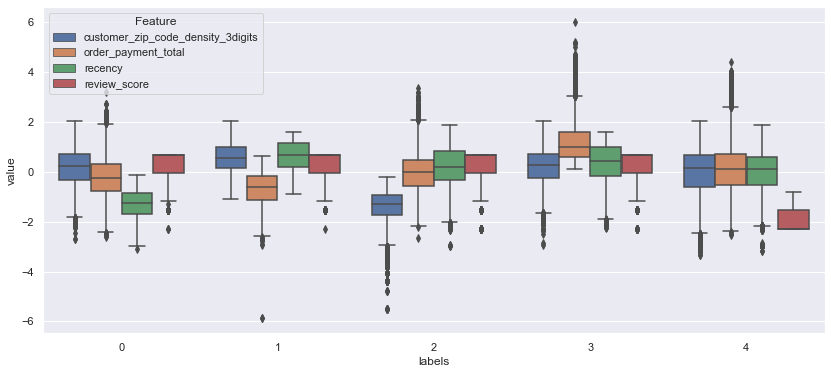

In [63]:
fig, ax = plt.subplots(figsize = (14,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

<AxesSubplot:xlabel='Feature', ylabel='value'>

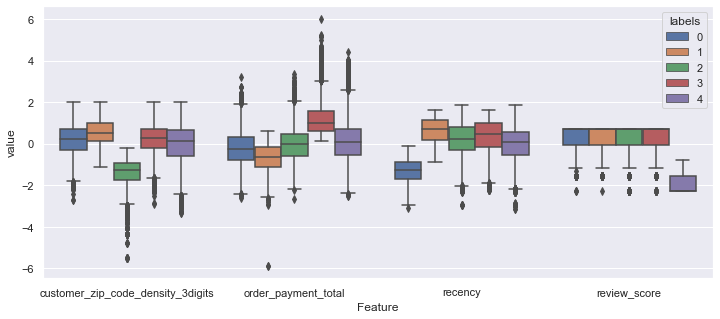

In [65]:
fig, ax = plt.subplots(figsize = (12,5))
sns.boxplot(x="Feature", y="value", hue="labels", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

#### Scatterplots

In [67]:
X_scaled

,customer_zip_code_density_3digits,order_payment_total,recency,review_score
0,-0.138157,0.357231,-1.505408,-0.057397
1,0.620478,1.384383,0.067271,0.689147
2,-0.340884,0.445768,0.893939,0.689147
3,0.492626,0.562666,0.457148,0.689147
4,2.029172,1.029390,1.355099,0.689147
...,...,...,...,...
96084,0.232703,-0.266116,0.620044,-0.057397
96085,1.125515,0.196904,0.598459,0.689147
96086,-0.193055,-0.832794,0.627757,-2.297030
96087,-2.081436,2.320878,-0.388981,0.689147


Text(0, 0.5, 'order_payment_total')

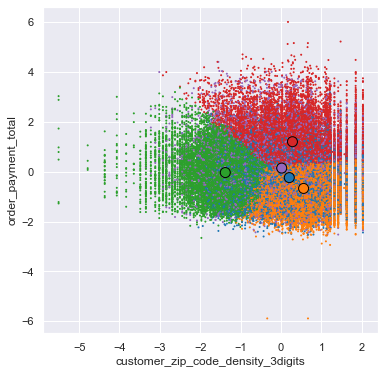

In [87]:
fig, ax = plt.subplots(figsize = (6,6))
plt.scatter(X_scaled['customer_zip_code_density_3digits'], X_scaled['order_payment_total'], c=X_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels))), s=1)
plt.scatter(km.cluster_centers_[:, 0], km.cluster_centers_[:, 1], s=100, c=sns.color_palette('tab10')[:5], edgecolors='black')
plt.xlabel('customer_zip_code_density_3digits')
plt.ylabel('order_payment_total')

Text(0, 0.5, 'recency')

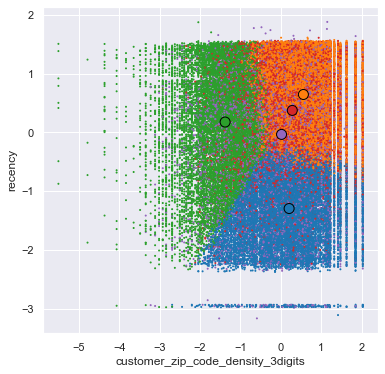

In [88]:
fig, ax = plt.subplots(figsize = (6,6))
plt.scatter(X_scaled['customer_zip_code_density_3digits'], X_scaled['recency'], c=X_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels))), s=1)
plt.scatter(km.cluster_centers_[:, 0], km.cluster_centers_[:, 2], s=100, c=sns.color_palette('tab10')[:5], edgecolors='black')
plt.xlabel('customer_zip_code_density_3digits')
plt.ylabel('recency')

Text(0, 0.5, 'review_score')

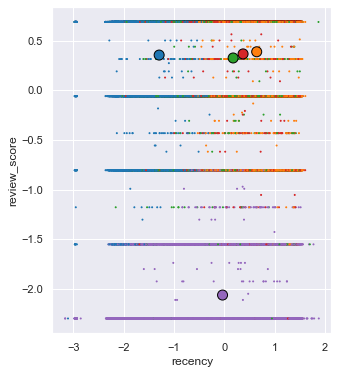

In [91]:
fig, ax = plt.subplots(figsize = (5,6))
plt.scatter(X_scaled['recency'], X_scaled['review_score'], c=X_labels, 
            cmap=ListedColormap(sns.color_palette('tab10'), N=len(set(X_labels))), s=1)
plt.scatter(km.cluster_centers_[:, 2], km.cluster_centers_[:, 3], s=100, c=sns.color_palette('tab10')[:5], edgecolors='black')
plt.xlabel('recency')
plt.ylabel('review_score')

## 7.4 GaussianMixture - Vérsion 2

In [326]:
model_name = "GaussianMixture_2"

### 7.4.1 Evaluation du Modèle

In [327]:
model_dict = test_model(X_reduced, "GaussianMixture")
all_my_models[model_name] = model_dict

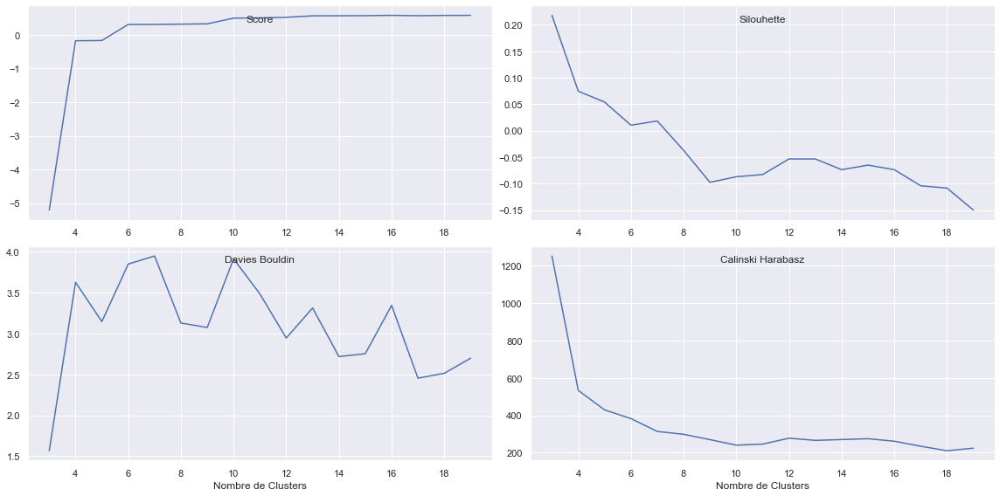

In [328]:
plot_model_evaluation(model_dict)

### 7.4.2 Choisir un Modèle

In [329]:
n_clusters = 3
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
gm.set_params(n_init=10)
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 7.4.3 Visualisation des Clusters en 2-D

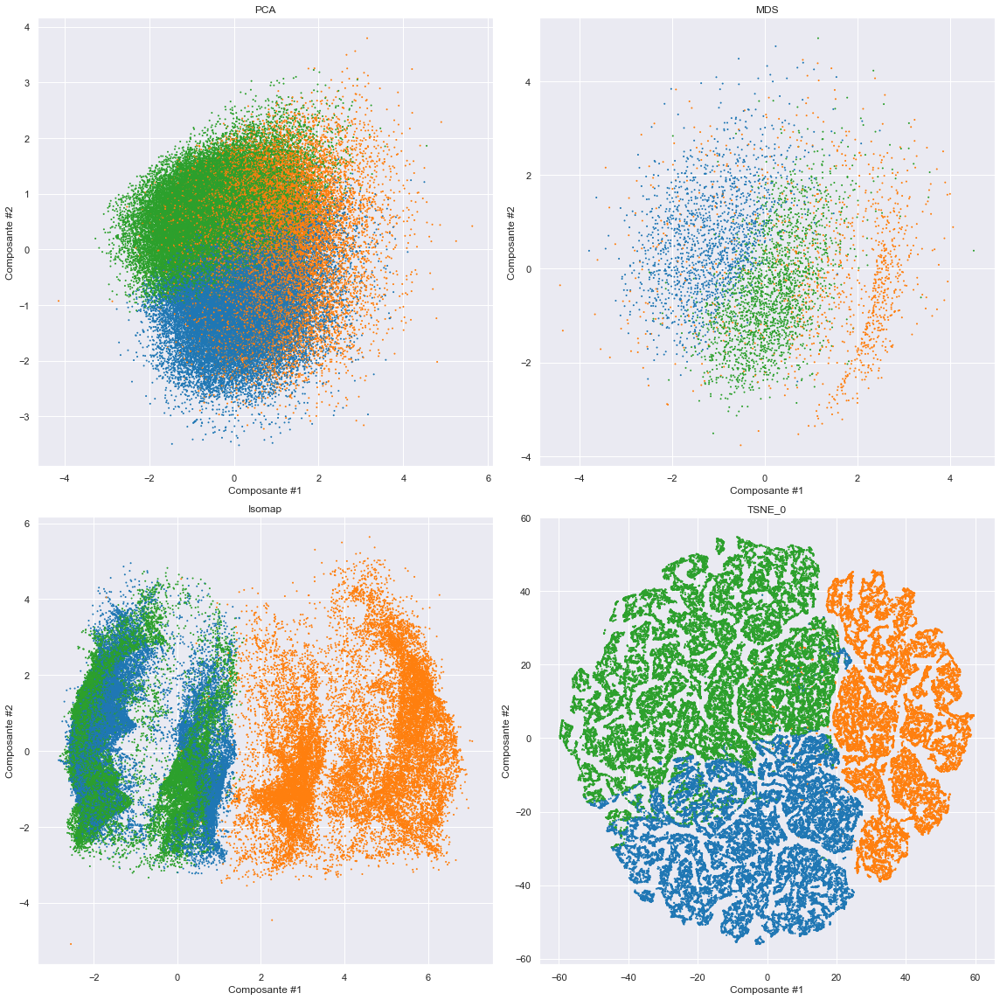

In [330]:
projection_version = "Version2"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [331]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 7.4.4 Distributions des Features par Groupe

In [332]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - resumé

In [333]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,customer_zip_code_density_3digits,order_payment_total,recency,review_score,weights
0,-0.094469,-0.004275,-0.890011,0.507531,0.315101
1,-0.016072,0.067368,-0.049291,-1.399894,0.271958
2,0.082671,-0.041105,0.711600,0.534673,0.412941


#### Tableau - détails

In [334]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0             1  \
customer_zip_code_density_3digits count  31378.000000  22787.000000   
                                  mean      -0.089918     -0.013755   
                                  std        1.034193      1.006067   
                                  min       -5.508351     -5.508351   
                                  25%       -0.773362     -0.659443   
                                  50%        0.031420      0.141475   
                                  75%        0.657063      0.665326   
                                  max        2.029172      2.029172   
order_payment_total               count  31378.000000  22787.000000   
                                  mean      -0.006139      0.090010   
                                  std        0.997232      1.029161   
                                  min       -2.880980     -5.884510   
                                  25%       -0.708094     -0.637156   
                                  50%       -0.067156      0.034444   
                                  75%        0.580245      0.694794   
                                  max        5.163559      6.011733   
recency                           count  31378.000000  22787.000000   
                                  mean      -0.966113     -0.046685   
                                  std        0.626211      0.968844   
                                  min       -2.971724     -3.159611   
                                  25%       -1.444874     -0.658636   
                                  50%       -0.890693      0.105763   
                                  75%       -0.415815      0.653946   
                                  max        0.918898      1.878712   
review_score                      count  31378.000000  22787.000000   
                                  mean       0.482203     -1.609762   
                                  std        0.333326      0.695340   
                                  min       -0.181821     -2.297030   
                                  25%       -0.057397     -2.297030   
                                  50%        0.689147     -1.550486   
                                  75%        0.689147     -0.803942   
                                  max        0.689147     -0.206706   

labels                                              2  
customer_zip_code_density_3digits count  41923.000000  
                                  mean       0.074777  
                                  std        0.964184  
                                  min       -5.508351  
                                  25%       -0.496363  
                                  50%        0.220151  
                                  75%        0.705685  
                                  max        2.029172  
order_payment_total               count  41923.000000  
                                  mean      -0.044329  
                                  std        0.982675  
                                  min       -2.936358  
                                  25%       -0.740065  
                                  50%       -0.079918  
                                  75%        0.549263  
                                  max        4.673832  
recency                           count  41923.000000  
                                  mean       0.748480  
                                  std        0.477844  
                                  min       -0.254655  
                                  25%        0.341197  
                                  50%        0.758173  
                                  75%        1.160143  
                                  max        1.872943  
review_score                      count  41923.000000  
                                  mean       0.514064  
                                  std        0.315067  
                                  min       -0.244034  
                                

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

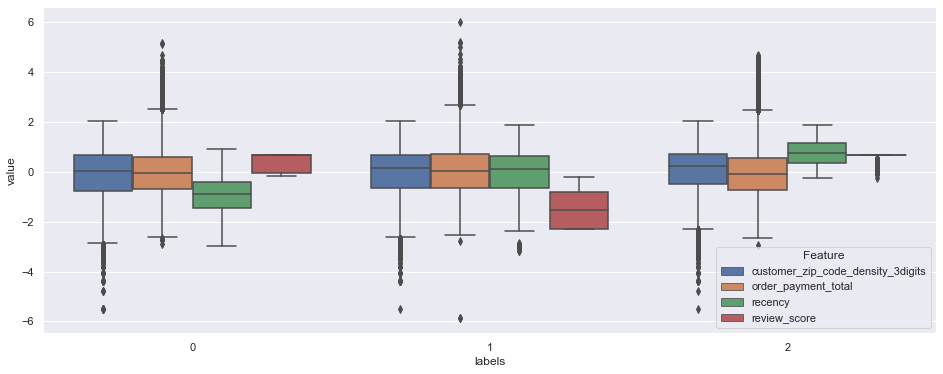

In [335]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

### 7.4.5 Choisir un Modèle - 2

In [336]:
n_clusters = 5
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
gm.set_params(n_init=10)
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 7.4.6 Visualisation des Clusters en 2-D -2

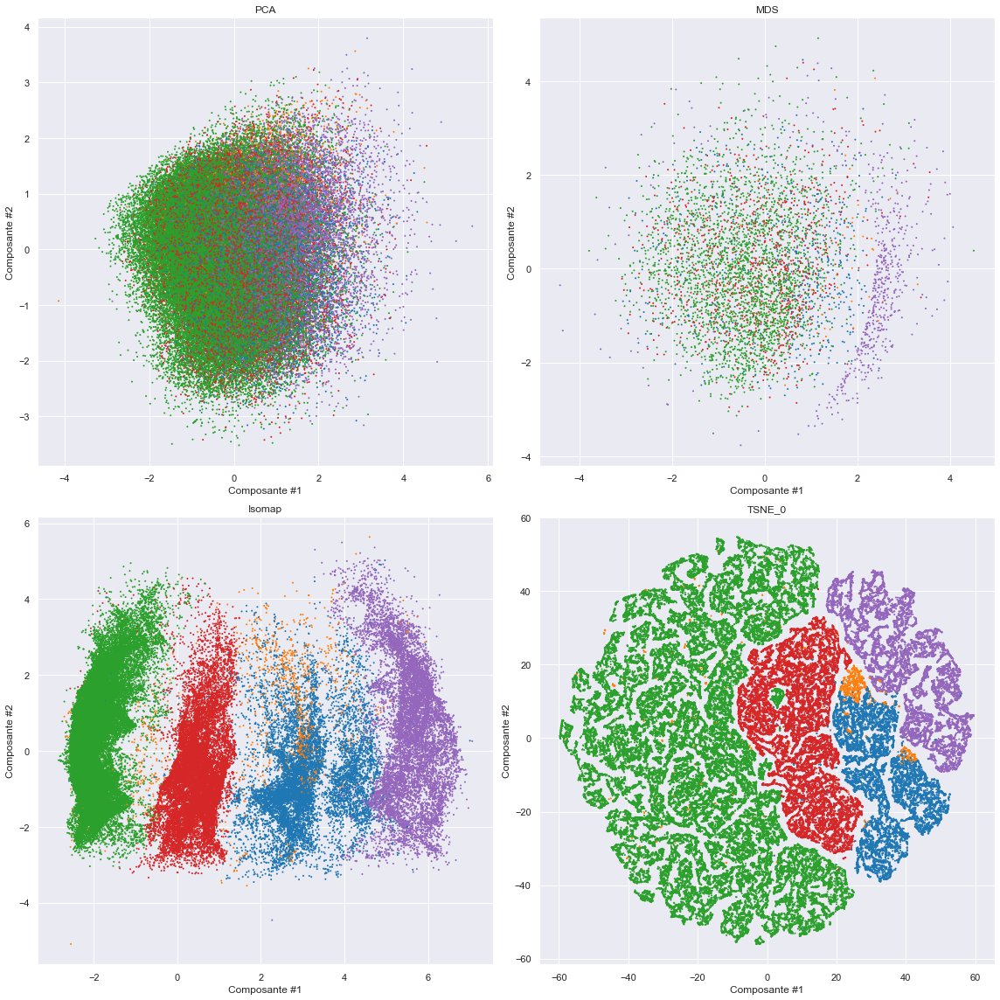

In [337]:
projection_version = "Version2"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [338]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 7.4.7 Distributions des Features par Groupe -2

In [339]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau -résumé

In [340]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,customer_zip_code_density_3digits,order_payment_total,recency,review_score,weights
0,-0.150620,-0.103477,-0.186158,-0.998245,0.100408
1,0.450515,0.393525,0.462170,-0.787710,0.028548
2,0.012722,-0.027255,0.023421,0.689147,0.568010
3,-0.022568,-0.030511,-0.016949,-0.057397,0.190815
4,-0.005858,0.182312,-0.040738,-2.297030,0.112219


#### Tableau -détails

In [341]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0            1  \
customer_zip_code_density_3digits count  10894.000000  1494.000000   
                                  mean      -0.093846     0.538481   
                                  std        1.014248     0.676907   
                                  min       -5.508351    -1.904780   
                                  25%       -0.741035     0.163933   
                                  50%        0.016166     0.608956   
                                  75%        0.620478     1.050626   
                                  max        2.029172     2.029172   
order_payment_total               count  10894.000000  1494.000000   
                                  mean      -0.136235     1.047538   
                                  std        0.865338     1.171040   
                                  min       -2.519897    -5.884510   
                                  25%       -0.759688     0.420948   
                                  50%       -0.145758     1.067581   
                                  75%        0.441541     1.769593   
                                  max        3.651798     5.162278   
recency                           count  10894.000000  1494.000000   
                                  mean      -0.126794     0.570435   
                                  std        0.983550     0.673790   
                                  min       -2.970562    -1.995107   
                                  25%       -0.845679     0.150351   
                                  50%        0.001270     0.673056   
                                  75%        0.617772     1.109744   
                                  max        1.773861     1.609604   
review_score                      count  10894.000000  1494.000000   
                                  mean      -0.995306    -0.634971   
                                  std        0.346558     0.584052   
                                  min       -2.110394    -2.110394   
                                  25%       -1.550486    -0.803942   
                                  50%       -0.803942    -0.803942   
                                  75%       -0.803942    -0.430670   
                                  max        0.502511     0.564723   

labels                                              2             3  \
customer_zip_code_density_3digits count  5.457900e+04  1.833800e+04   
                                  mean   1.272177e-02 -2.253935e-02   
                                  std    9.940009e-01  1.010275e+00   
                                  min   -5.508351e+00 -5.508351e+00   
                                  25%   -6.304240e-01 -6.892947e-01   
                                  50%    1.727823e-01  1.277636e-01   
                                  75%    6.897289e-01  6.653264e-01   
                                  max    2.029172e+00  2.029172e+00   
order_payment_total               count  5.457900e+04  1.833800e+04   
                                  mean  -2.725516e-02 -3.049465e-02   
                                  std    9.928136e-01  9.806854e-01   
                                  min   -2.936358e+00 -2.653588e+00   
                                  25%   -7.264135e-01 -7.089864e-01   
                                  50%   -7.477367e-02 -7.842029e-02   
                                  75%    5.637407e-01  5.544324e-01   
                                  max    5.163559e+00  4.695665e+00   
recency                           count  5.457900e+04  1.833800e+04   
                                  mean   2.342180e-02 -1.690554e-02   
                                  std    1.013262e+00  9.976743e-01   
                                  min   -2.970209e+00 -2.971724e+00   
                                  25%   -7.241899e-01 -7.299511e-01   
                                  50%    1.378200e-01  9.797233e-02   
                                  75%    8.599007e-01  7

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

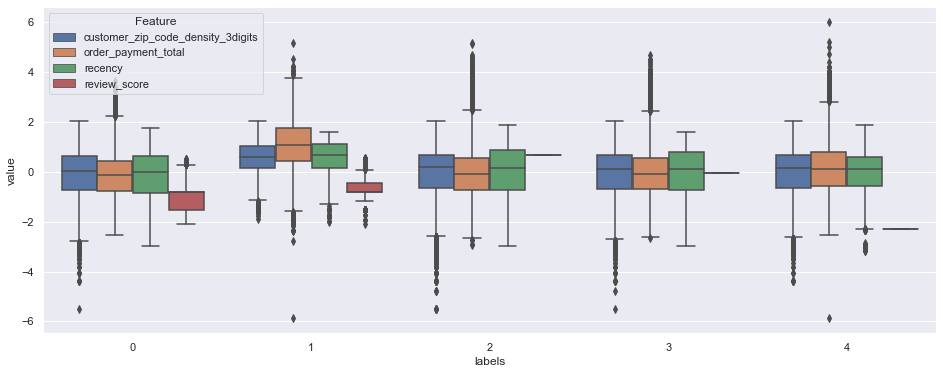

In [342]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

## 7.5 BIRCH - Vérsion 2

In [343]:
model_name = "BIRCH_2"

### 7.5.1 Evaluation du Modèle

In [344]:
model_dict = test_model(X_reduced, "Birch")
all_my_models[model_name] = model_dict

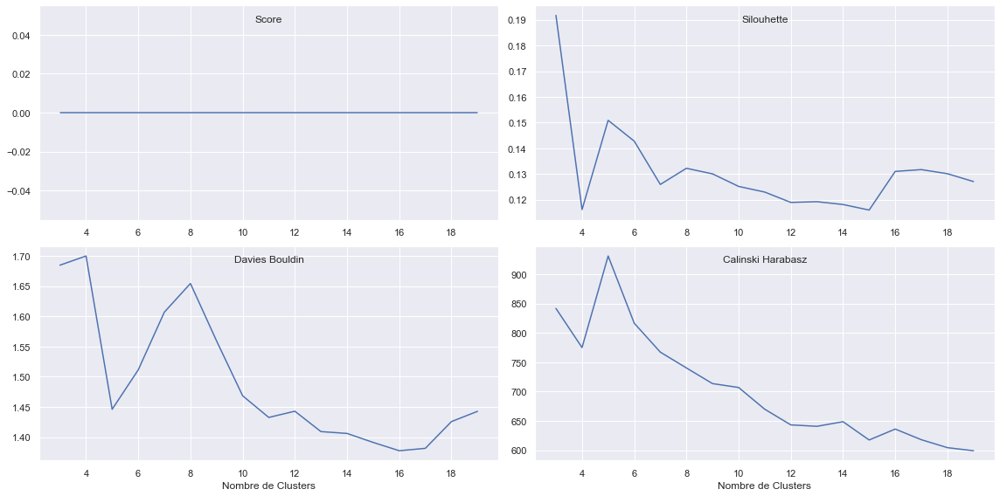

In [345]:
plot_model_evaluation(model_dict)

### 7.5.2 Choisir un Modèle

In [346]:
n_clusters = 5
bm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = bm.fit_predict(X_scaled)
X_labels_reduced = bm.predict(X_reduced.astype(float))

### 7.5.3 Visualisation des Clusters en 2-D

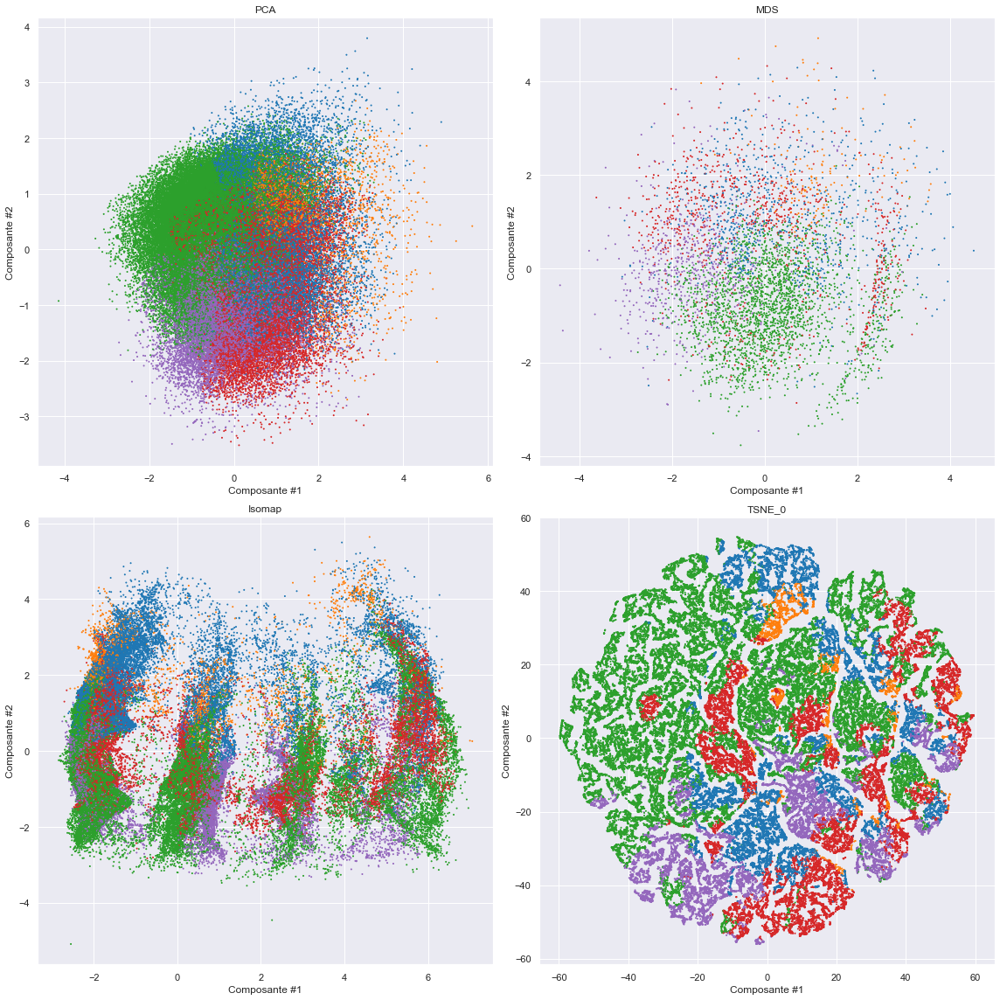

In [347]:
projection_version = "Version2"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [348]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 7.5.4 Distributions des Features par Groupe

In [349]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau

In [350]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0            1  \
customer_zip_code_density_3digits count  16243.000000  3108.000000   
                                  mean       0.064768    -1.695860   
                                  std        0.771470     0.801605   
                                  min       -3.015089    -5.508351   
                                  25%       -0.400315    -2.161458   
                                  50%        0.127764    -1.573661   
                                  75%        0.549354    -1.121030   
                                  max        2.029172    -0.231333   
order_payment_total               count  16243.000000  3108.000000   
                                  mean       1.289402     1.195830   
                                  std        0.839125     0.773534   
                                  min       -0.488164    -1.303596   
                                  25%        0.689334     0.701258   
                                  50%        1.170483     1.088732   
                                  75%        1.769597     1.598632   
                                  max        6.011733     4.536640   
recency                           count  16243.000000  3108.000000   
                                  mean      -0.364134     0.419687   
                                  std        0.978071     0.907749   
                                  min       -2.966621    -2.967019   
                                  25%       -1.047042     0.116779   
                                  50%       -0.430522     0.598938   
                                  75%        0.288688     1.084857   
                                  max        1.609604     1.872943   
review_score                      count  16243.000000  3108.000000   
                                  mean       0.042104    -0.040984   
                                  std        1.037100     1.017478   
                                  min       -2.297030    -2.297030   
                                  25%       -0.057397    -0.057397   
                                  50%        0.689147     0.689147   
                                  75%        0.689147     0.689147   
                                  max        0.689147     0.689147   

labels                                              2             3  \
customer_zip_code_density_3digits count  45624.000000  18044.000000   
                                  mean       0.368131     -1.135660   
                                  std        0.756866      0.745165   
                                  min       -2.161458     -4.787637   
                                  25%       -0.174432     -1.622031   
                                  50%        0.372585     -1.136434   
                                  75%        0.855356     -0.620928   
                                  max        2.029172      0.936647   
order_payment_total               count  45624.000000  18044.000000   
                                  mean      -0.280677     -0.359152   
                                  std        0.806375      0.692152   
                                  min       -5.884510     -2.653588   
                                  25%       -0.886495     -0.855781   
                                  50%       -0.250490     -0.397615   
                                  75%        0.339791      0.158771   
                                  max        2.561600      1.763554   
recency                           count  45624.000000  18044.000000   
                                  mean       0.544575     -0.263390   
                                  std        0.617937      1.042716   
                                  min       -1.466894     -2.971724   
                                  25%        0.098804     -1.127740   
                                  50%        0.582020     -0.182538   
                                  75%        1.051759   

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

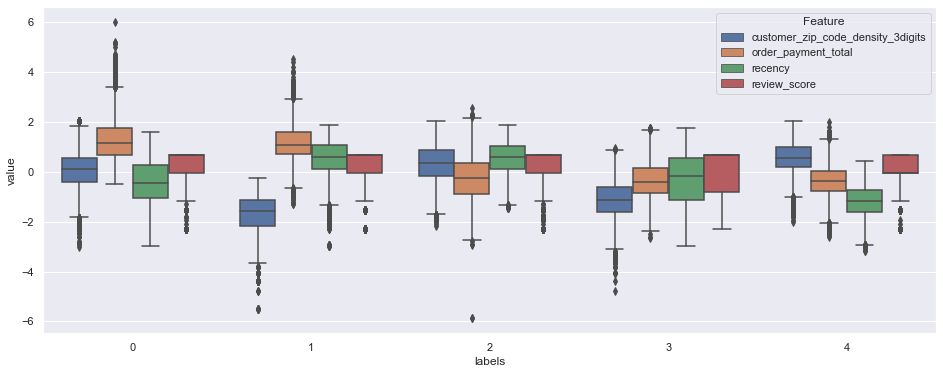

In [351]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

# 7b. Modèles - Vérsion 2b

## 7b.1 Sélection des Features

In [479]:
passthrough_features = []
standardscale_features = ['recency', 'review_score', 'order_payment_total', 'customer_zip_code_density_3digits']
log1pscale_features = []
logscale_features = []
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [480]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)

X_reduced = X_scaled.sample(frac=0.05, random_state=seed).astype(np.float32)
all_components = len(X_scaled.columns)

## 7b.2  Créations des Projections

In [481]:
projection_version = "Version2b"

In [482]:
all_my_projections[projection_version] = {}

#### PCA

In [483]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

In [484]:
all_my_projections[projection_version]["PCA"] = {"X_proj" : X_pca, "model": pca}

#### MDS

In [485]:
mds = MDS(n_components=2)
X_reduced_mds = mds.fit_transform(X_reduced)

In [486]:
all_my_projections[projection_version]["MDS"] = {"X_proj" : X_reduced_mds, "model": mds}

#### Isomap

In [487]:
iso = Isomap(n_components=2)
X_reduced_iso = iso.fit_transform(X_reduced)
X_iso = iso.transform(X_scaled)

In [488]:
all_my_projections[projection_version]["Isomap"] = {"X_proj" : X_iso, "model": iso}

#### t_SNE

In [489]:
tsne = TSNE(n_components=2, init='pca')
X_tsne0 = tsne.fit_transform(X_scaled)

In [490]:
all_my_projections[projection_version]["TSNE_0"] = {"X_proj" : X_tsne0, "model": tsne}

## -- BREAK Store/Reload Data --

In [491]:
dill.dump_session('notebook_env.db')

In [492]:
dill.load_session('notebook_env.db')

## 7b.3 K-Means - Vérsion 2b

In [493]:
model_name = "KMeans_2b"

### 7b.3.1 Evaluation du Modèle

In [494]:
model_dict = test_model(X_reduced)
all_my_models[model_name] = model_dict

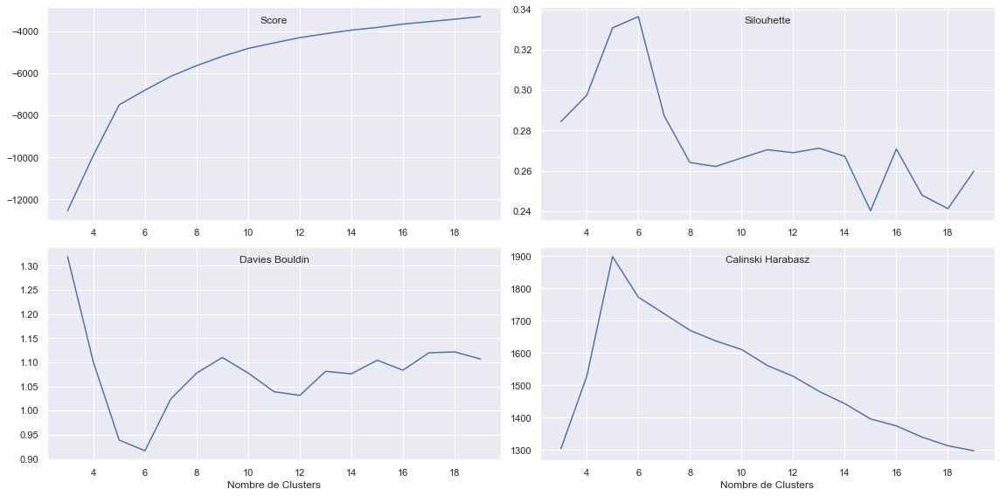

In [495]:
plot_model_evaluation(model_dict)

### 7b.3.2 Choisir un Modèle

In [496]:
n_clusters = 5
km = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = km.fit_predict(X_scaled)
X_labels_reduced = km.predict(X_reduced.astype(float))

### 7b.3.3 Visualisation des Clusters en 2-D

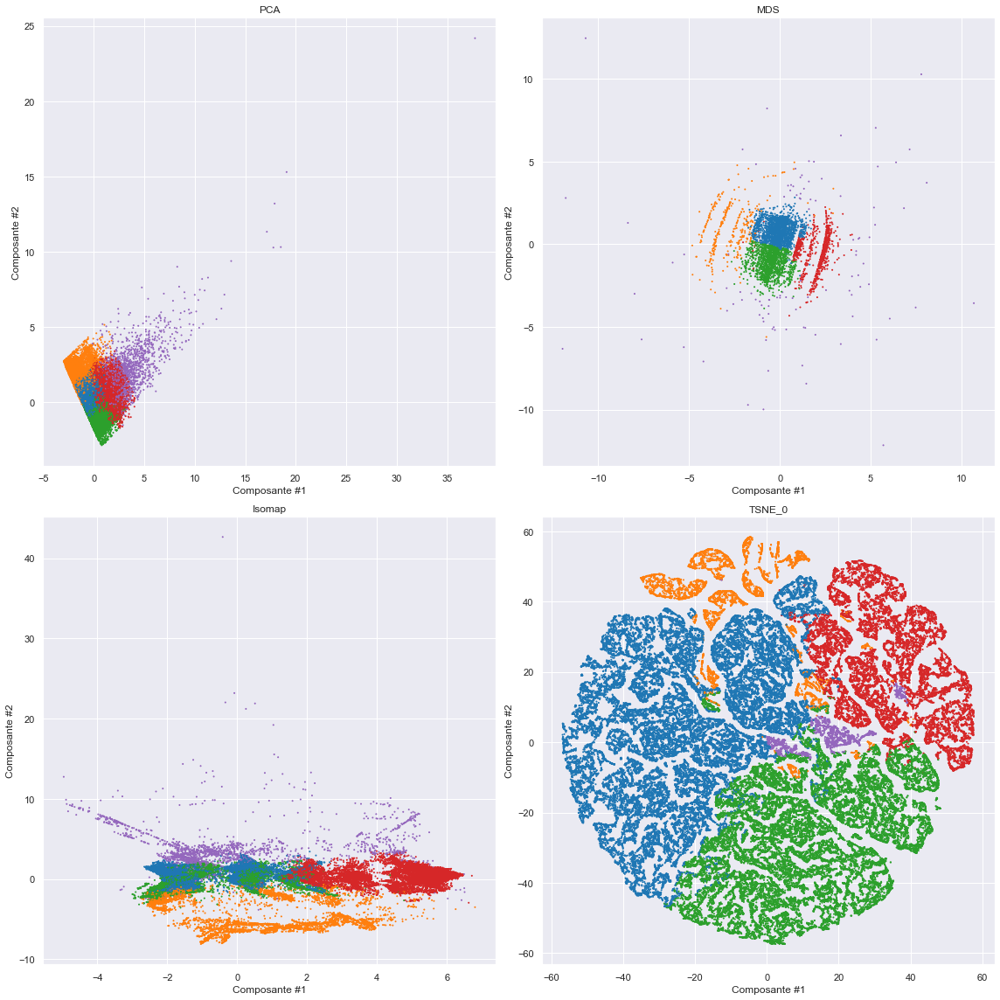

In [497]:
projection_version = "Version2b"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

### 7b.3.4 Distributions des Features par Groupe

In [498]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - resumé

In [499]:
pd.DataFrame(km.cluster_centers_, columns=X_scaled.columns).merge(
    pd.Series(km.labels_, name="fraction").value_counts(normalize=True).sort_index(),
    right_index=True, left_index=True)

,recency,review_score,order_payment_total,customer_zip_code_density_3digits,fraction
0,0.764790,0.440775,-0.126255,-0.184346,0.420979
1,0.025527,0.039063,-0.121612,2.787751,0.069270
2,-1.016985,0.408490,-0.122578,-0.242411,0.315024
3,-0.020758,-1.820733,-0.038344,-0.206399,0.172821
4,-0.005022,-0.092854,4.882530,-0.140147,0.021907


#### Tableau - détails

In [500]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0            1  \
recency                           count  40451.000000  6656.000000   
                                  mean       0.765236     0.025724   
                                  std        0.474723     0.942773   
                                  min       -0.174867    -2.970615   
                                  25%        0.360075    -0.571545   
                                  50%        0.784477     0.092881   
                                  75%        1.181060     0.781380   
                                  max        1.872943     1.637597   
review_score                      count  40451.000000  6656.000000   
                                  mean       0.440616     0.038313   
                                  std        0.422050     0.928230   
                                  min       -0.803942    -2.297030   
                                  25%       -0.057397    -0.057397   
                                  50%        0.689147     0.689147   
                                  75%        0.689147     0.689147   
                                  max        0.689147     0.689147   
order_payment_total               count  40451.000000  6656.000000   
                                  mean      -0.126237    -0.121501   
                                  std        0.485192     0.551599   
                                  min       -0.726021    -0.664037   
                                  25%       -0.451590    -0.466940   
                                  50%       -0.263028    -0.290242   
                                  75%        0.029306     0.016458   
                                  max        2.557981     3.582297   
customer_zip_code_density_3digits count  40451.000000  6656.000000   
                                  mean      -0.184570     2.784869   
                                  std        0.617990     0.910270   
                                  min       -1.087434     1.146372   
                                  25%       -0.703556     1.928753   
                                  50%       -0.279462     3.230284   
                                  75%        0.236032     3.244908   
                                  max        1.515627     4.052880   

labels                                              2             3  \
recency                           count  30270.000000  16606.000000   
                                  mean      -1.016394     -0.020882   
                                  std        0.619070      0.861743   
                                  min       -2.971724     -3.159611   
                                  25%       -1.485989     -0.422880   
                                  50%       -0.952012      0.107057   
                                  75%       -0.474274      0.516992   
                                  max       -0.095046      1.878712   
review_score                      count  30270.000000  16606.000000   
                                  mean       0.408484     -1.821590   
                                  std        0.453003      0.623092   
                                  min       -1.550486     -2.297030   
                                  25%       -0.057397     -2.297030   
                                  50%        0.689147     -2.297030   
                                  75%        0.689147     -1.550486   
                                  max        0.689147     -0.617306   
order_payment_total               count  30270.000000  16606.000000   
                                  mean      -0.122874     -0.038297   
                                  std        0.503139      0.579245   
                                  min       -0.680725     -0.726021   
                                  25%       -0.451635     -0.428694   
                                  50%       -0.272406     -0.215033   
                                  75%        0.019365   

#### Boxplots

(-5.0, 15.0)

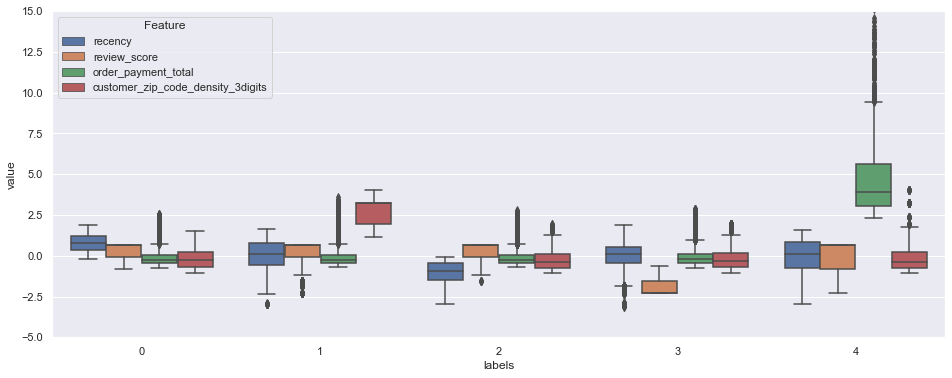

In [502]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5,15)

## 7b.4 GaussianMixture - Vérsion 2b

In [503]:
model_name = "GaussianMixture_2b"

### 7b.4.1 Evaluation du Modèle

In [504]:
model_dict = test_model(X_reduced, "GaussianMixture")
all_my_models[model_name] = model_dict

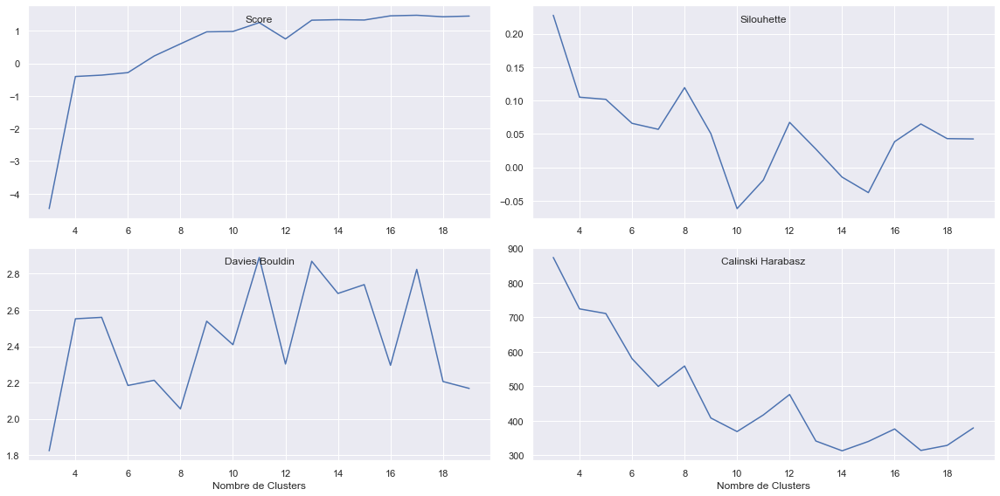

In [505]:
plot_model_evaluation(model_dict)

### 7b.4.2 Choisir un Modèle

In [506]:
n_clusters = 3
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
gm.set_params(n_init=10)
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 7b.4.3 Visualisation des Clusters en 2-D

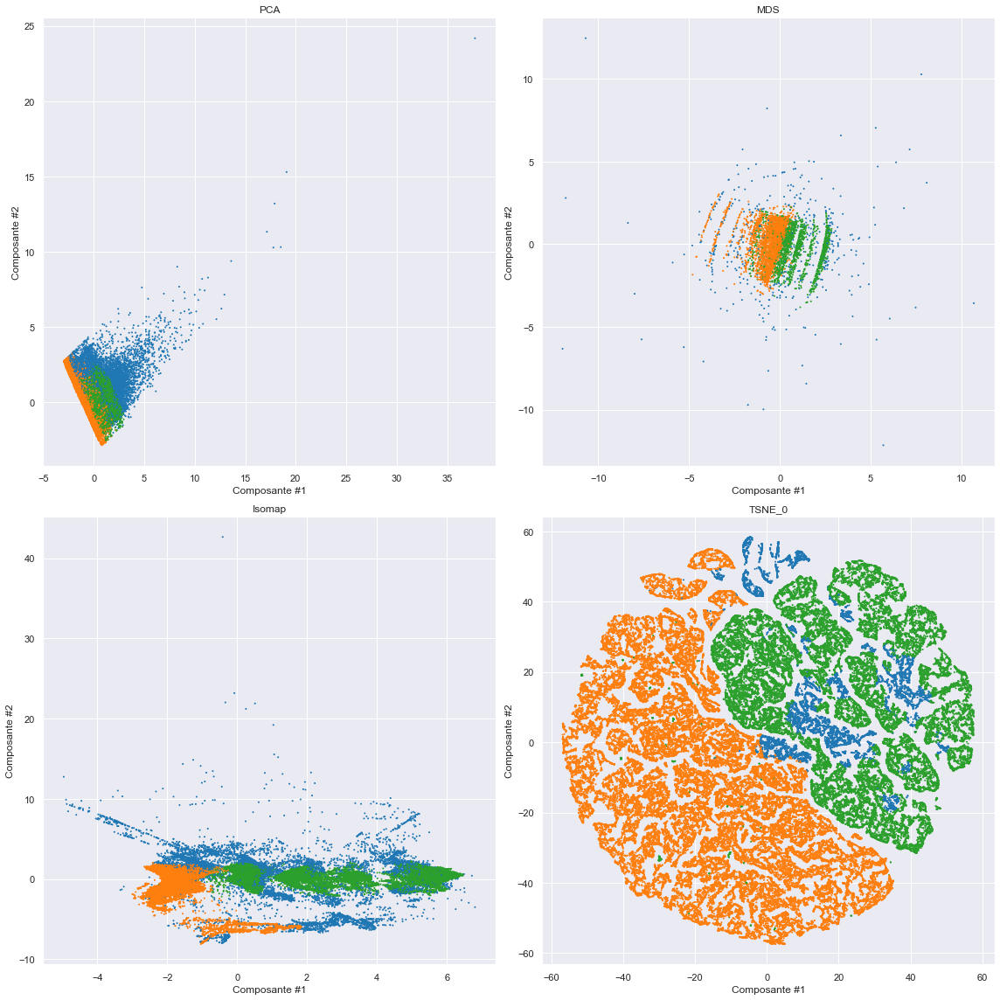

In [510]:
projection_version = "Version2b"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [508]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 7b.4.4 Distributions des Features par Groupe

In [511]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - resumé

In [512]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,recency,review_score,order_payment_total,customer_zip_code_density_3digits,weights
0,-0.050573,-0.702435,1.512104,0.822677,0.104466
1,0.025698,0.689147,-0.148396,0.004085,0.549719
2,-0.025574,-0.883295,-0.220890,-0.255013,0.345815


#### Tableau - détails

In [513]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                             0             1  \
recency                           count  9014.000000  5.286000e+04   
                                  mean     -0.052917  2.613021e-02   
                                  std       1.003911  1.011545e+00   
                                  min      -3.102527 -2.970209e+00   
                                  25%      -0.742395 -7.213382e-01   
                                  50%       0.073666  1.391873e-01   
                                  75%       0.747642  8.600479e-01   
                                  max       1.655003  1.872943e+00   
review_score                      count  9014.000000  5.286000e+04   
                                  mean     -0.677375  6.891468e-01   
                                  std       1.092326  1.110234e-16   
                                  min      -2.297030  6.891468e-01   
                                  25%      -1.550486  6.891468e-01   
                                  50%      -0.057397  6.891468e-01   
                                  75%      -0.057397  6.891468e-01   
                                  max       0.689147  6.891468e-01   
order_payment_total               count  9014.000000  5.286000e+04   
                                  mean      1.701787 -1.479643e-01   
                                  std       2.443833  4.411754e-01   
                                  min      -0.664037 -6.828842e-01   
                                  25%       0.071555 -4.566503e-01   
                                  50%       1.070671 -2.746780e-01   
                                  75%       2.468681  1.454111e-02   
                                  max      60.736923  2.009747e+00   
customer_zip_code_density_3digits count  9014.000000  5.286000e+04   
                                  mean      0.879521  4.453043e-03   
                                  std       1.624180  9.837500e-01   
                                  min      -1.087434 -1.087434e+00   
                                  25%      -0.542692 -6.889319e-01   
                                  50%       0.298184 -2.282778e-01   
                                  75%       1.928753  3.274318e-01   
                                  max       4.052880  4.052880e+00   

labels                                              2  
recency                           count  34214.000000  
                                  mean      -0.026429  
                                  std        0.979618  
                                  min       -3.159611  
                                  25%       -0.688721  
                                  50%        0.110702  
                                  75%        0.729263  
                                  max        1.878712  
review_score                      count  34214.000000  
                                  mean      -0.886258  
                                  std        0.924154  
                                  min       -2.297030  
                                  25%       -1.923758  
                                  50%       -0.803942  
                                  75%       -0.057397  
                                  max        0.564723  
order_payment_total               count  34214.000000  
                                  mean      -0.219750  
                                  std        0.298893  
                                  min       -0.726021  
                                  25%       -0.455683  
                                  50%       -0.287442  
                                  75%       -0.039065  
                                  max        0.750043  
customer_zip_code_density_3digits count  34214.000000  
                                  mean      -0.238598  
                                  std        0.598016  
                                  min       -1.087434  
                                  25%       -0.725492  
         

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

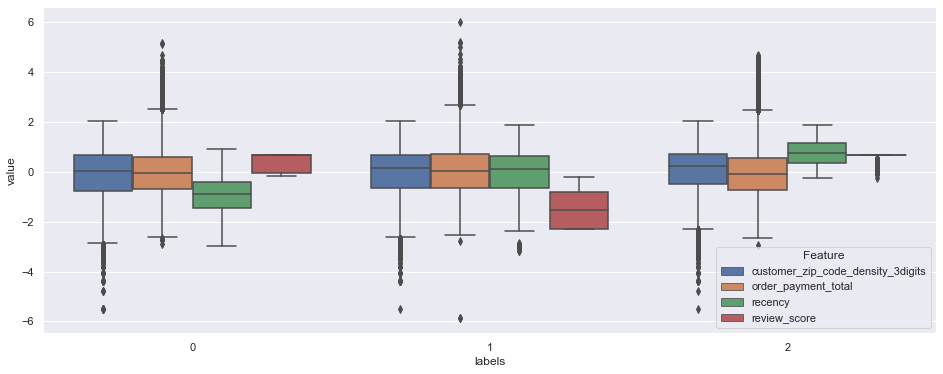

In [335]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

### 7b.4.5 Choisir un Modèle - 2

In [514]:
n_clusters = 8
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
gm.set_params(n_init=10)
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 7b.4.6 Visualisation des Clusters en 2-D -2

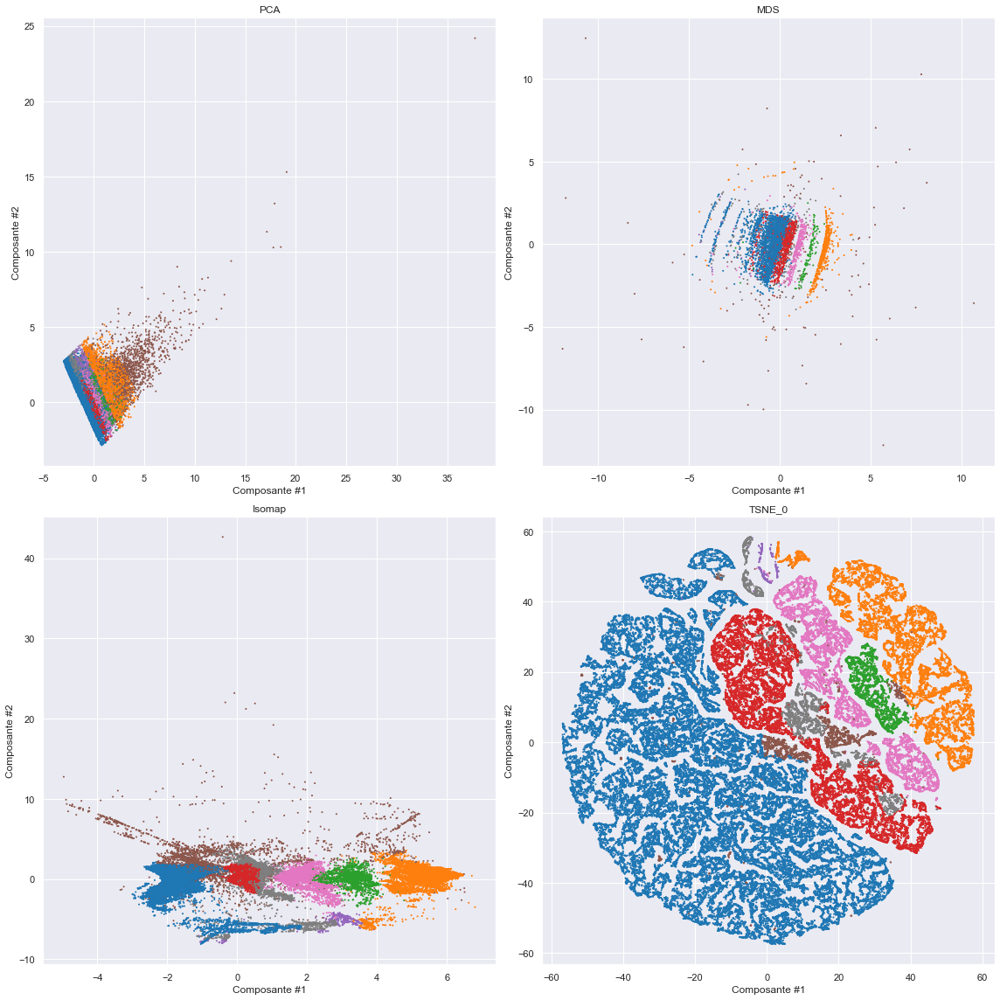

In [515]:
projection_version = "Version2b"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [338]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 7b.4.7 Distributions des Features par Groupe -2

In [516]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau -résumé

In [517]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,recency,review_score,order_payment_total,customer_zip_code_density_3digits,weights
0,0.025460,0.689147,-0.140827,0.006653,0.551918
1,-0.040335,-2.297030,-0.001021,0.011410,0.109259
2,-0.046821,-1.550486,-0.112840,-0.141790,0.029210
3,-0.007340,-0.057397,-0.264416,-0.281984,0.146454
4,-0.126966,-0.987711,-0.210333,3.586676,0.004068
5,0.007627,-0.043443,3.451435,-0.059905,0.032076
6,-0.056329,-0.803942,-0.139424,-0.135061,0.084365
7,-0.051078,-0.057397,0.510363,0.920197,0.042649


#### Tableau -détails

In [518]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0             1  \
recency                           count  5.305600e+04  1.050400e+04   
                                  mean   2.556380e-02 -4.096996e-02   
                                  std    1.011588e+00  9.563319e-01   
                                  min   -2.970209e+00 -3.159611e+00   
                                  25%   -7.216290e-01 -5.542384e-01   
                                  50%    1.388545e-01  1.324348e-01   
                                  75%    8.597150e-01  5.948303e-01   
                                  max    1.872943e+00  1.878712e+00   
review_score                      count  5.305600e+04  1.050400e+04   
                                  mean   6.891468e-01 -2.297030e+00   
                                  std    2.220467e-16  8.882207e-16   
                                  min    6.891468e-01 -2.297030e+00   
                                  25%    6.891468e-01 -2.297030e+00   
                                  50%    6.891468e-01 -2.297030e+00   
                                  75%    6.891468e-01 -2.297030e+00   
                                  max    6.891468e-01 -2.297030e+00   
order_payment_total               count  5.305600e+04  1.050400e+04   
                                  mean  -1.401388e-01  1.161259e-04   
                                  std    4.588611e-01  6.340887e-01   
                                  min   -6.828842e-01 -7.260214e-01   
                                  25%   -4.561330e-01 -4.171791e-01   
                                  50%   -2.725189e-01 -1.995591e-01   
                                  75%    1.873562e-02  1.642505e-01   
                                  max    2.111945e+00  3.204723e+00   
customer_zip_code_density_3digits count  5.305600e+04  1.050400e+04   
                                  mean   6.556952e-03  1.190165e-02   
                                  std    9.871626e-01  1.035456e+00   
                                  min   -1.087434e+00 -1.080122e+00   
                                  25%   -6.889319e-01 -6.998998e-01   
                                  50%   -2.282778e-01 -2.465577e-01   
                                  75%    3.274318e-01  2.945280e-01   
                                  max    4.052880e+00  4.052880e+00   

labels                                             2             3  \
recency                           count  2802.000000  1.450700e+04   
                                  mean     -0.046634 -4.182130e-03   
                                  std       0.974650  9.909511e-01   
                                  min      -2.967066 -2.971724e+00   
                                  25%      -0.709630 -7.157046e-01   
                                  50%       0.091256  1.129127e-01   
                                  75%       0.690883  7.961975e-01   
                                  max       1.773861  1.611766e+00   
review_score                      count  2802.000000  1.450700e+04   
                                  mean     -1.550486 -5.739745e-02   
                                  std       0.000000  2.081740e-17   
                                  min      -1.550486 -5.739745e-02   
                                  25%      -1.550486 -5.739745e-02   
                                  50%      -1.550486 -5.739745e-02   
                                  75%      -1.550486 -5.739745e-02   
                                  max      -1.550486 -5.739745e-02   
order_payment_total               count  2802.000000  1.450700e+04   
                                  mean     -0.110871 -2.648915e-01   
                                  std       0.460981  2.550509e-01   
                                  min      -0.661743 -6.707843e-01   
                                  25%      -0.441492 -4.698074e-01   
                                  50%      -0.246092 -3.201992e-01   
                                  75%       0.

#### Boxplots

(-5.0, 15.0)

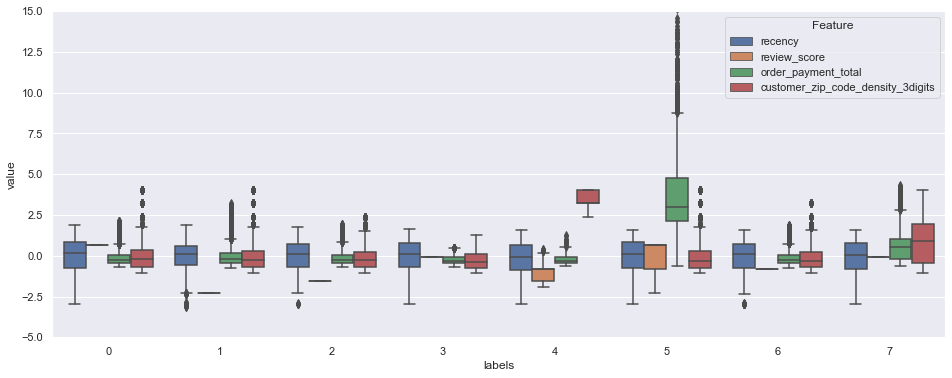

In [520]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5, 15)

## 7b.5 BIRCH - Vérsion 2b

In [521]:
model_name = "BIRCH_2b"

### 7.5.1 Evaluation du Modèle

In [522]:
model_dict = test_model(X_reduced, "Birch")
all_my_models[model_name] = model_dict

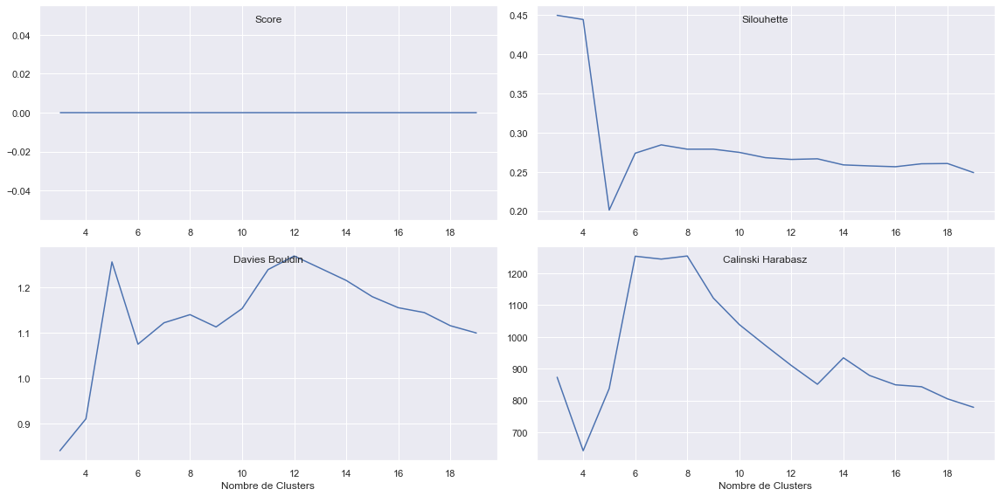

In [523]:
plot_model_evaluation(model_dict)

### 7b.5.2 Choisir un Modèle

In [530]:
n_clusters = 6
bm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = bm.fit_predict(X_scaled)
X_labels_reduced = bm.predict(X_reduced.astype(float))

### 7b.5.3 Visualisation des Clusters en 2-D

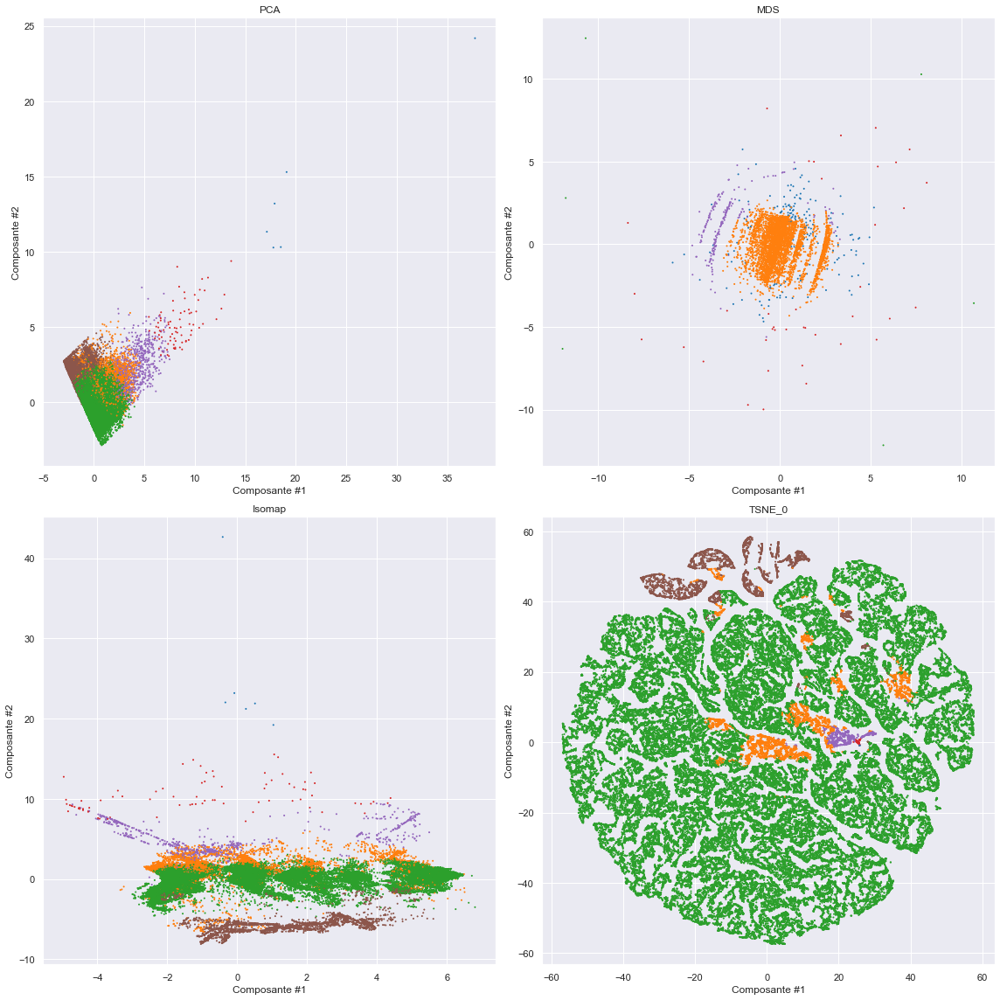

In [531]:
projection_version = "Version2b"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [532]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 7b.5.4 Distributions des Features par Groupe

In [533]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau

In [534]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                           0            1             2  \
recency                           count   6.000000  4147.000000  87150.000000   
                                  mean   -0.306609     0.493320     -0.025473   
                                  std     1.401359     0.808830      1.002122   
                                  min    -2.110190    -2.964532     -3.159611   
                                  25%    -1.243976     0.084997     -0.740058   
                                  50%    -0.436763     0.673367      0.092583   
                                  75%     0.885181     1.120563      0.784736   
                                  max     1.331280     1.563815      1.878712   
review_score                      count   6.000000  4147.000000  87150.000000   
                                  mean   -1.052790    -0.074994      0.013652   
                                  std     1.467993     1.020812      0.989638   
                                  min    -2.297030    -2.297030     -2.297030   
                                  25%    -2.297030    -0.803942     -0.057397   
                                  50%    -1.550486     0.689147      0.689147   
                                  75%     0.315875     0.689147      0.689147   
                                  max     0.689147     0.689147      0.689147   
order_payment_total               count   6.000000  4147.000000  87150.000000   
                                  mean   34.958233     2.080495     -0.158802   
                                  std    12.752945     1.075134      0.420961   
                                  min    26.629597     0.043700     -0.726021   
                                  25%    29.751340     1.203096     -0.452759   
                                  50%    30.427016     1.967060     -0.273171   
                                  75%    31.608801     2.787138      0.008480   
                                  max    60.736923     6.643506      3.148047   
customer_zip_code_density_3digits count   6.000000  4147.000000  87150.000000   
                                  mean    0.323776    -0.047921     -0.149071   
                                  std     0.821697     1.070051      0.698093   
                                  min    -0.235590    -1.087434     -1.087434   
                                  25%    -0.196288    -0.791299     -0.707212   
                                  50%     0.091621    -0.451293     -0.279462   
                                  75%     0.291786     0.298184      0.254312   
                                  max     1.928753     4.052880      3.244908   

labels                                           3           4            5  
recency                           count  79.000000  737.000000  3969.000000  
                                  mean   -0.149108   -0.156278     0.076338  
                                  std     1.220286    1.022860     0.985167  
                                  min    -2.189398   -2.959412    -2.970615  
                                  25%    -1.384802   -0.815307    -0.553660  
                                  50%     0.156829   -0.177142     0.208544  
                                  75%     0.935746    0.691960     0.867542  
                                  max     1.481748    1.609604     1.637597  
review_score                      count  79.000000  737.000000  3969.000000  
                                  mean   -0.246396   -0.124252    -0.191837  
                                  std     1.155728    1.176724     1.130678  
                                  min    -2.297030   -2.297030    -2.297030  
                                  25%    -0.803942   -0.803942    -0.803942  
                                  50%    -0.057397    0.689147     0.689147  
                                  75%     0.689147    0.689147     0.689147  
                                  max     0.689147    0.689147     0.689147  


#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

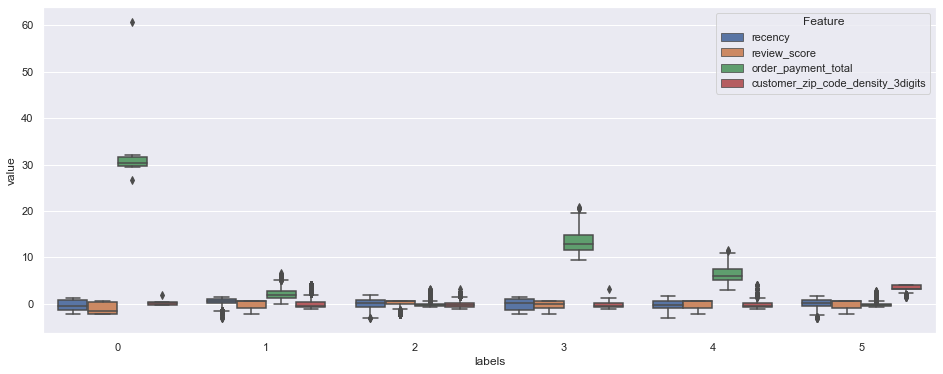

In [535]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

# 8. Modèles - Vérsion 3

## 8.1 Sélection des Features

In [352]:
passthrough_features = []
standardscale_features = ['recency', 'review_score', 'online_timeofday']
log1pscale_features = ['order_payment_total']
logscale_features = ['customer_zip_code_density_3digits']
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [353]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)

X_reduced = X_scaled.sample(frac=0.05, random_state=seed).astype(np.float32)
all_components = len(X_scaled.columns)

## 8.2  Créations des Projections

In [354]:
projection_version = "Version3"

In [355]:
all_my_projections[projection_version] = {}

#### PCA

In [356]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

In [357]:
all_my_projections[projection_version]["PCA"] = {"X_proj" : X_pca, "model": pca}

#### MDS

In [358]:
mds = MDS(n_components=2)
X_reduced_mds = mds.fit_transform(X_reduced)

In [359]:
all_my_projections[projection_version]["MDS"] = {"X_proj" : X_reduced_mds, "model": mds}

#### Isomap

In [360]:
iso = Isomap(n_components=2)
X_reduced_iso = iso.fit_transform(X_reduced)
X_iso = iso.transform(X_scaled)

In [361]:
all_my_projections[projection_version]["Isomap"] = {"X_proj" : X_iso, "model": iso}

#### t_SNE

In [362]:
tsne = TSNE(n_components=2, init='pca')
X_tsne0 = tsne.fit_transform(X_scaled)

In [363]:
all_my_projections[projection_version]["TSNE_0"] = {"X_proj" : X_tsne0, "model": tsne}

## -- BREAK Store/Reload Data --

In [364]:
dill.dump_session('notebook_env.db')

In [365]:
dill.load_session('notebook_env.db')

## 8.3 K-Means - Vérsion 3

In [366]:
model_name = "KMeans_3"

### 8.3.1 Evaluation du Modèle

In [367]:
model_dict = test_model(X_reduced)
all_my_models[model_name] = model_dict

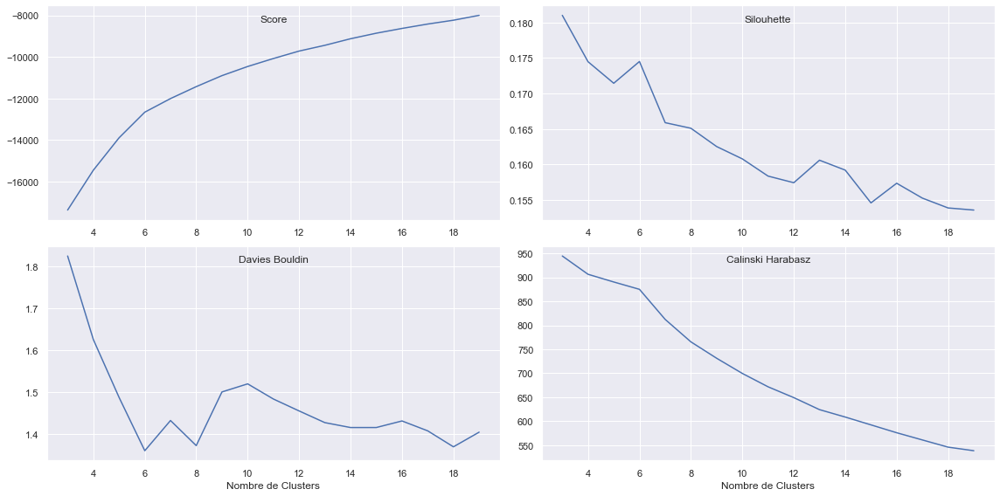

In [368]:
plot_model_evaluation(model_dict)

### 8.3.2 Choisir un Modèle

In [369]:
n_clusters = 6
km = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = km.fit_predict(X_scaled)
X_labels_reduced = km.predict(X_reduced.astype(float))

### 8.3.3 Visualisation des Clusters en 2-D

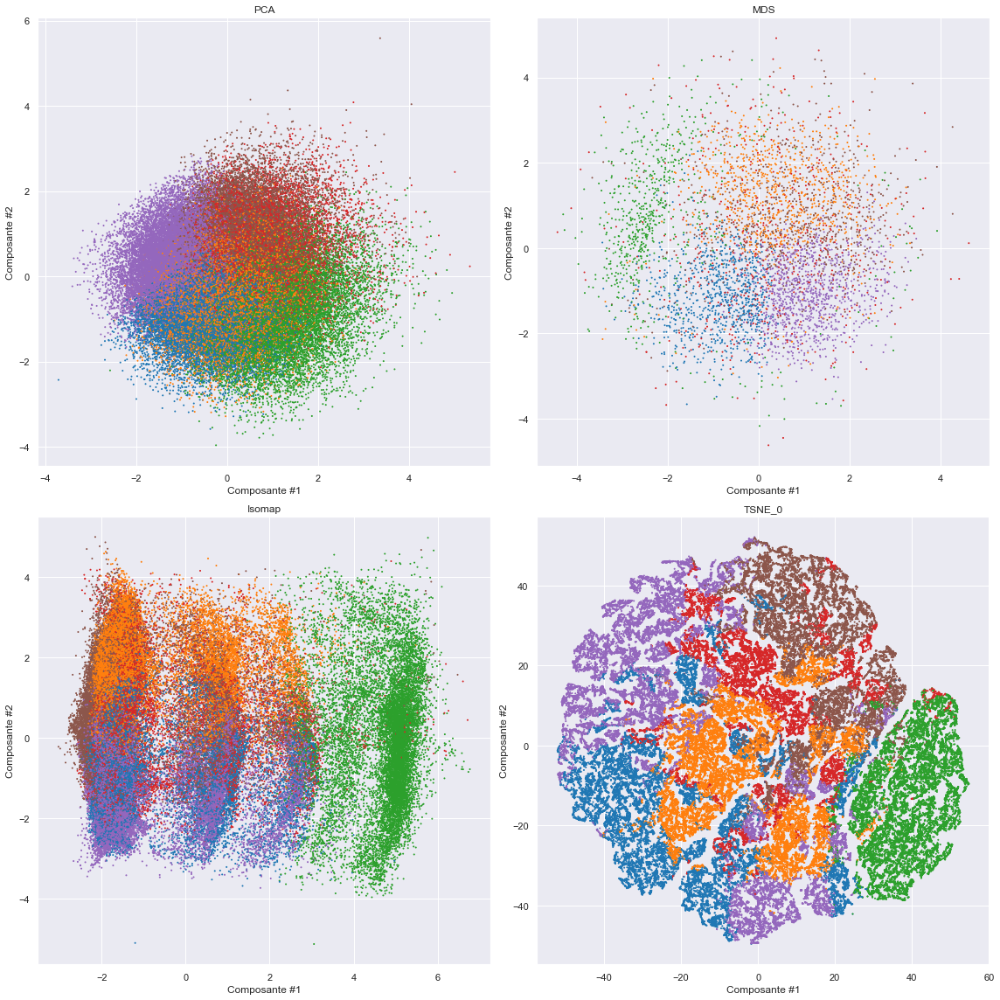

In [370]:
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

### 8.3.4 Distributions des Features par Groupe

In [371]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau -résumé

In [372]:
pd.DataFrame(km.cluster_centers_, columns=X_scaled.columns).merge(
    pd.Series(km.labels_, name="fraction").value_counts(normalize=True).sort_index(),
    right_index=True, left_index=True)

,customer_zip_code_density_3digits,order_payment_total,recency,review_score,online_timeofday,fraction
0,0.409723,-0.381903,0.425095,0.363058,-1.059199,0.183509
1,0.154507,-0.232914,-1.384271,0.344648,0.072286,0.181833
2,0.017927,0.132243,-0.034986,-2.098999,-0.110110,0.143192
3,0.151230,1.550934,0.219930,0.324657,0.035702,0.125083
4,0.491678,-0.462321,0.586559,0.383642,0.845379,0.211098
5,-1.471623,-0.016153,0.175941,0.319156,0.089432,0.155285


#### Tableau -détails

In [373]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0             1  \
customer_zip_code_density_3digits count  17633.000000  17472.000000   
                                  mean       0.409645      0.154651   
                                  std        0.710348      0.801164   
                                  min       -1.937791     -2.841391   
                                  25%       -0.097376     -0.377629   
                                  50%        0.372585      0.185916   
                                  75%        0.855356      0.676243   
                                  max        2.029172      2.029172   
order_payment_total               count  17633.000000  17472.000000   
                                  mean      -0.382031     -0.232179   
                                  std        0.724850      0.790692   
                                  min       -5.884510     -2.716282   
                                  25%       -0.906314     -0.800579   
                                  50%       -0.345832     -0.223170   
                                  75%        0.182121      0.338613   
                                  max        1.770605      2.724203   
recency                           count  17633.000000  17472.000000   
                                  mean       0.425694     -1.384693   
                                  std        0.693984      0.524445   
                                  min       -1.741352     -3.158795   
                                  25%       -0.130103     -1.787682   
                                  50%        0.469442     -1.380615   
                                  75%        0.996753     -0.984637   
                                  max        1.611766     -0.155032   
review_score                      count  17633.000000  17472.000000   
                                  mean       0.363180      0.344586   
                                  std        0.507776      0.531401   
                                  min       -1.550486     -2.297030   
                                  25%       -0.057397     -0.057397   
                                  50%        0.689147      0.689147   
                                  75%        0.689147      0.689147   
                                  max        0.689147      0.689147   
online_timeofday                  count  17633.000000  17472.000000   
                                  mean      -1.058423      0.070763   
                                  std        0.642193      0.895248   
                                  min       -2.390579     -2.390579   
                                  25%       -1.464236     -0.544486   
                                  50%       -0.923595      0.055494   
                                  75%       -0.544486      0.704923   
                                  max       -0.036811      2.353221   

labels                                              2             3  \
customer_zip_code_density_3digits count  13759.000000  12019.000000   
                                  mean       0.017961      0.151637   
                                  std        0.954708      0.793369   
                                  min       -3.223741     -3.015089   
                                  25%       -0.611519     -0.348130   
                                  50%        0.150517      0.203174   
                                  75%        0.657063      0.668066   
                                  max        2.029172      2.029172   
order_payment_total               count  13759.000000  12019.000000   
                                  mean       0.132842      1.548641   
                                  std        0.970205      0.761977   
                                  min       -5.884510      0.279098   
                                  25%       -0.554554      0.960825   
                                  50%        0.101113      1.382934   
                       

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

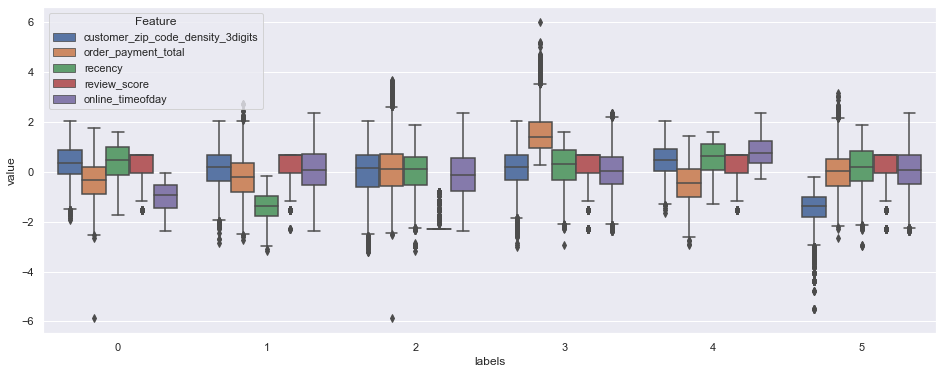

In [374]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

## 8.4 GaussianMixture - Vérsion 3

In [375]:
model_name = "GaussianMixture_3"

### 8.4.1 Evaluation du Modèle

In [376]:
model_dict = test_model(X_reduced, "GaussianMixture")
all_my_models[model_name] = model_dict

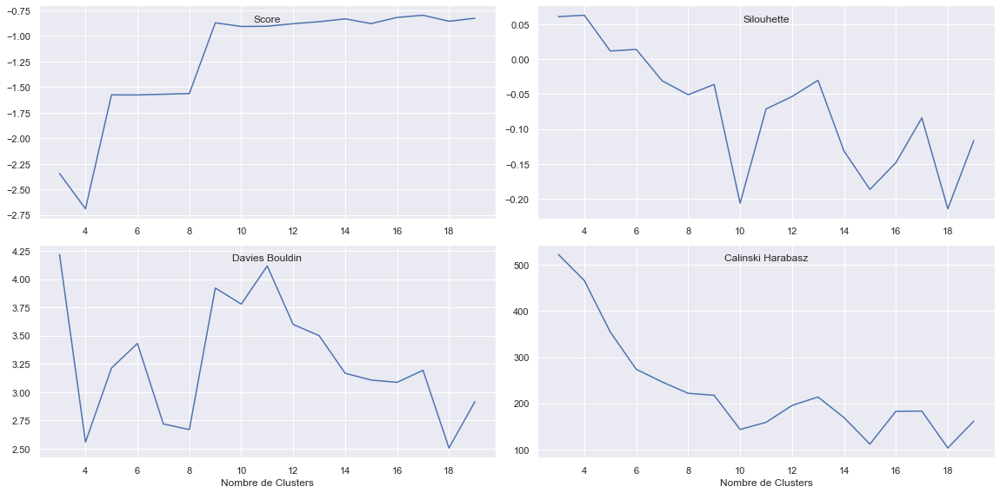

In [377]:
plot_model_evaluation(model_dict)

### 8.4.2 Choisir un Modèle

In [378]:
n_clusters = 4
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
gm.set_params(n_init=10)
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 8.4.3 Visualisation des Clusters en 2-D

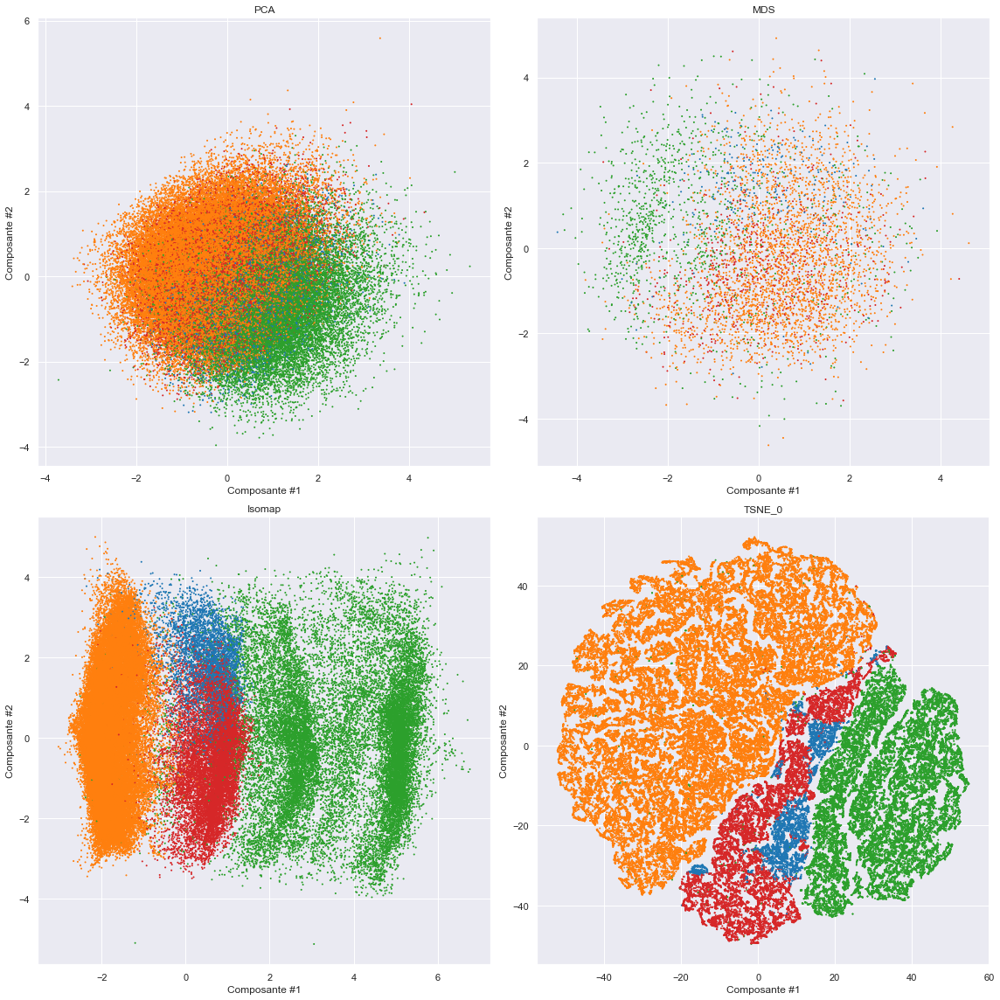

In [379]:
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [380]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 8.4.4 Distributions des Features par Groupe

In [381]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau -résumé

In [382]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,customer_zip_code_density_3digits,order_payment_total,recency,review_score,online_timeofday,weights
0,-0.052914,-0.064824,-1.307144,-0.057397,-0.018768,0.049152
1,0.012722,-0.027255,0.023422,0.689147,0.023101,0.568008
2,-0.012129,0.088306,-0.041794,-1.577587,-0.057044,0.241184
3,-0.012001,-0.018574,0.430793,-0.057397,0.011008,0.141656


#### Tableau -détails

In [383]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0             1  \
customer_zip_code_density_3digits count  4.678000e+03  5.457900e+04   
                                  mean  -5.746427e-02  1.272177e-02   
                                  std    1.036019e+00  9.940009e-01   
                                  min   -4.787637e+00 -5.508351e+00   
                                  25%   -7.410353e-01 -6.304240e-01   
                                  50%    3.645482e-02  1.727823e-01   
                                  75%    6.653264e-01  6.897289e-01   
                                  max    2.029172e+00  2.029172e+00   
order_payment_total               count  4.678000e+03  5.457900e+04   
                                  mean  -6.144748e-02 -2.725516e-02   
                                  std    9.684988e-01  9.928136e-01   
                                  min   -2.653588e+00 -2.936358e+00   
                                  25%   -7.415908e-01 -7.264135e-01   
                                  50%   -1.049827e-01 -7.477367e-02   
                                  75%    5.042703e-01  5.637407e-01   
                                  max    4.695665e+00  5.163559e+00   
recency                           count  4.678000e+03  5.457900e+04   
                                  mean  -1.391657e+00  2.342180e-02   
                                  std    4.583549e-01  1.013262e+00   
                                  min   -2.971724e+00 -2.970209e+00   
                                  25%   -1.725302e+00 -7.241899e-01   
                                  50%   -1.353542e+00  1.378200e-01   
                                  75%   -1.003735e+00  8.599007e-01   
                                  max   -6.364990e-01  1.872943e+00   
review_score                      count  4.678000e+03  5.457900e+04   
                                  mean  -5.739745e-02  6.891468e-01   
                                  std    6.939636e-18  1.110233e-16   
                                  min   -5.739745e-02  6.891468e-01   
                                  25%   -5.739745e-02  6.891468e-01   
                                  50%   -5.739745e-02  6.891468e-01   
                                  75%   -5.739745e-02  6.891468e-01   
                                  max   -5.739745e-02  6.891468e-01   
online_timeofday                  count  4.678000e+03  5.457900e+04   
                                  mean  -1.756736e-02  2.310096e-02   
                                  std    1.024077e+00  1.004687e+00   
                                  min   -2.390579e+00 -2.390579e+00   
                                  25%   -7.150851e-01 -6.433841e-01   
                                  50%   -2.362427e-02  4.890082e-02   
                                  75%    7.469548e-01  7.411858e-01   
                                  max    2.353221e+00  2.353221e+00   

labels                                              2             3  
customer_zip_code_density_3digits count  23171.000000  1.366000e+04  
                                  mean      -0.012128 -1.057897e-02  
                                  std        1.005499  1.001066e+00  
                                  min       -5.508351 -5.508351e+00  
                                  25%       -0.659443 -6.692985e-01  
                                  50%        0.146006  1.505166e-01  
                                  75%        0.665326  6.653264e-01  
                                  max        2.029172  2.029172e+00  
order_payment_total               count  23171.000000  1.366000e+04  
                                  mean       0.088333 -1.989455e-02  
                                  std        1.026573  9.846356e-01  
                                  min       -5.884510 -2.597484e+00  
                                  25%       -0.637156 -6.969943e-01  
                                  50%        0.033021 -6.798709e-02  
                                  75% 

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

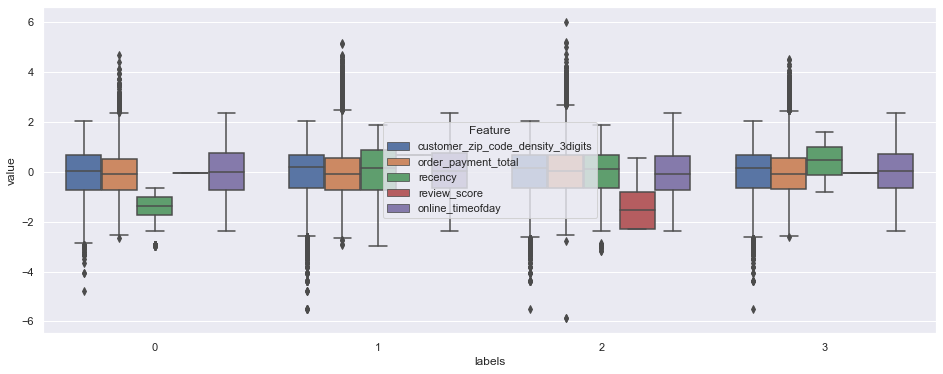

In [384]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

## 8.5 BIRCH - Vérsion 3

In [385]:
model_name = "BIRCH_3"

### 8.5.1 Evaluation du Modèle

In [386]:
model_dict = test_model(X_reduced, "Birch")
all_my_models[model_name] = model_dict

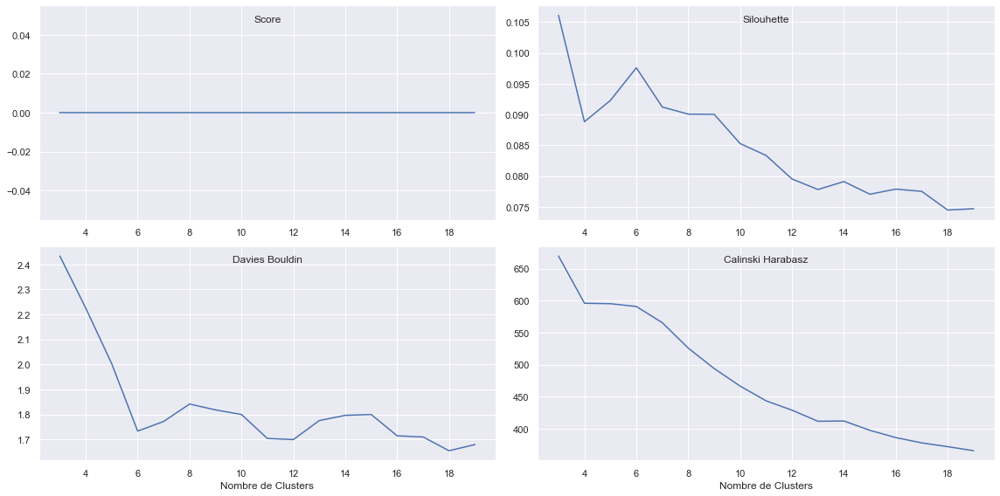

In [387]:
plot_model_evaluation(model_dict)

### 8.5.2 Choisir un Modèle

In [388]:
n_clusters = 6
bm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = bm.fit_predict(X_scaled)
X_labels_reduced = bm.predict(X_reduced.astype(float))

### 8.5.3 Visualisation des Clusters en 2-D

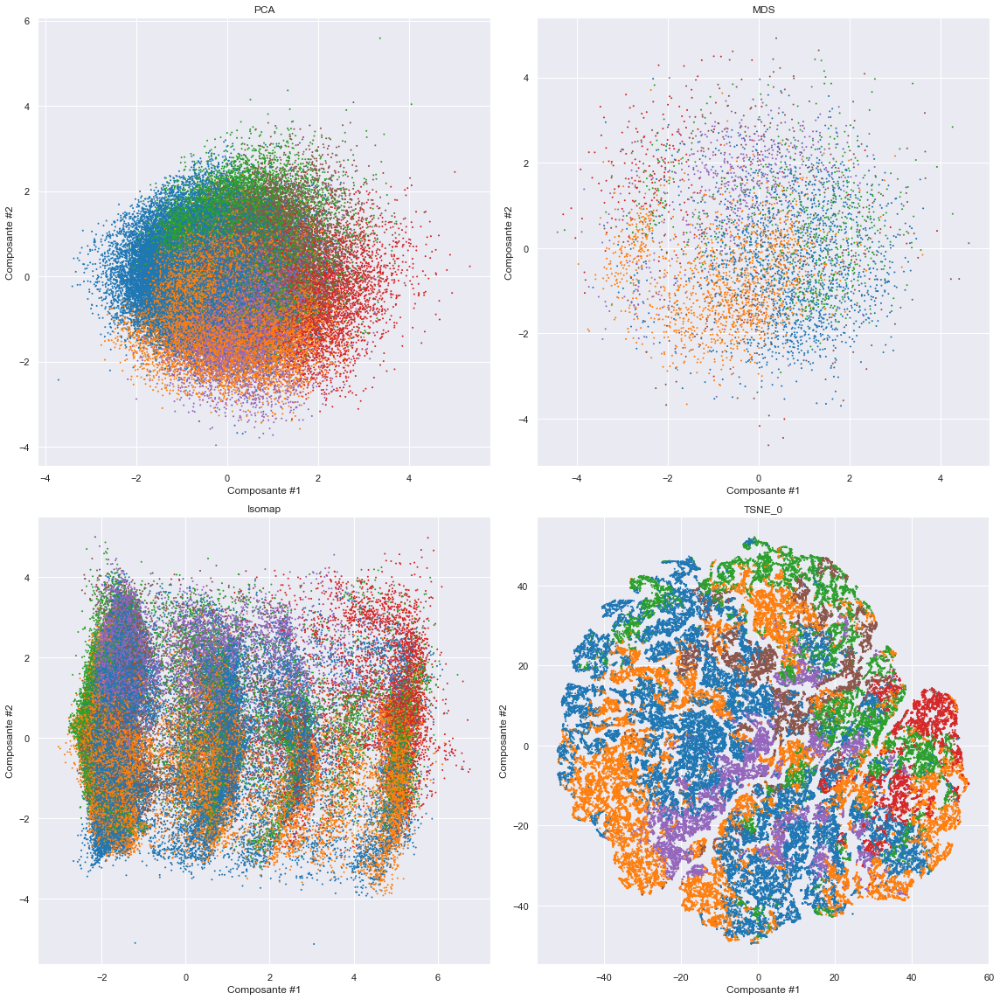

In [389]:
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [390]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 8.5.4 Distributions des Features par Groupe

In [391]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau

In [392]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0             1  \
customer_zip_code_density_3digits count  34403.000000  26654.000000   
                                  mean       0.531041      0.052024   
                                  std        0.691372      0.917891   
                                  min       -1.971885     -4.366046   
                                  25%        0.146006     -0.513270   
                                  50%        0.537013      0.163933   
                                  75%        1.008102      0.676243   
                                  max        2.029172      2.029172   
order_payment_total               count  34403.000000  26654.000000   
                                  mean      -0.037525     -0.376603   
                                  std        0.928228      0.730495   
                                  min       -5.884510     -2.643283   
                                  25%       -0.718494     -0.898903   
                                  50%        0.024559     -0.369791   
                                  75%        0.603144      0.117059   
                                  max        3.367345      2.652130   
recency                           count  34403.000000  26654.000000   
                                  mean      -0.094117      0.459858   
                                  std        0.962342      0.672621   
                                  min       -3.102527     -1.949781   
                                  25%       -0.773393     -0.051745   
                                  50%       -0.038059      0.488379   
                                  75%        0.656541      1.023223   
                                  max        1.878712      1.759115   
review_score                      count  34403.000000  26654.000000   
                                  mean       0.189499     -0.017788   
                                  std        0.798029      1.053957   
                                  min       -2.297030     -2.297030   
                                  25%       -0.057397     -0.057397   
                                  50%        0.689147      0.689147   
                                  75%        0.689147      0.689147   
                                  max        0.689147      0.689147   
online_timeofday                  count  34403.000000  26654.000000   
                                  mean       0.573942     -0.659052   
                                  std        0.811196      0.766671   
                                  min       -2.387283     -2.390579   
                                  25%        0.012638     -1.124687   
                                  50%        0.569763     -0.600528   
                                  75%        1.110404     -0.099446   
                                  max        2.353221      1.641156   

labels                                              2            3  \
customer_zip_code_density_3digits count  12744.000000  4695.000000   
                                  mean      -1.072606    -0.366349   
                                  std        0.875511     0.902191   
                                  min       -5.508351    -3.346208   
                                  25%       -1.622031    -1.019153   
                                  50%       -1.061598    -0.291529   
                                  75%       -0.407989     0.277475   
                                  max        1.089657     2.029172   
order_payment_total               count  12744.000000  4695.000000   
                                  mean      -0.151227     1.050997   
                                  std        0.716792     0.947871   
                                  min       -2.363585    -1.256602   
                                  25%       -0.650524     0.381619   
                                  50%       -0.122659     0.937125   
                                  75% 

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

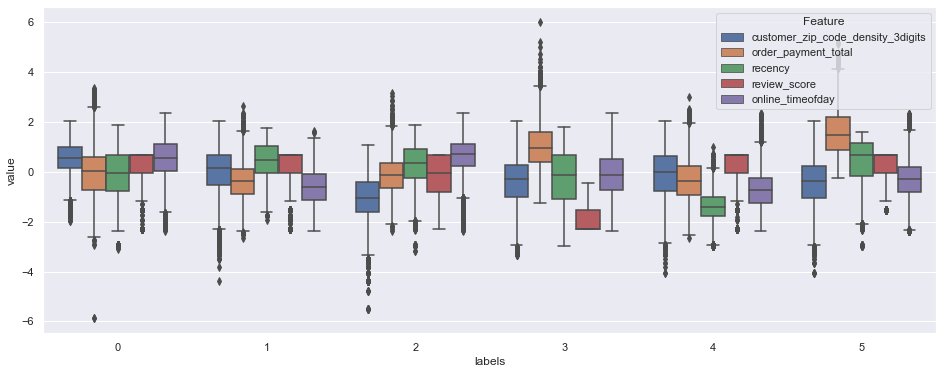

In [393]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

# 9. Modèles - Vérsion 4

## 9.1 Sélection des Features

In [394]:
passthrough_features = []
standardscale_features = ['recency', 'review_score']
log1pscale_features = ['order_payment_total', 'order_avg_shipping_distance']
logscale_features = ['customer_zip_code_density_3digits']
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [395]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)

X_reduced = X_scaled.sample(frac=0.05, random_state=seed).astype(np.float32)
all_components = len(X_scaled.columns)

## 9.2  Créations des Projections

In [396]:
projection_version = "Version4"

In [397]:
all_my_projections[projection_version] = {}

#### PCA

In [398]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

In [399]:
all_my_projections[projection_version]["PCA"] = {"X_proj" : X_pca, "model": pca}

#### MDS

In [400]:
mds = MDS(n_components=2)
X_reduced_mds = mds.fit_transform(X_reduced)

In [401]:
all_my_projections[projection_version]["MDS"] = {"X_proj" : X_reduced_mds, "model": mds}

#### Isomap

In [402]:
iso = Isomap(n_components=2)
X_reduced_iso = iso.fit_transform(X_reduced)
X_iso = iso.transform(X_scaled)

In [403]:
all_my_projections[projection_version]["Isomap"] = {"X_proj" : X_iso, "model": iso}

#### t_SNE

In [404]:
tsne = TSNE(n_components=2, init='pca')
X_tsne0 = tsne.fit_transform(X_scaled)

In [405]:
all_my_projections[projection_version]["TSNE_0"] = {"X_proj" : X_tsne0, "model": tsne}

## -- BREAK Store/Reload Data --

In [406]:
dill.dump_session('notebook_env.db')

In [407]:
dill.load_session('notebook_env.db')

## 9.3 K-Means - Vérsion 4

In [408]:
model_name = "KMeans_4"

### 9.3.1 Evaluation du Modèle

In [409]:
model_dict = test_model(X_reduced)
all_my_models[model_name] = model_dict

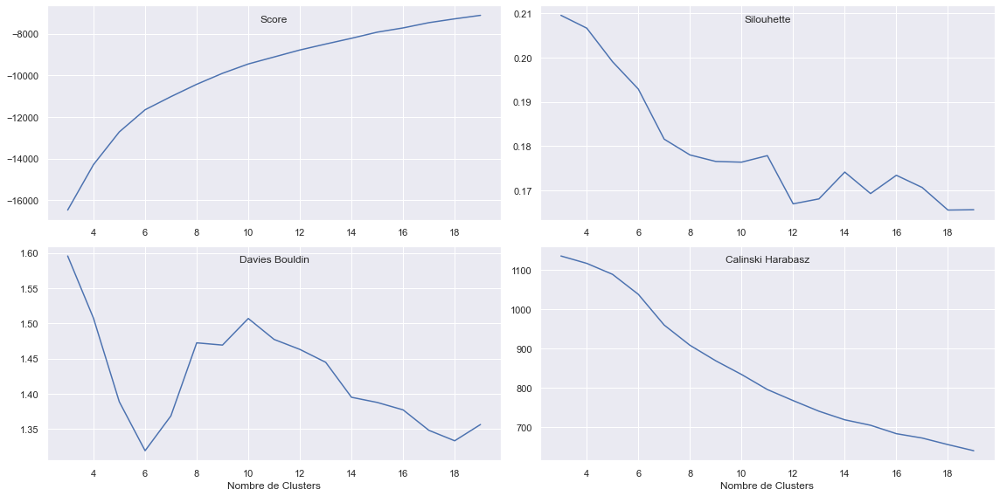

In [410]:
plot_model_evaluation(model_dict)

### 9.3.2 Choisir un Modèle

In [411]:
n_clusters = 6
km = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = km.fit_predict(X_scaled)
X_labels_reduced = km.predict(X_reduced.astype(float))

### 9.3.3 Visualisation des Clusters en 2-D

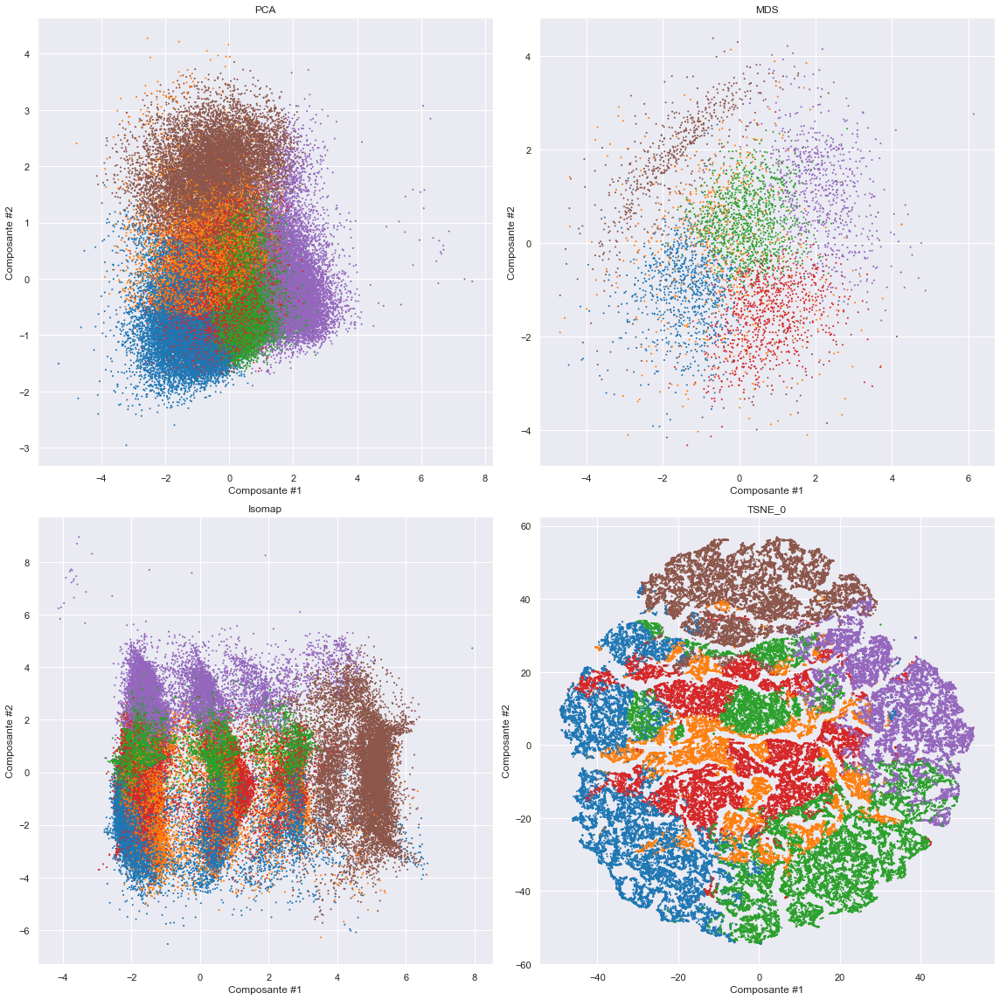

In [412]:
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

### 9.3.4 Distributions des Features par Groupe

In [413]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau -résumé

In [414]:
pd.DataFrame(km.cluster_centers_, columns=X_scaled.columns).merge(
    pd.Series(km.labels_, name="fraction").value_counts(normalize=True).sort_index(),
    right_index=True, left_index=True)

,customer_zip_code_density_3digits,order_payment_total,order_avg_shipping_distance,recency,review_score,fraction
0,-1.403372,-0.045490,0.701381,0.188683,0.304423,0.172488
1,0.141693,1.506091,0.258837,0.221355,0.335285,0.127394
2,0.465876,-0.388375,0.173353,0.678870,0.390131,0.232974
3,0.125014,-0.204608,0.231709,-1.313950,0.352284,0.183769
4,0.638096,-0.555701,-1.854060,0.207098,0.288892,0.143348
5,0.006556,0.167780,0.207116,-0.047609,-2.086384,0.140028


#### Tableau -détails

In [415]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0             1  \
customer_zip_code_density_3digits count  16574.000000  12241.000000   
                                  mean      -1.403588      0.138510   
                                  std        0.654013      0.780657   
                                  min       -5.508351     -3.015089   
                                  25%       -1.726095     -0.348130   
                                  50%       -1.322907      0.172782   
                                  75%       -0.939131      0.659825   
                                  max       -0.080377      2.029172   
order_payment_total               count  16574.000000  12241.000000   
                                  mean      -0.046483      1.507636   
                                  std        0.764676      0.765778   
                                  min       -2.363585      0.346115   
                                  25%       -0.603530      0.908437   
                                  50%       -0.023776      1.327801   
                                  75%        0.488474      1.946468   
                                  max        3.142781      6.011733   
order_avg_shipping_distance       count  16574.000000  12241.000000   
                                  mean       0.701171      0.260547   
                                  std        0.515794      0.698466   
                                  min       -2.455529     -3.402135   
                                  25%        0.351500     -0.033263   
                                  50%        0.704615      0.293783   
                                  75%        1.110950      0.696150   
                                  max        2.363217      1.682305   
recency                           count  16574.000000  12241.000000   
                                  mean       0.185172      0.221262   
                                  std        0.809284      0.811400   
                                  min       -2.966200     -2.943332   
                                  25%       -0.313811     -0.297297   
                                  50%        0.216229      0.280888   
                                  75%        0.816312      0.855344   
                                  max        1.872943      1.609604   
review_score                      count  16574.000000  12241.000000   
                                  mean       0.304431      0.334723   
                                  std        0.570187      0.566681   
                                  min       -2.297030     -2.297030   
                                  25%       -0.057397     -0.057397   
                                  50%        0.689147      0.689147   
                                  75%        0.689147      0.689147   
                                  max        0.689147      0.689147   

labels                                              2             3  \
customer_zip_code_density_3digits count  22386.000000  17658.000000   
                                  mean       0.465471      0.128729   
                                  std        0.634902      0.788786   
                                  min       -1.121030     -2.841391   
                                  25%        0.000685     -0.385136   
                                  50%        0.387026      0.155008   
                                  75%        0.855356      0.657063   
                                  max        2.029172      2.029172   
order_payment_total               count  22386.000000  17658.000000   
                                  mean      -0.387193     -0.204890   
                                  std        0.639581      0.760486   
                                  min       -5.884510     -2.653588   
                                  25%       -0.855781     -0.739556   
                                  50%       -0.339619     -0.194068   
                       

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

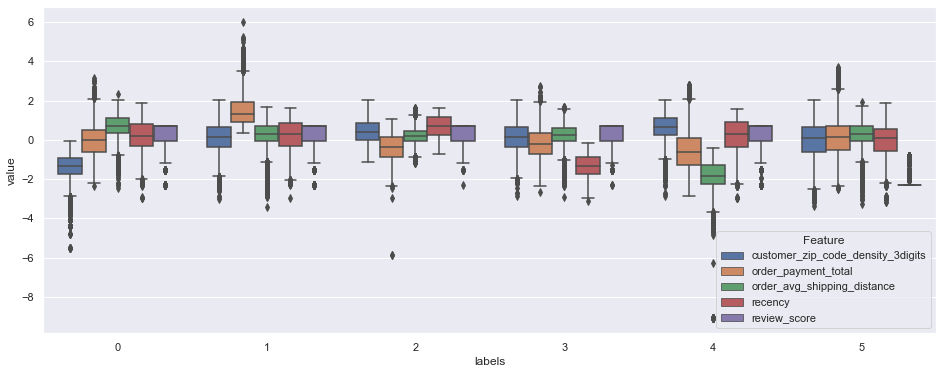

In [416]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

## 9.4 GaussianMixture - Vérsion 4

In [417]:
model_name = "GaussianMixture_4"

### 9.4.1 Evaluation du Modèle

In [418]:
model_dict = test_model(X_reduced, "GaussianMixture")
all_my_models[model_name] = model_dict

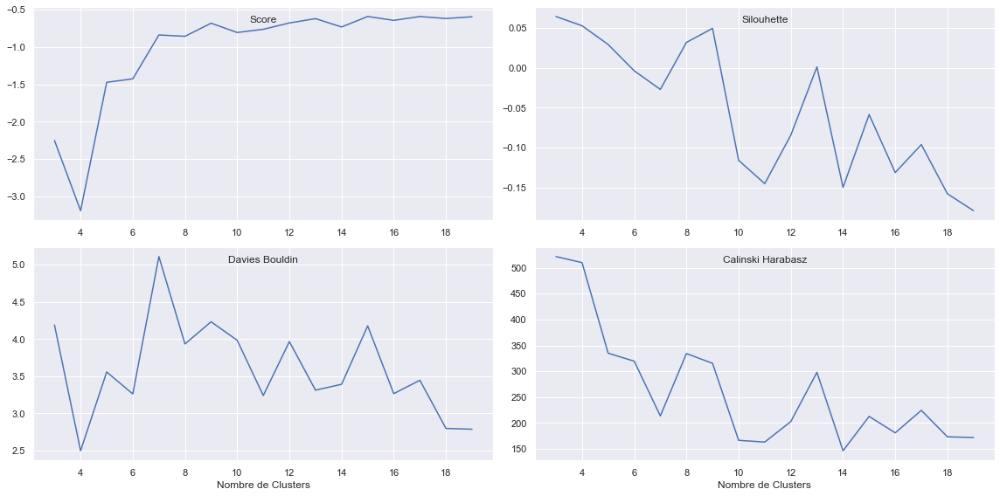

In [419]:
plot_model_evaluation(model_dict)

### 9.4.2 Choisir un Modèle

In [420]:
n_clusters = 4
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
gm.set_params(n_init=10)
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 9.4.3 Visualisation des Clusters en 2-D

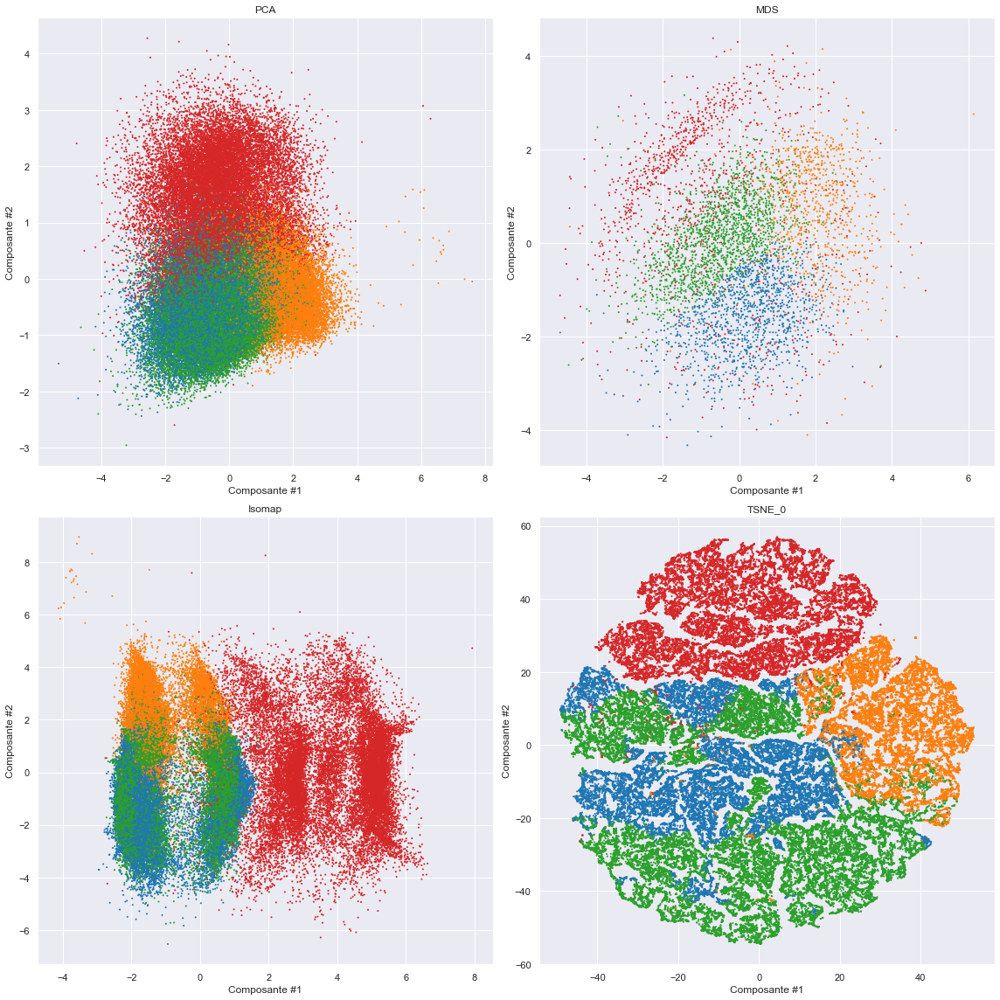

In [421]:
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [422]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 9.4.4 Distributions des Features par Groupe

In [423]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau -résumé

In [424]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,customer_zip_code_density_3digits,order_payment_total,order_avg_shipping_distance,recency,review_score,weights
0,-0.220342,0.037141,0.447871,-0.935634,0.539340,0.239195
1,0.602340,-0.246930,-1.378911,0.107780,0.530361,0.181423
2,-0.164325,0.052196,0.387504,0.707930,0.498318,0.311506
3,-0.020106,0.073376,0.083354,-0.060772,-1.420269,0.267876


#### Tableau -détails

In [425]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0             1  \
customer_zip_code_density_3digits count  24074.000000  16112.000000   
                                  mean      -0.189880      0.609766   
                                  std        1.021788      0.646345   
                                  min       -5.508351     -2.924617   
                                  25%       -0.889012      0.253294   
                                  50%       -0.138157      0.620478   
                                  75%        0.537013      1.111320   
                                  max        2.029172      2.029172   
order_payment_total               count  24074.000000  16112.000000   
                                  mean       0.044854     -0.300816   
                                  std        0.976213      1.065009   
                                  min       -2.438110     -2.936358   
                                  25%       -0.648821     -1.091921   
                                  50%       -0.026300     -0.368431   
                                  75%        0.602866      0.337047   
                                  max        5.163559      4.695665   
order_avg_shipping_distance       count  24074.000000  16112.000000   
                                  mean       0.453845     -1.603194   
                                  std        0.485558      0.773416   
                                  min       -1.005127     -9.099968   
                                  25%        0.089959     -2.101229   
                                  50%        0.396200     -1.506301   
                                  75%        0.737213     -0.982451   
                                  max        2.014664      1.342269   
recency                           count  24074.000000  16112.000000   
                                  mean      -1.017375      0.124811   
                                  std        0.620310      0.961120   
                                  min       -2.971724     -2.966307   
                                  25%       -1.490896     -0.503110   
                                  50%       -0.949864      0.216661   
                                  75%       -0.492085      0.901114   
                                  max        0.099004      1.558402   
review_score                      count  24074.000000  16112.000000   
                                  mean       0.528513      0.521642   
                                  std        0.305889      0.310923   
                                  min       -0.181821     -0.803942   
                                  25%        0.689147      0.689147   
                                  50%        0.689147      0.689147   
                                  75%        0.689147      0.689147   
                                  max        0.689147      0.689147   

labels                                              2             3  
customer_zip_code_density_3digits count  32644.000000  23258.000000  
                                  mean      -0.141641     -0.027073  
                                  std        1.005521      1.009244  
                                  min       -5.508351     -5.508351  
                                  25%       -0.818091     -0.669298  
                                  50%       -0.074772      0.123153  
                                  75%        0.558515      0.657063  
                                  max        2.029172      2.029172  
order_payment_total               count  32644.000000  23258.000000  
                                  mean       0.052961      0.087629  
                                  std        0.932405      1.030913  
                                  min       -2.433369     -5.884510  
                                  25%       -0.611027     -0.640532  
                                  50%        0.018480      0.030883  
                                  75% 

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

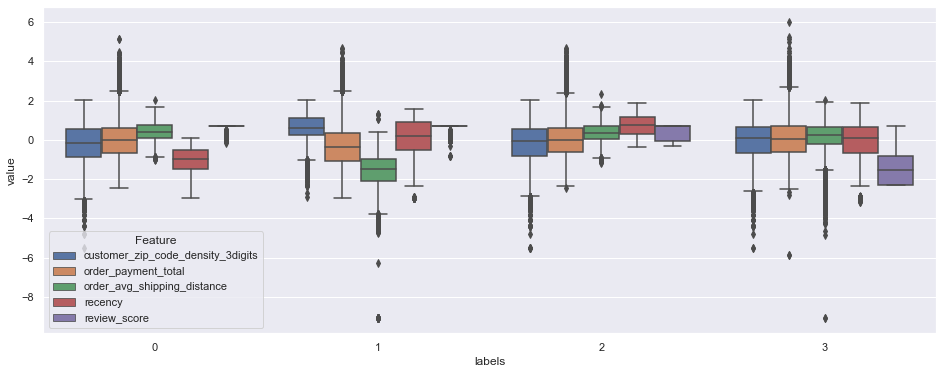

In [426]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

## 9.5 BIRCH - Vérsion 4

In [427]:
model_name = "BIRCH_4"

### 9.5.1 Evaluation du Modèle

In [428]:
model_dict = test_model(X_reduced, "Birch")
all_my_models[model_name] = model_dict

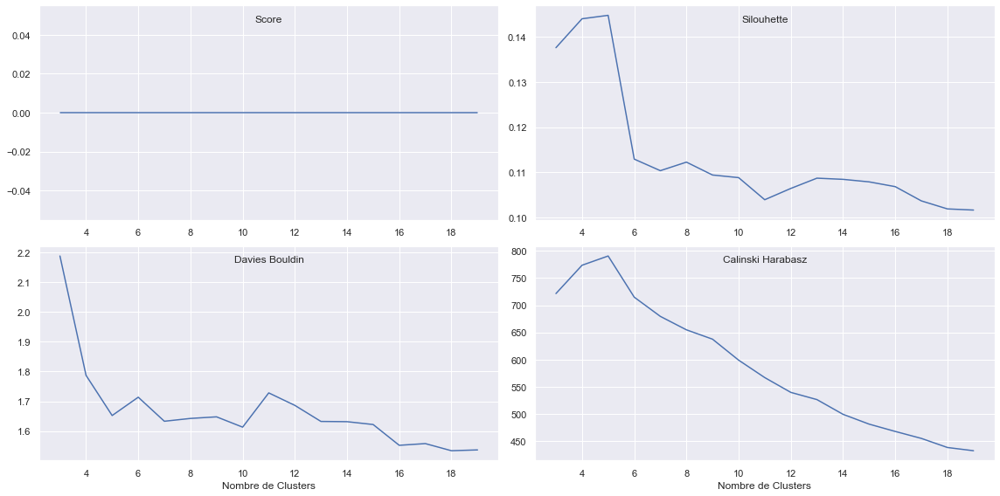

In [429]:
plot_model_evaluation(model_dict)

### 9.5.2 Choisir un Modèle

In [430]:
n_clusters = 5
bm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = bm.fit_predict(X_scaled)
X_labels_reduced = bm.predict(X_reduced.astype(float))

### 9.5.3 Visualisation des Clusters en 2-D

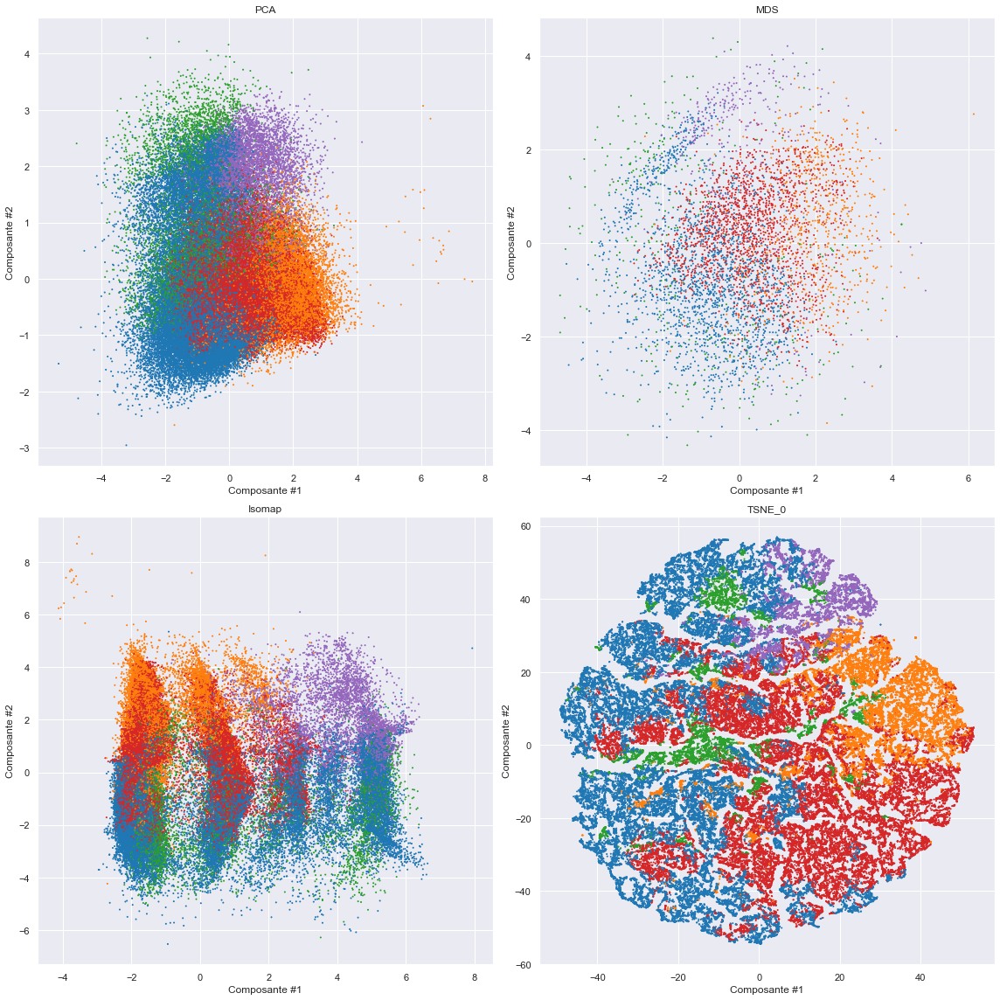

In [431]:
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [432]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 9.5.4 Distributions des Features par Groupe

In [433]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau

In [434]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                              0             1  \
customer_zip_code_density_3digits count  35651.000000  12928.000000   
                                  mean      -0.729513      0.422666   
                                  std        0.885914      0.753276   
                                  min       -5.508351     -5.508351   
                                  25%       -1.341643      0.031420   
                                  50%       -0.659443      0.518221   
                                  75%       -0.080377      0.882423   
                                  max        2.029172      2.029172   
order_payment_total               count  35651.000000  12928.000000   
                                  mean      -0.223541     -0.482778   
                                  std        0.812401      0.831492   
                                  min       -5.884510     -2.880980   
                                  25%       -0.840483     -1.104311   
                                  50%       -0.280953     -0.521430   
                                  75%        0.367999      0.092109   
                                  max        3.365019      3.868849   
order_avg_shipping_distance       count  35651.000000  12928.000000   
                                  mean       0.584222     -1.600997   
                                  std        0.483007      0.980815   
                                  min       -1.495959     -9.099968   
                                  25%        0.230776     -2.224723   
                                  50%        0.570862     -1.735495   
                                  75%        0.916323     -0.909166   
                                  max        2.014664      1.129546   
recency                           count  35651.000000  12928.000000   
                                  mean      -0.216985     -0.249411   
                                  std        1.000006      1.030787   
                                  min       -3.159611     -2.970209   
                                  25%       -0.976851     -1.010233   
                                  50%       -0.174464     -0.212812   
                                  75%        0.527115      0.544771   
                                  max        1.872943      1.558554   
review_score                      count  35651.000000  12928.000000   
                                  mean      -0.186849      0.400356   
                                  std        1.107788      0.482149   
                                  min       -2.297030     -2.297030   
                                  25%       -0.803942     -0.057397   
                                  50%        0.689147      0.689147   
                                  75%        0.689147      0.689147   
                                  max        0.689147      0.689147   

labels                                             2             3  \
customer_zip_code_density_3digits count  6969.000000  34632.000000   
                                  mean     -0.029539      0.471002   
                                  std       0.927602      0.755632   
                                  min      -3.223741     -2.081436   
                                  25%      -0.659443      0.026360   
                                  50%       0.085510      0.518221   
                                  75%       0.657063      0.974008   
                                  max       2.029172      2.029172   
order_payment_total               count  6969.000000  34632.000000   
                                  mean      2.001167      0.064790   
                                  std       0.750892      0.794199   
                                  min       0.071625     -2.936358   
                                  25%       1.456042     -0.440388   
                                  50%       1.934311      0.118773   
                                  75% 

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

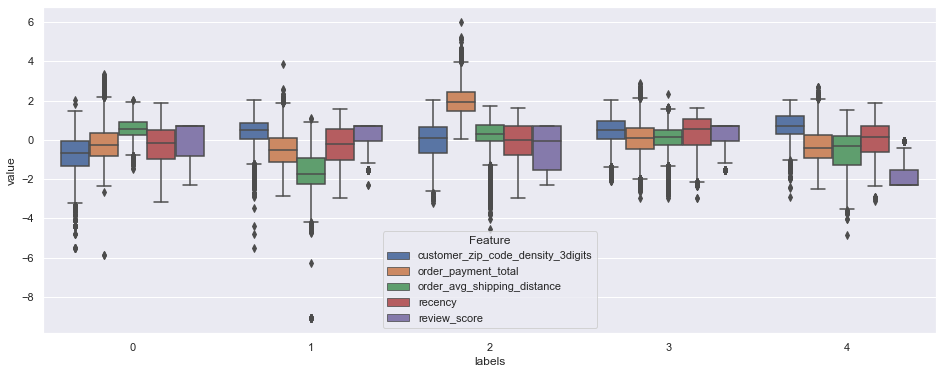

In [435]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

# 10. Modèles - Vérsion 5

## 10.1 Sélection des Features

In [436]:
passthrough_features = ['order_is_delivered']
standardscale_features = ['recency', 'review_score']
log1pscale_features = ['order_payment_total', 'order_avg_shipping_distance']
logscale_features = []
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [437]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)

X_reduced = X_scaled.sample(frac=0.05, random_state=seed).astype(np.float32)
all_components = len(X_scaled.columns)

## 10.2  Créations des Projections

In [438]:
projection_version = "Version5"

In [439]:
all_my_projections[projection_version] = {}

#### PCA

In [440]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

In [441]:
all_my_projections[projection_version]["PCA"] = {"X_proj" : X_pca, "model": pca}

#### MDS

In [442]:
mds = MDS(n_components=2)
X_reduced_mds = mds.fit_transform(X_reduced)

In [443]:
all_my_projections[projection_version]["MDS"] = {"X_proj" : X_reduced_mds, "model": mds}

#### Isomap

In [444]:
iso = Isomap(n_components=2)
X_reduced_iso = iso.fit_transform(X_reduced)
X_iso = iso.transform(X_scaled)

In [445]:
all_my_projections[projection_version]["Isomap"] = {"X_proj" : X_iso, "model": iso}

#### t_SNE

In [446]:
tsne = TSNE(n_components=2, init='pca')
X_tsne0 = tsne.fit_transform(X_scaled)

In [447]:
all_my_projections[projection_version]["TSNE_0"] = {"X_proj" : X_tsne0, "model": tsne}

## -- BREAK Store/Reload Data --

In [448]:
dill.dump_session('notebook_env.db')

In [449]:
dill.load_session('notebook_env.db')

## 10.3 K-Means - Vérsion 5

In [450]:
model_name = "KMeans_5"

### 10.3.1 Evaluation du Modèle

In [451]:
model_dict = test_model(X_reduced)
all_my_models[model_name] = model_dict

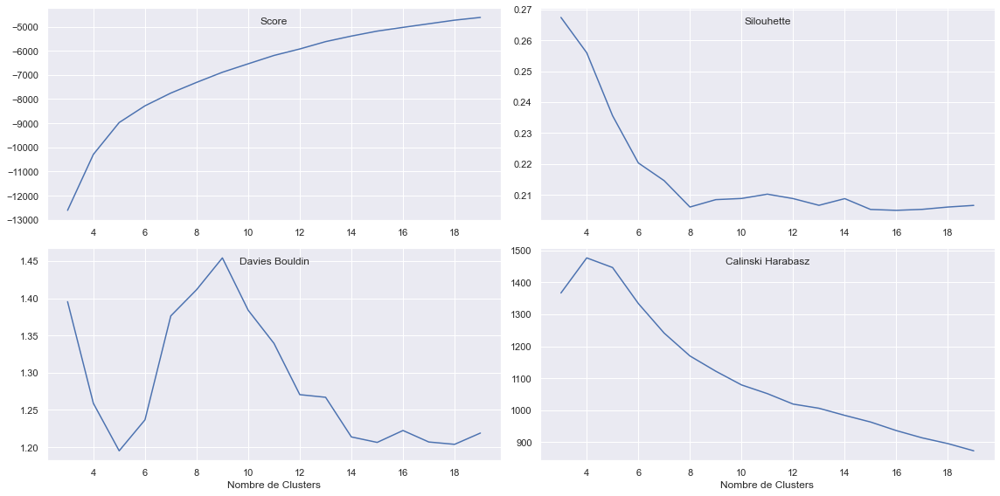

In [452]:
plot_model_evaluation(model_dict)

### 10.3.2 Choisir un Modèle

In [453]:
n_clusters = 5
km = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = km.fit_predict(X_scaled)
X_labels_reduced = km.predict(X_reduced.astype(float))

### 10.3.3 Visualisation des Clusters en 2-D

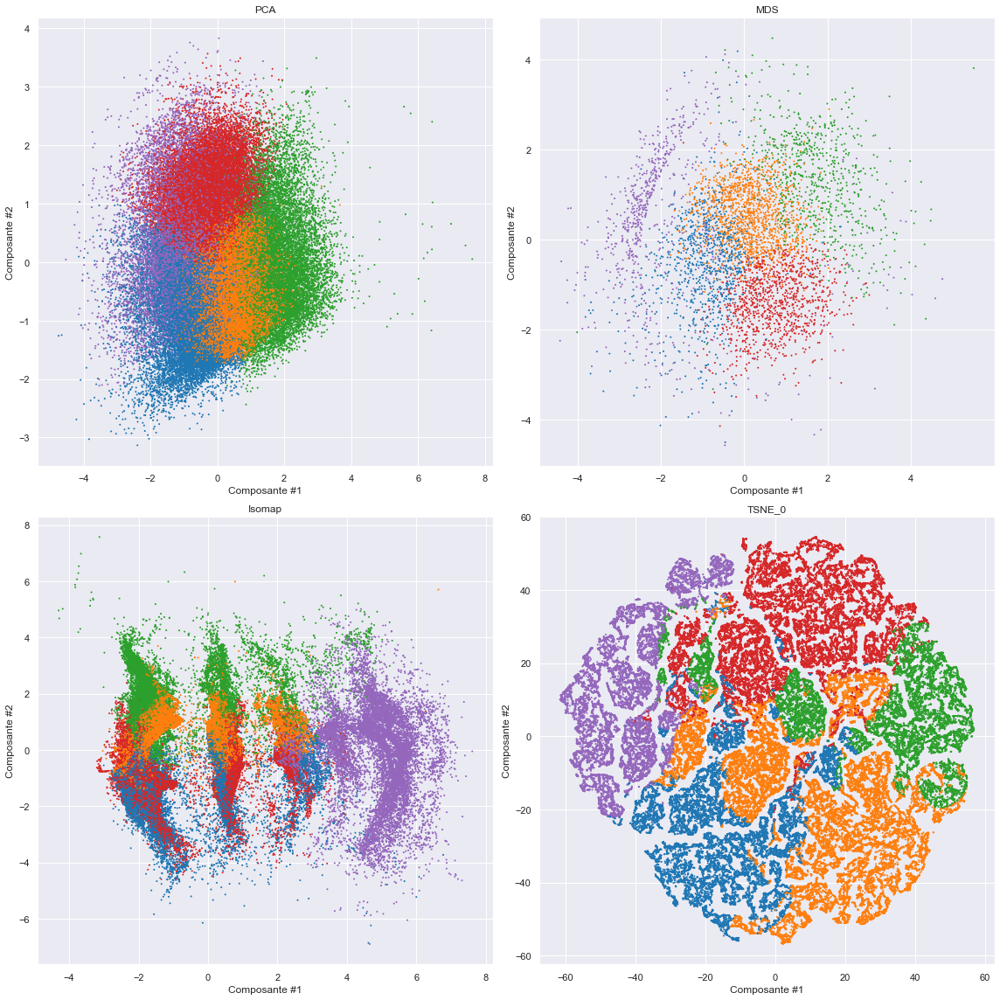

In [454]:
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

### 10.3.4 Distributions des Features par Groupe

In [455]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau -résumé

In [456]:
pd.DataFrame(km.cluster_centers_, columns=X_scaled.columns).merge(
    pd.Series(km.labels_, name="fraction").value_counts(normalize=True).sort_index(),
    right_index=True, left_index=True)

,order_payment_total,order_avg_shipping_distance,recency,review_score,order_is_delivered,fraction
0,1.222386,0.373326,0.348640,0.362698,0.990288,0.191949
1,-0.501220,0.336606,0.649782,0.378464,0.992324,0.285676
2,-0.542056,-1.827795,0.234394,0.309921,0.985954,0.147698
3,-0.160672,0.315015,-1.242445,0.358454,0.983768,0.225595
4,0.176591,0.210336,-0.047706,-2.041381,0.787325,0.149082


#### Tableau -détails

In [457]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                        0             1             2  \
order_payment_total         count  18444.000000  27450.000000  14192.000000   
                            mean       1.218019     -0.504905     -0.541787   
                            std        0.743828      0.573392      0.883788   
                            min        0.213980     -5.884510     -2.880980   
                            25%        0.658502     -0.922446     -1.232545   
                            50%        0.991529     -0.470996     -0.583816   
                            75%        1.565738     -0.034134      0.085039   
                            max        6.011733      0.550349      3.244561   
order_avg_shipping_distance count  18444.000000  27450.000000  14192.000000   
                            mean       0.372967      0.336257     -1.828738   
                            std        0.666342      0.514318      0.736200   
                            min       -2.925142     -0.969498     -9.099968   
                            25%        0.027909      0.028795     -2.242581   
                            50%        0.377506      0.309604     -1.803011   
                            75%        0.796115      0.674459     -1.264441   
                            max        2.014664      2.363217     -0.530850   
recency                     count  18444.000000  27450.000000  14192.000000   
                            mean       0.352481      0.648422      0.234312   
                            std        0.731725      0.549582      0.884988   
                            min       -2.241105     -0.619062     -2.966307   
                            25%       -0.182593      0.189264     -0.299924   
                            50%        0.405028      0.680230      0.339376   
                            75%        0.919643      1.130180      0.938786   
                            max        1.872943      1.611766      1.558554   
review_score                count  18444.000000  27450.000000  14192.000000   
                            mean       0.362834      0.378109      0.309942   
                            std        0.511773      0.488120      0.641450   
                            min       -2.297030     -2.297030     -2.297030   
                            25%       -0.057397     -0.057397     -0.057397   
                            50%        0.689147      0.689147      0.689147   
                            75%        0.689147      0.689147      0.689147   
                            max        0.689147      0.689147      0.689147   
order_is_delivered          count  18444.000000  27450.000000  14192.000000   
                            mean       0.990385      0.992231      0.985943   
                            std        0.117564      0.103085      0.142157   
                            min       -1.000000     -1.000000     -1.000000   
                            25%        1.000000      1.000000      1.000000   
                            50%        1.000000      1.000000      1.000000   
                            75%        1.000000      1.000000      1.000000   
                            max        1.000000      1.000000      1.000000   

labels                                        3             4  
order_payment_total         count  21677.000000  14325.000000  
                            mean      -0.158958      0.176564  
                            std        0.761984      0.976849  
                            min       -2.438110     -2.519897  
                            25%       -0.686820     -0.497339  
                            50%       -0.145506      0.136994  
                            75%        0.355625      0.719913  
                            max        3.187162      4.407333  
order_avg_shipping_distance count  21677.000000  14325.000000  
                            mean       0.315140      0.210326  
                            std        0.609461      0.7

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

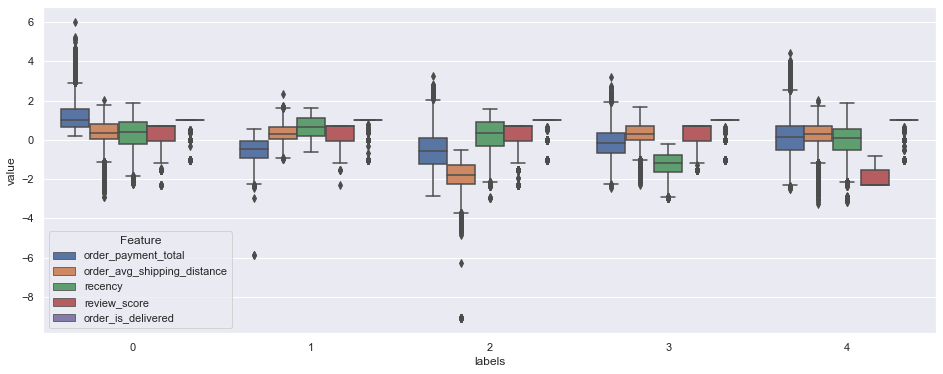

In [458]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

## 10.4 GaussianMixture - Vérsion 5

In [459]:
model_name = "GaussianMixture_5"

### 10.4.1 Evaluation du Modèle

In [460]:
model_dict = test_model(X_reduced, "GaussianMixture")
all_my_models[model_name] = model_dict

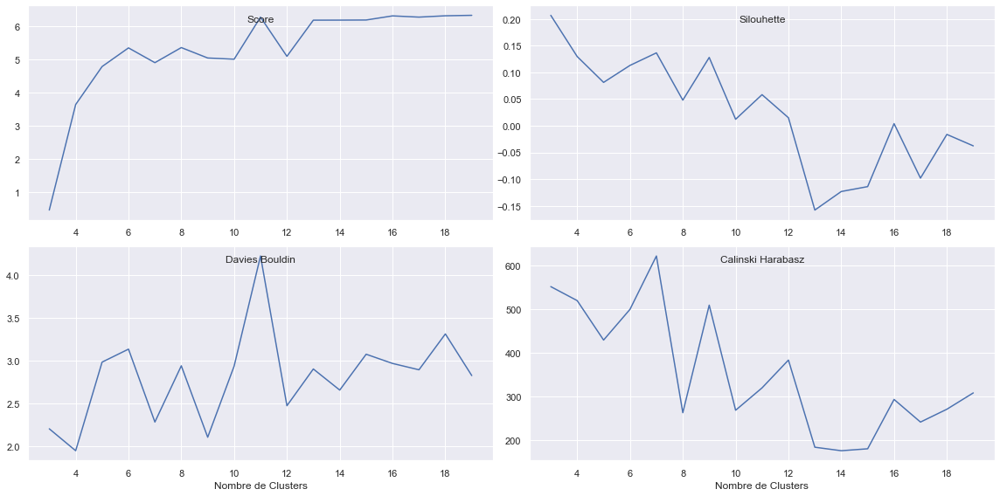

In [461]:
plot_model_evaluation(model_dict)

### 10.4.2 Choisir un Modèle

In [462]:
n_clusters = 4
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
gm.set_params(n_init=10)
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 10.4.3 Visualisation des Clusters en 2-D

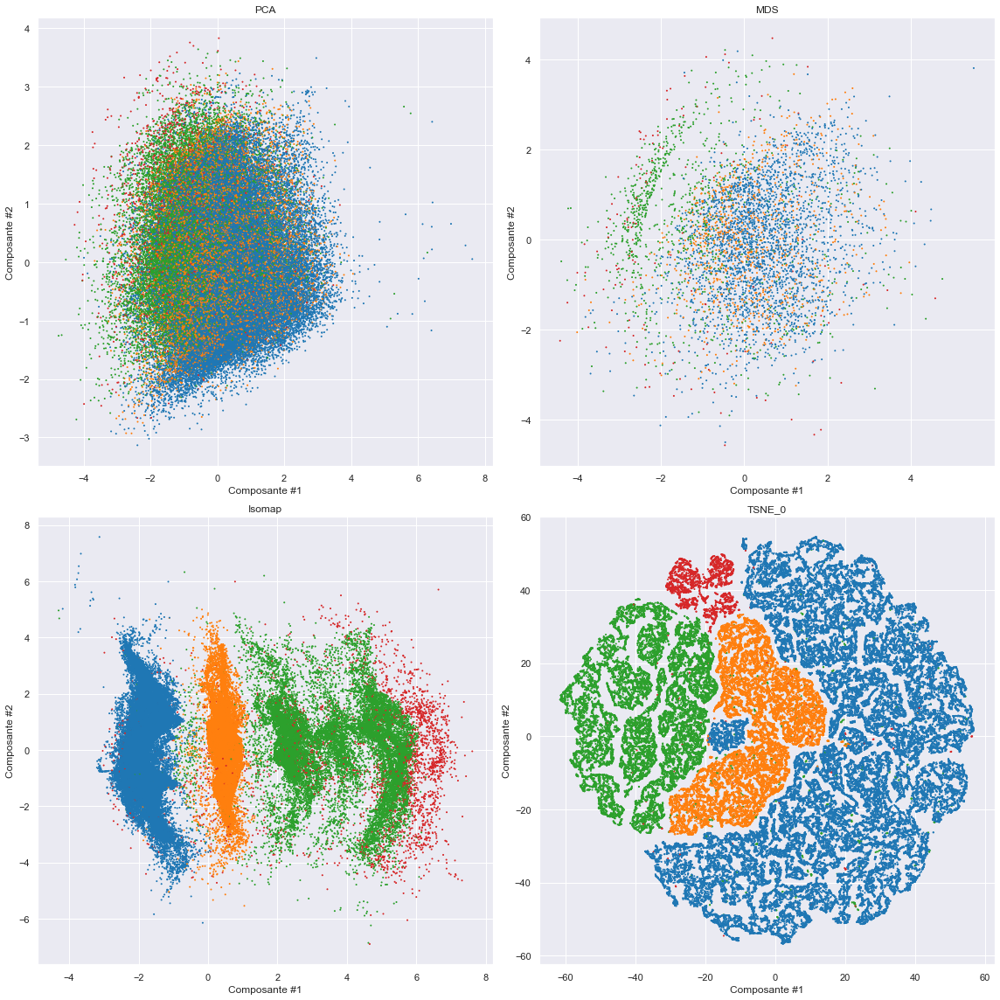

In [463]:
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [464]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 10.4.4 Distributions des Features par Groupe

In [465]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau -résumé

In [466]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,order_payment_total,order_avg_shipping_distance,recency,review_score,order_is_delivered,weights
0,-0.027326,-0.052505,0.025305,0.689147,1.000000,0.565499
1,-0.031403,0.036229,-0.013010,-0.057397,1.000000,0.189204
2,0.081195,0.098462,-0.007002,-1.526364,1.000000,0.214813
3,0.129668,0.055309,-0.339342,-1.672019,-0.361462,0.030484


#### Tableau -détails

In [467]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                        0             1             2  \
order_payment_total         count  5.433800e+04  1.818400e+04  20637.000000   
                            mean  -2.732709e-02 -3.141169e-02      0.081228   
                            std    9.925586e-01  9.804662e-01      1.012875   
                            min   -2.936358e+00 -2.653588e+00     -2.791709   
                            25%   -7.264135e-01 -7.104253e-01     -0.637531   
                            50%   -7.429621e-02 -8.075732e-02      0.033021   
                            75%    5.639197e-01  5.534941e-01      0.684597   
                            max    5.163559e+00  4.695665e+00      6.011733   
order_avg_shipping_distance count  5.433800e+04  1.818400e+04  20637.000000   
                            mean  -5.250456e-02  3.623316e-02      0.098472   
                            std    1.023410e+00  9.811898e-01      0.952456   
                            min   -9.099968e+00 -4.328646e+00     -9.099968   
                            25%   -5.011245e-01 -3.104654e-01     -0.134035   
                            50%    1.802282e-01  2.558893e-01      0.277435   
                            75%    6.254437e-01  6.753223e-01      0.686727   
                            max    2.363217e+00  1.687008e+00      2.014664   
recency                     count  5.433800e+04  1.818400e+04  20637.000000   
                            mean   2.530500e-02 -1.301417e-02     -0.006998   
                            std    1.012160e+00  9.959295e-01      0.944550   
                            min   -2.970209e+00 -2.971724e+00     -2.970562   
                            25%   -7.224714e-01 -7.248030e-01     -0.577506   
                            50%    1.386439e-01  1.032629e-01      0.143170   
                            75%    8.603117e-01  7.939260e-01      0.680678   
                            max    1.558593e+00  1.553150e+00      1.558554   
review_score                count  5.433800e+04  1.818400e+04  20637.000000   
                            mean   6.891468e-01 -5.739745e-02     -1.526663   
                            std    2.220466e-16  2.081725e-17      0.733201   
                            min    6.891468e-01 -5.739745e-02     -2.297030   
                            25%    6.891468e-01 -5.739745e-02     -2.297030   
                            50%    6.891468e-01 -5.739745e-02     -1.550486   
                            75%    6.891468e-01 -5.739745e-02     -0.803942   
                            max    6.891468e-01 -5.739745e-02      0.564723   
order_is_delivered          count  5.433800e+04  1.818400e+04  20637.000000   
                            mean   1.000000e+00  1.000000e+00      1.000000   
                            std    0.000000e+00  0.000000e+00      0.000000   
                            min    1.000000e+00  1.000000e+00      1.000000   
                            25%    1.000000e+00  1.000000e+00      1.000000   
                            50%    1.000000e+00  1.000000e+00      1.000000   
                            75%    1.000000e+00  1.000000e+00      1.000000   
                            max    1.000000e+00  1.000000e+00      1.000000   

labels                                       3  
order_payment_total         count  2929.000000  
                            mean      0.129664  
                            std       1.118398  
                            min      -5.884510  
                            25%      -0.631551  
                            50%       0.019422  
                            75%       0.737733  
                            max       4.707433  
order_avg_shipping_distance count  2929.000000  
                            mean      0.055299  
                            std       0.936631  
                            min      -3.796466  
                            25%      -0.167079  
                            50%       0.179656  
                         

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

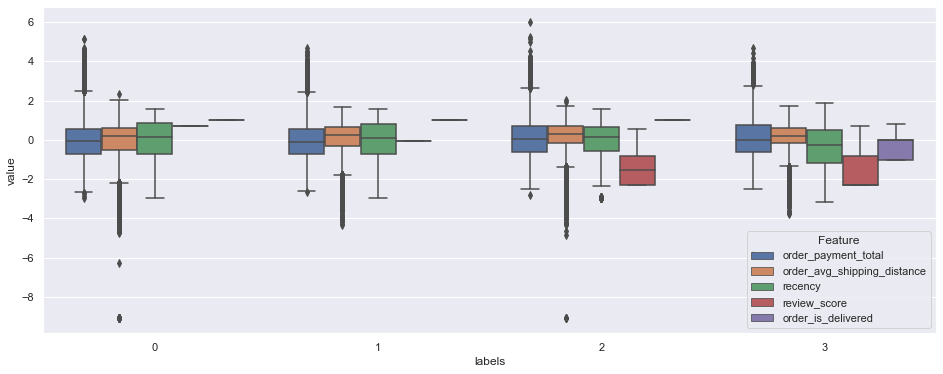

In [468]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

## 10.5 BIRCH - Vérsion 5

In [469]:
model_name = "BIRCH_5"

### 10.5.1 Evaluation du Modèle

In [470]:
model_dict = test_model(X_reduced, "Birch")
all_my_models[model_name] = model_dict

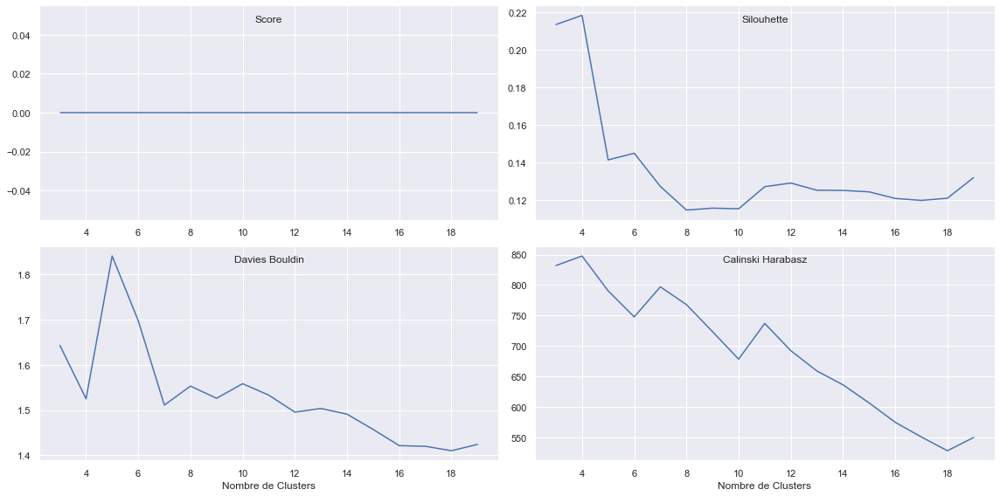

In [471]:
plot_model_evaluation(model_dict)

### 10.5.2 Choisir un Modèle

In [472]:
n_clusters = 4
bm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = bm.fit_predict(X_scaled)
X_labels_reduced = bm.predict(X_reduced.astype(float))

### 10.5.3 Visualisation des Clusters en 2-D

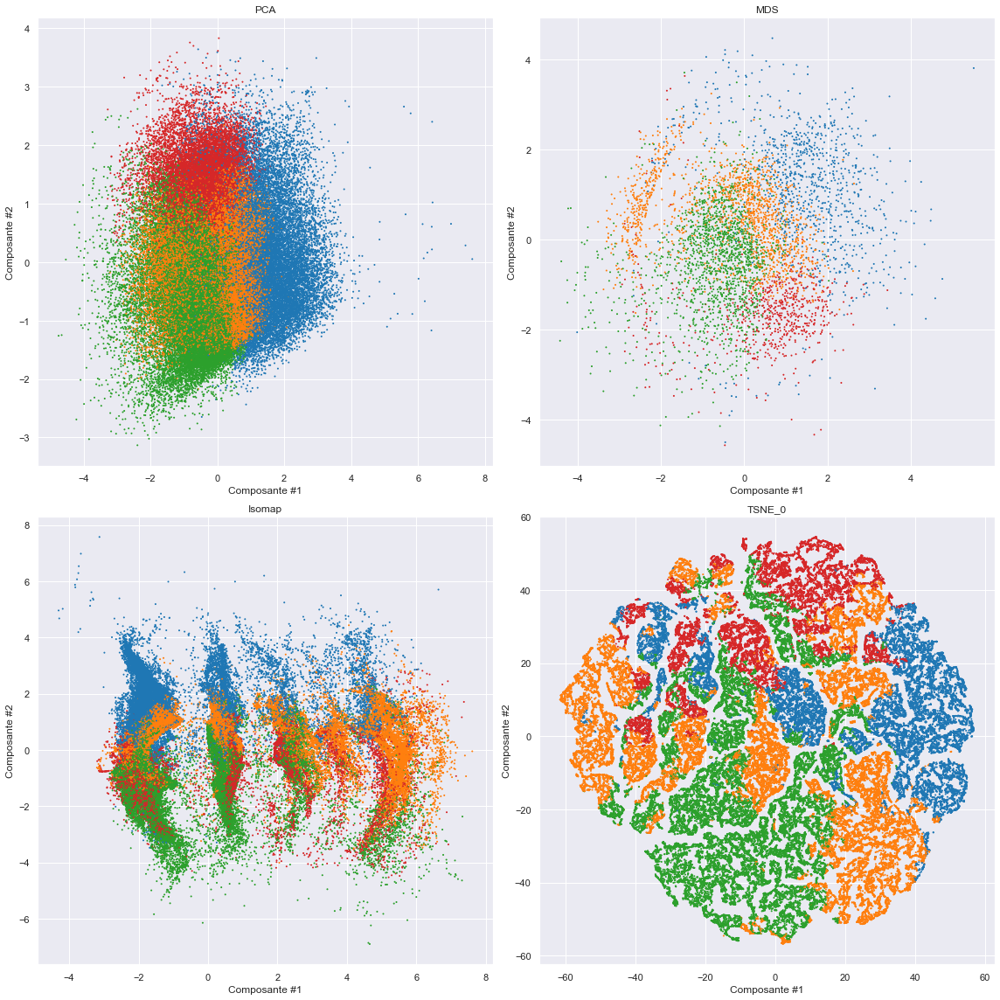

In [473]:
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [474]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 10.5.4 Distributions des Features par Groupe

In [475]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau

In [476]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                        0             1             2  \
order_payment_total         count  19154.000000  30998.000000  31804.000000   
                            mean      -0.542640     -0.466296      0.886097   
                            std        0.892557      0.706996      0.800138   
                            min       -5.884510     -2.433369     -0.631551   
                            25%       -1.190434     -0.961889      0.319102   
                            50%       -0.618476     -0.522882      0.699203   
                            75%        0.019034     -0.111267      1.296369   
                            max        3.798729      2.738275      6.011733   
order_avg_shipping_distance count  19154.000000  30998.000000  31804.000000   
                            mean      -1.564805      0.451791      0.334056   
                            std        0.827074      0.474031      0.608480   
                            min       -9.099968     -1.740387     -3.345493   
                            25%       -2.109834      0.093870      0.028314   
                            50%       -1.522912      0.394599      0.324595   
                            75%       -0.935212      0.726483      0.699805   
                            max        0.954075      2.363217      1.794412   
recency                     count  19154.000000  30998.000000  31804.000000   
                            mean       0.148840      0.402217      0.162807   
                            std        0.971940      0.685405      0.860037   
                            min       -2.976835     -1.869058     -2.966621   
                            25%       -0.494653     -0.146337     -0.377773   
                            50%        0.286611      0.419476      0.220994   
                            75%        0.925993      0.960908      0.835075   
                            max        1.590980      1.878712      1.655003   
review_score                count  19154.000000  30998.000000  31804.000000   
                            mean       0.111650     -0.286383      0.263903   
                            std        0.933790      1.193978      0.705357   
                            min       -2.297030     -2.297030     -2.297030   
                            25%       -0.057397     -1.550486     -0.057397   
                            50%        0.689147      0.689147      0.689147   
                            75%        0.689147      0.689147      0.689147   
                            max        0.689147      0.689147      0.689147   
order_is_delivered          count  19154.000000  30998.000000  31804.000000   
                            mean       0.980569      0.940725      0.983089   
                            std        0.167308      0.297137      0.161456   
                            min       -1.000000     -1.000000     -1.000000   
                            25%        1.000000      1.000000      1.000000   
                            50%        1.000000      1.000000      1.000000   
                            75%        1.000000      1.000000      1.000000   
                            max        1.000000      1.000000      1.000000   

labels                                        3  
order_payment_total         count  14132.000000  
                            mean      -0.235879  
                            std        0.695591  
                            min       -2.363585  
                            25%       -0.687015  
                            50%       -0.213928  
                            75%        0.252327  
                            max        2.490463  
order_avg_shipping_distance count  14132.000000  
                            mean       0.378102  
                            std        0.620963  
                            min       -2.368543  
                            25%        0.024786  
                            50%        0.348837  
          

#### Boxplots

<AxesSubplot:xlabel='labels', ylabel='value'>

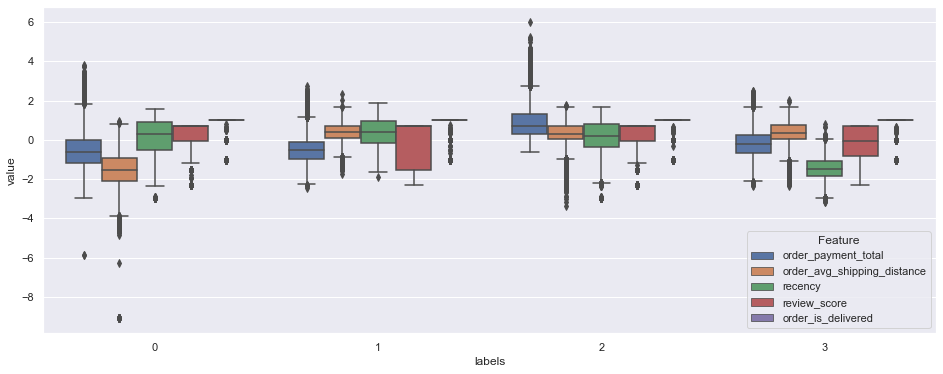

In [477]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))

# 10b. Modèles - Vérsion 5b

## 10b.1 Sélection des Features

In [537]:
passthrough_features = ['order_is_delivered']
standardscale_features = ['recency', 'review_score', 'order_payment_total', 'order_avg_shipping_distance']
log1pscale_features = []
logscale_features = []
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [538]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)

X_reduced = X_scaled.sample(frac=0.05, random_state=seed).astype(np.float32)
all_components = len(X_scaled.columns)

## 10b.2  Créations des Projections

In [539]:
projection_version = "Version5b"

In [540]:
all_my_projections[projection_version] = {}

#### PCA

In [541]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

In [542]:
all_my_projections[projection_version]["PCA"] = {"X_proj" : X_pca, "model": pca}

#### MDS

In [543]:
mds = MDS(n_components=2)
X_reduced_mds = mds.fit_transform(X_reduced)

In [544]:
all_my_projections[projection_version]["MDS"] = {"X_proj" : X_reduced_mds, "model": mds}

#### Isomap

In [545]:
iso = Isomap(n_components=2)
X_reduced_iso = iso.fit_transform(X_reduced)
X_iso = iso.transform(X_scaled)

In [546]:
all_my_projections[projection_version]["Isomap"] = {"X_proj" : X_iso, "model": iso}

#### t_SNE

In [547]:
tsne = TSNE(n_components=2, init='pca')
X_tsne0 = tsne.fit_transform(X_scaled)

In [548]:
all_my_projections[projection_version]["TSNE_0"] = {"X_proj" : X_tsne0, "model": tsne}

## -- BREAK Store/Reload Data --

In [549]:
dill.dump_session('notebook_env.db')

In [550]:
dill.load_session('notebook_env.db')

## 10b.3 K-Means - Vérsion 5b

In [551]:
model_name = "KMeans_5b"

### 10b.3.1 Evaluation du Modèle

In [552]:
model_dict = test_model(X_reduced)
all_my_models[model_name] = model_dict

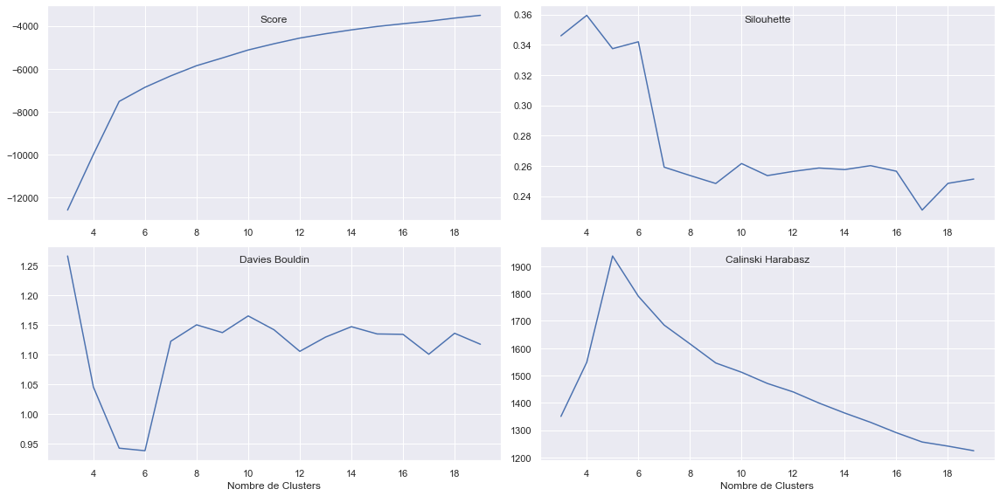

In [553]:
plot_model_evaluation(model_dict)

### 10b.3.2 Choisir un Modèle

In [554]:
n_clusters = 5
km = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = km.fit_predict(X_scaled)
X_labels_reduced = km.predict(X_reduced.astype(float))

### 10b.3.3 Visualisation des Clusters en 2-D

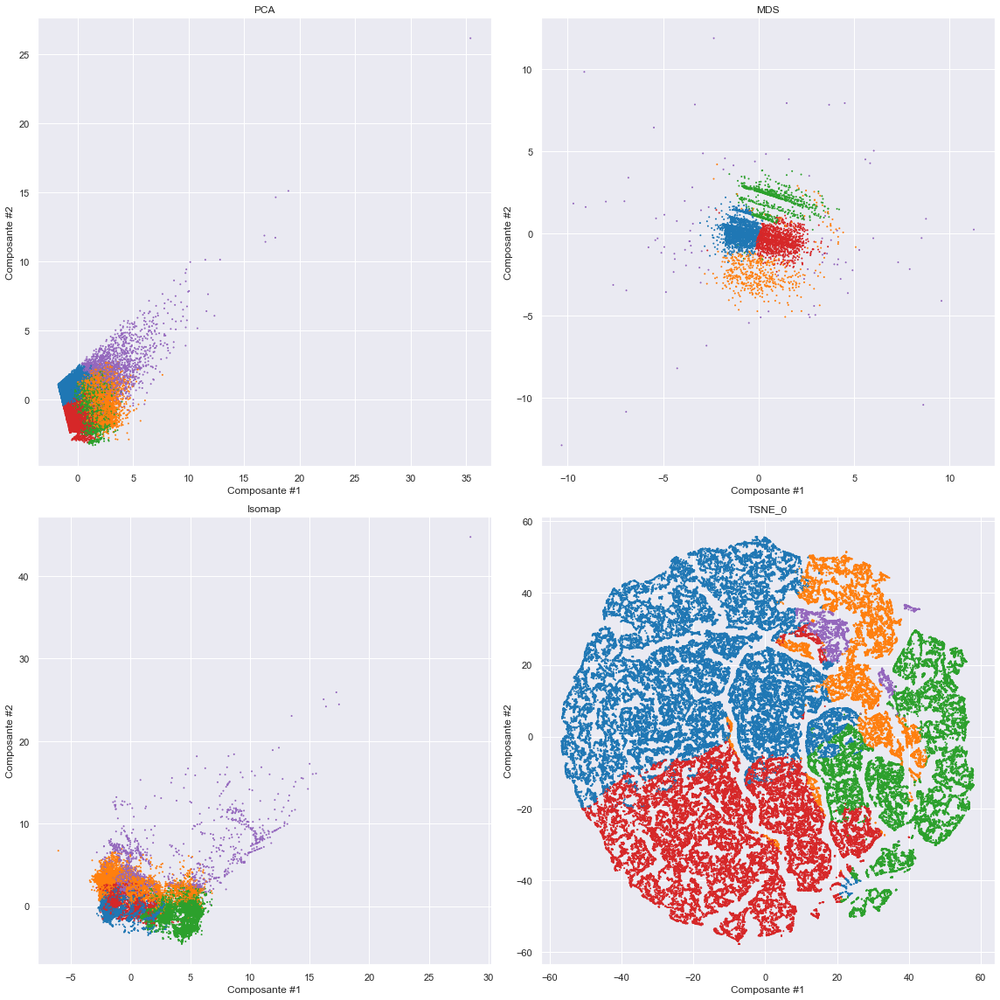

In [556]:
projection_version = "Version5b" 
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

### 10b.3.4 Distributions des Features par Groupe

In [557]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - resumé

In [558]:
pd.DataFrame(km.cluster_centers_, columns=X_scaled.columns).merge(
    pd.Series(km.labels_, name="fraction").value_counts(normalize=True).sort_index(),
    right_index=True, left_index=True)

,recency,review_score,order_payment_total,order_avg_shipping_distance,order_is_delivered,fraction
0,0.763848,0.441564,-0.145306,-0.354301,0.993756,0.407522
1,-0.023553,0.001813,0.066567,2.324600,0.965664,0.107121
2,-0.018411,-1.838200,-0.055128,-0.188872,0.817553,0.163881
3,-1.017231,0.409528,-0.138947,-0.263598,0.987339,0.301078
4,0.003493,-0.108833,5.055249,0.280953,0.922926,0.020398


#### Tableau - détails

In [560]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                        0             1             2  \
recency                     count  39158.000000  10293.000000  15747.000000   
                            mean       0.764443     -0.023609     -0.018411   
                            std        0.476141      0.960298      0.867159   
                            min       -0.166378     -3.159611     -3.158795   
                            25%        0.361021     -0.682222     -0.417369   
                            50%        0.782628      0.079038      0.103684   
                            75%        1.179999      0.744167      0.514682   
                            max        1.872943      1.550253      1.878712   
review_score                count  39158.000000  10293.000000  15747.000000   
                            mean       0.441514      0.002031     -1.838200   
                            std        0.423946      0.937974      0.614764   
                            min       -0.803942     -2.297030     -2.297030   
                            25%       -0.057397     -0.057397     -2.297030   
                            50%        0.689147      0.689147     -2.297030   
                            75%        0.689147      0.689147     -1.550486   
                            max        0.689147      0.689147     -0.617306   
order_payment_total         count  39158.000000  10293.000000  15747.000000   
                            mean      -0.145236      0.066196     -0.055128   
                            std        0.480485      0.637850      0.566872   
                            min       -0.726021     -0.627107     -0.726021   
                            25%       -0.464724     -0.363471     -0.433642   
                            50%       -0.280998     -0.115534     -0.227987   
                            75%        0.005376      0.243553      0.117920   
                            max        2.703360      3.748593      2.960069   
order_avg_shipping_distance count  39158.000000  10293.000000  15747.000000   
                            mean      -0.354219      2.324387     -0.188872   
                            std        0.516540      0.731816      0.614941   
                            min       -1.015365      0.778944     -1.015365   
                            25%       -0.830832      1.691737     -0.604688   
                            50%       -0.424279      2.433517     -0.299491   
                            75%       -0.049753      2.847580      0.158392   
                            max        1.414568     13.585715      2.089006   
order_is_delivered          count  39158.000000  10293.000000  15747.000000   
                            mean       0.993752      0.965664      0.817553   
                            std        0.093111      0.211210      0.507386   
                            min       -1.000000     -1.000000     -1.000000   
                            25%        1.000000      1.000000      1.000000   
                            50%        1.000000      1.000000      1.000000   
                            75%        1.000000      1.000000      1.000000   
                            max        1.000000      1.000000      1.000000   

labels                                        3            4  
recency                     count  28930.000000  1960.000000  
                            mean      -1.016407     0.001790  
                            std        0.618614     1.017357  
                            min       -2.971724    -2.964532  
                            25%       -1.483568    -0.765105  
                            50%       -0.955636     0.134644  
                            75%       -0.473506     0.854440  
                            max       -0.069297     1.609604  
review_score                count  28930.000000  1960.000000  
                            mean       0.409647    -0.109516  
                            std        0.453527     1.100799  
    

#### Boxplots

(-5.0, 15.0)

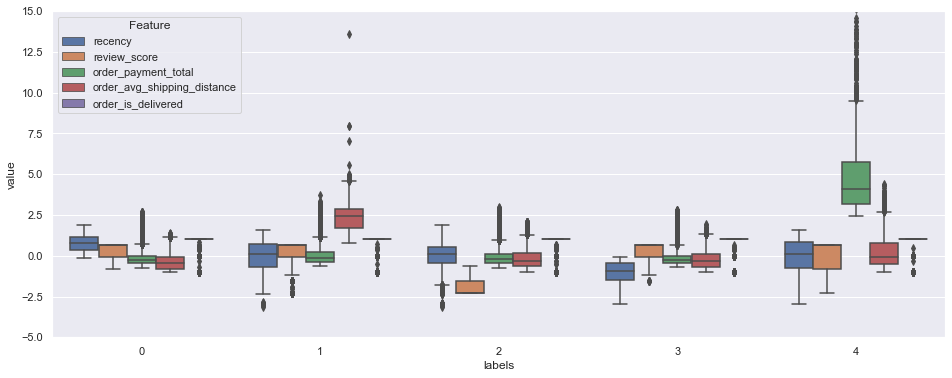

In [564]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5, 15)

(-5.0, 15.0)

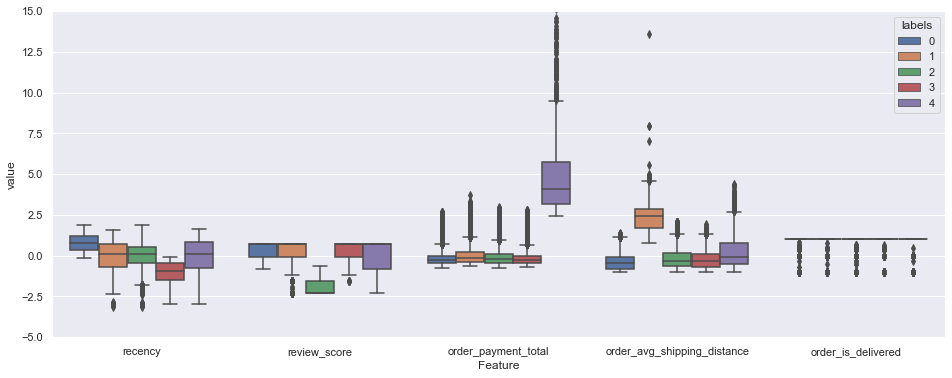

In [565]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="Feature", y="value", hue="labels", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5, 15)

## 10b.4 GaussianMixture - Vérsion 5b

In [566]:
model_name = "GaussianMixture_5b"

### 10b.4.1 Evaluation du Modèle

In [567]:
model_dict = test_model(X_reduced, "GaussianMixture")
all_my_models[model_name] = model_dict

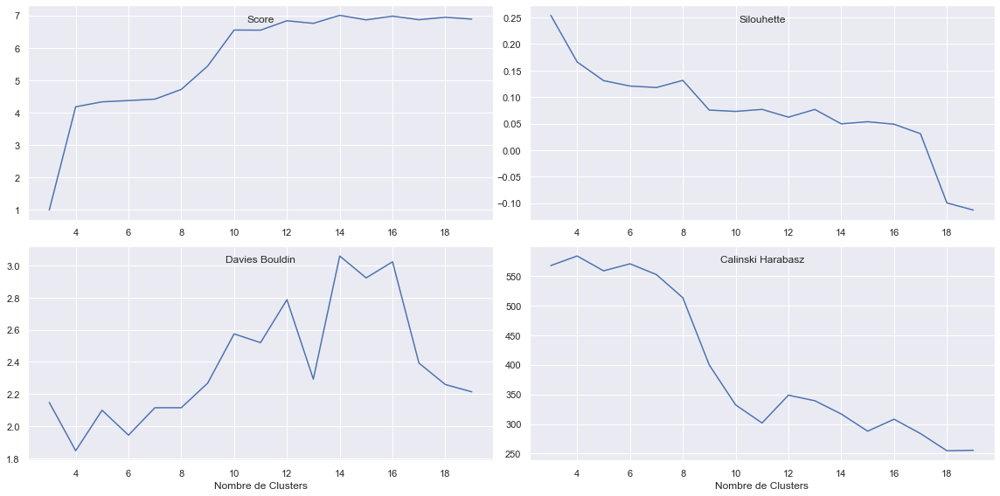

In [568]:
plot_model_evaluation(model_dict)

### 10b.4.2 Choisir un Modèle

In [569]:
n_clusters = 3
gm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
gm.set_params(n_init=10)
X_labels = gm.fit_predict(X_scaled)
X_labels_reduced = gm.predict(X_reduced.astype(float))

### 10b.4.3 Visualisation des Clusters en 2-D

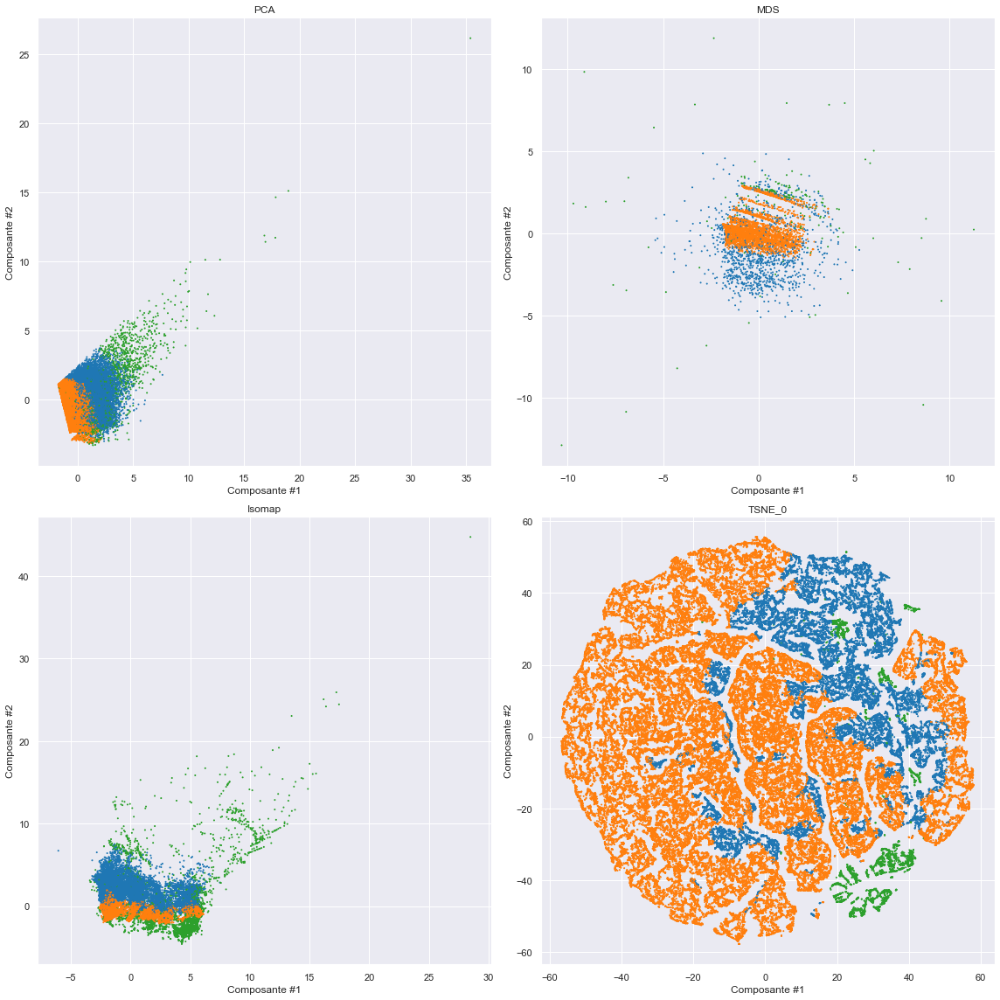

In [570]:
projection_version = "Version5b"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [571]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 10b.4.4 Distributions des Features par Groupe

In [572]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau - resumé

In [573]:
pd.DataFrame(gm.means_, columns=X_scaled.columns).merge(pd.Series(gm.weights_, name="weights"), 
                                                        left_index=True, right_index=True)

,recency,review_score,order_payment_total,order_avg_shipping_distance,order_is_delivered,weights
0,-0.030476,-0.081337,0.540411,0.959851,1.00000,0.256573
1,0.026107,0.103256,-0.276487,-0.355473,1.00000,0.706334
2,-0.286337,-1.403610,1.526897,0.129694,-0.11888,0.037093


#### Tableau - détails

In [574]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                        0             1            2
recency                     count  22536.000000  69996.000000  3556.000000
                            mean      -0.025517      0.022855    -0.288161
                            std        1.002943      0.991045     1.103214
                            min       -2.967019     -2.971724    -3.159611
                            25%       -0.728889     -0.682693    -1.139073
                            50%        0.098322      0.144555    -0.242277
                            75%        0.789380      0.822535     0.580128
                            max        1.558402      1.558593     1.878712
review_score                count  22536.000000  69996.000000  3556.000000
                            mean      -0.086599      0.099419    -1.408126
                            std        1.054635      0.912454     1.166300
                            min       -2.297030     -2.297030    -2.297030
                            25%       -0.803942     -0.057397    -2.297030
                            50%        0.689147      0.689147    -2.297030
                            75%        0.689147      0.689147    -0.803942
                            max        0.689147      0.689147     0.689147
order_payment_total         count  22536.000000  69996.000000  3556.000000
                            mean       0.612174     -0.274506     1.523721
                            std        1.030314      0.250112     3.589772
                            min       -0.632910     -0.682884    -0.726021
                            25%       -0.167184     -0.477814    -0.392957
                            50%        0.445913     -0.328971    -0.084609
                            75%        0.969035     -0.108112     1.266666
                            max        5.364865      0.462477    60.736923
order_avg_shipping_distance count  22536.000000  69996.000000  3556.000000
                            mean       1.063620     -0.349102     0.131050
                            std        1.350990      0.485458     1.109439
                            min       -1.015365     -1.015365    -1.012639
                            25%       -0.208285     -0.795404    -0.552296
                            50%        1.068316     -0.409586    -0.247087
                            75%        2.282846     -0.043245     0.435966
                            max       13.585715      1.012539     5.008011
order_is_delivered          count  22536.000000  69996.000000  3556.000000
                            mean       1.000000      1.000000    -0.121464
                            std        0.000000      0.000000     0.693184
                            min        1.000000      1.000000    -1.000000
                            25%        1.000000      1.000000    -1.000000
                            50%        1.000000      1.000000     0.000000
                            75%        1.000000      1.000000     0.000000
                            max        1.000000      1.000000     1.000000

#### Boxplots

(-5.0, 15.0)

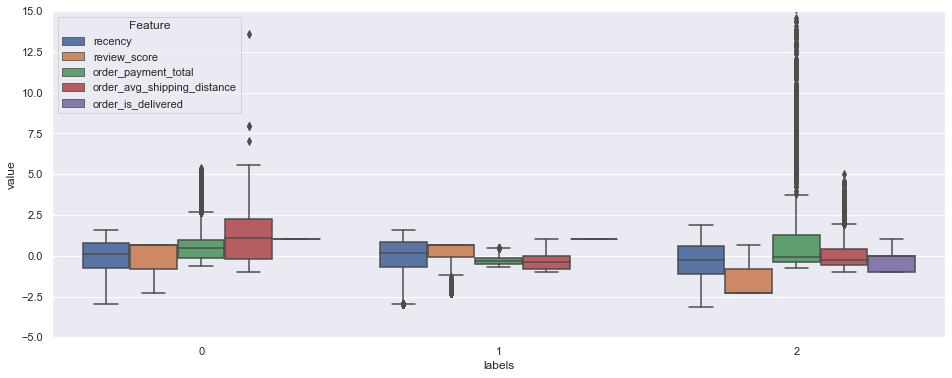

In [575]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5, 15)

(-5.0, 15.0)

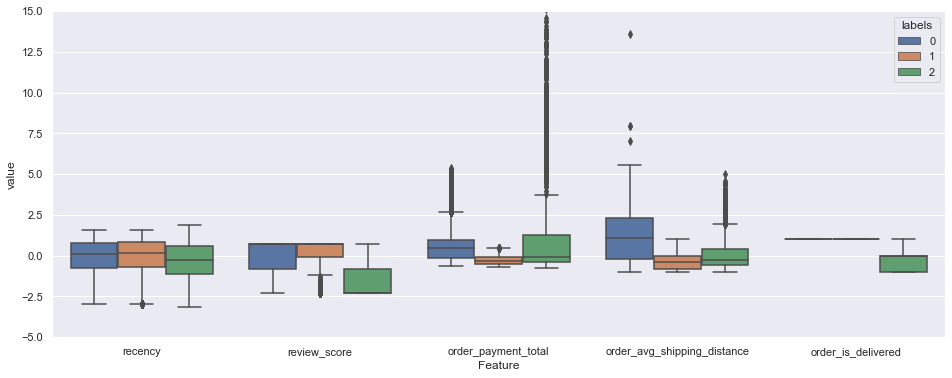

In [576]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="Feature", y="value", hue="labels", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5, 15)

## 10b.5 BIRCH - Vérsion 5b

In [577]:
model_name = "BIRCH_5b"

### 10b.5.1 Evaluation du Modèle

In [578]:
model_dict = test_model(X_reduced, "Birch")
all_my_models[model_name] = model_dict

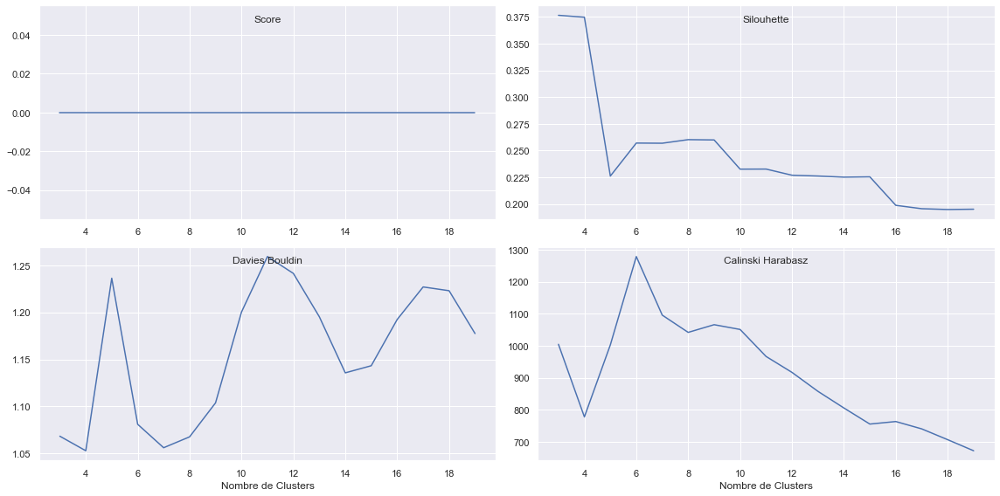

In [579]:
plot_model_evaluation(model_dict)

### 10b.5.2 Choisir un Modèle

In [581]:
n_clusters = 4
bm = all_my_models[model_name]["models"][all_my_models[model_name]["n_clusters"].index(n_clusters)]
X_labels = bm.fit_predict(X_scaled)
X_labels_reduced = bm.predict(X_reduced.astype(float))

### 10b.5.3 Visualisation des Clusters en 2-D

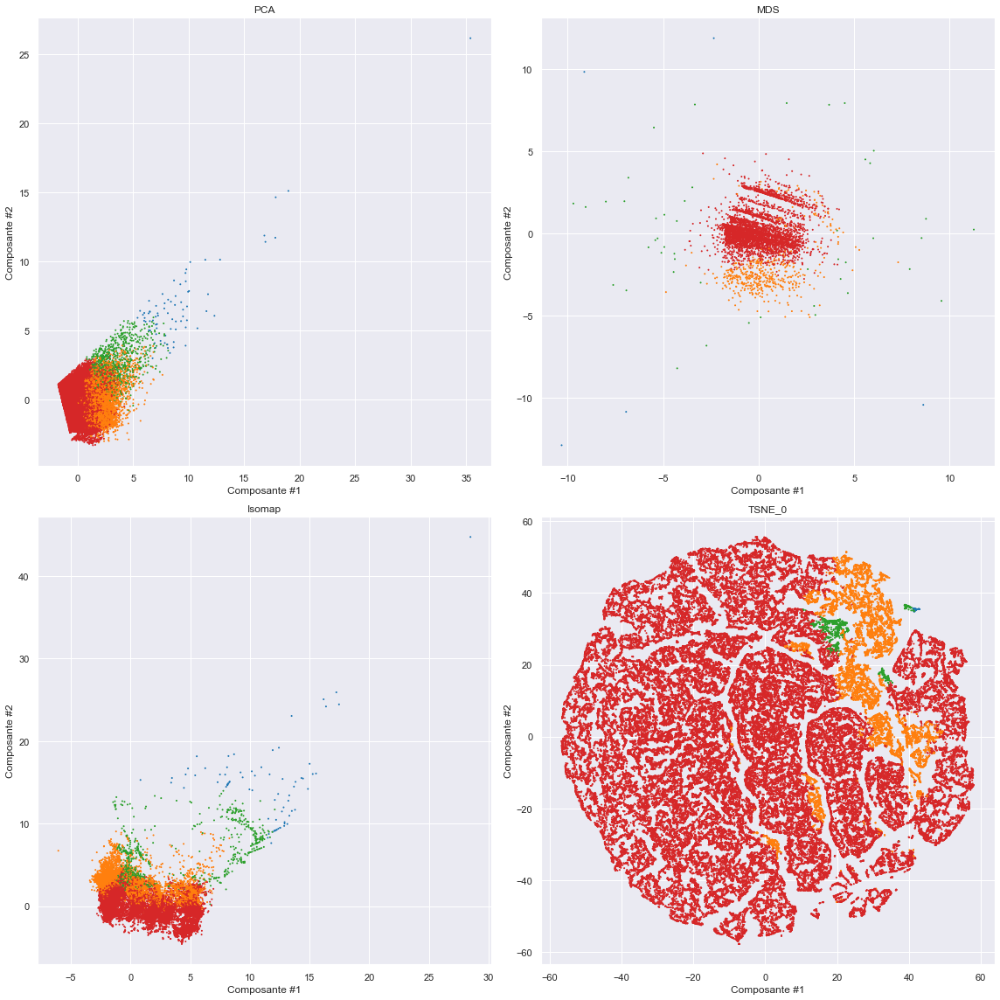

In [582]:
projection_version = "Version5b"
projections_dict = create_projections_dict(projection_version, X_labels, X_labels_reduced)
plot_model_2D_projections(projections_dict)

In [583]:
sns.color_palette()

[(0.2980392156862745, 0.4470588235294118, 0.6901960784313725),
 (0.8666666666666667, 0.5176470588235295, 0.3215686274509804),
 (0.3333333333333333, 0.6588235294117647, 0.40784313725490196),
 (0.7686274509803922, 0.3058823529411765, 0.3215686274509804),
 (0.5058823529411764, 0.4470588235294118, 0.7019607843137254),
 (0.5764705882352941, 0.47058823529411764, 0.3764705882352941),
 (0.8549019607843137, 0.5450980392156862, 0.7647058823529411),
 (0.5490196078431373, 0.5490196078431373, 0.5490196078431373),
 (0.8, 0.7254901960784313, 0.4549019607843137),
 (0.39215686274509803, 0.7098039215686275, 0.803921568627451)]

### 10b.5.4 Distributions des Features par Groupe

In [584]:
data_dict = {("Group"+ str(c)) : X_scaled[X_labels == c] for c in set(X_labels)}

#### Tableau

In [585]:
data = X_scaled.copy()
data['labels'] = X_labels
data.groupby('labels').describe().T

labels                                     0            1           2  \
recency                     count  75.000000  9770.000000  904.000000   
                            mean   -0.104255    -0.188613   -0.067606   
                            std     1.262113     1.003125    1.006693   
                            min    -2.189398    -3.159611   -2.959412   
                            25%    -1.478548    -0.931911   -0.789569   
                            50%     0.261107    -0.128086   -0.097492   
                            75%     0.975518     0.599064    0.792148   
                            max     1.481748     1.550253    1.609604   
review_score                count  75.000000  9770.000000  904.000000   
                            mean   -0.226614    -0.182721   -0.041707   
                            std     1.155064     1.077122    1.063084   
                            min    -2.297030    -2.297030   -2.297030   
                            25%    -0.803942    -0.803942   -0.057397   
                            50%     0.689147    -0.057397    0.689147   
                            75%     0.689147     0.689147    0.689147   
                            max     0.689147     0.689147    0.689147   
order_payment_total         count  75.000000  9770.000000  904.000000   
                            mean   15.673564     0.181911    5.843565   
                            std     7.087605     0.967242    1.915436   
                            min    10.575690    -0.627107    2.472471   
                            25%    11.993414    -0.361132    4.367695   
                            50%    13.337413    -0.108112    5.366462   
                            75%    16.410520     0.277828    7.190053   
                            max    60.736923     7.469005   11.688305   
order_avg_shipping_distance count  75.000000  9770.000000  904.000000   
                            mean    0.343279     2.377425    0.119458   
                            std     1.042422     0.740307    0.927075   
                            min    -0.969350     0.252310   -1.010641   
                            25%    -0.369565     1.859913   -0.520712   
                            50%     0.020710     2.503835   -0.125015   
                            75%     0.882870     2.885412    0.629599   
                            max     3.728863    13.585715    4.162164   
order_is_delivered          count  75.000000  9770.000000  904.000000   
                            mean    0.888889     0.957276    0.898783   
                            std     0.432651     0.238444    0.410262   
                            min    -1.000000    -1.000000   -1.000000   
                            25%     1.000000     1.000000    1.000000   
                            50%     1.000000     1.000000    1.000000   
                            75%     1.000000     1.000000    1.000000   
                            max     1.000000     1.000000    1.000000   

labels                                        3  
recency                     count  85339.000000  
                            mean       0.022401  
                            std        0.997016  
                            min       -3.158795  
                            25%       -0.681181  
                            50%        0.151181  
                            75%        0.823463  
                            max        1.878712  
review_score                count  85339.000000  
                            mean       0.021560  
                            std        0.987771  
                            min       -2.297030  
                            25%       -0.057397  
                            50%        0.689147  
                            75%        0.689147  
                            max        0.689147  
order_payment_total         count  85339.000000  
                            mean      -0.096502  
                            std        0.588014  
      

#### Boxplots

(-5.0, 15.0)

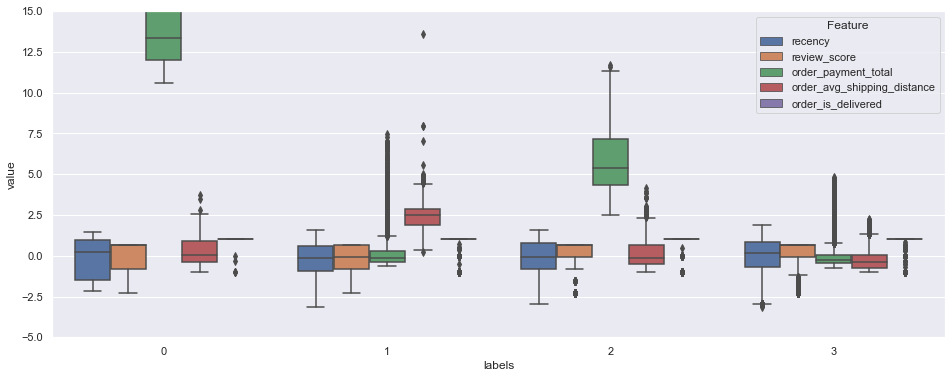

In [587]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="labels", y="value", hue="Feature", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5, 15)

(-5.0, 15.0)

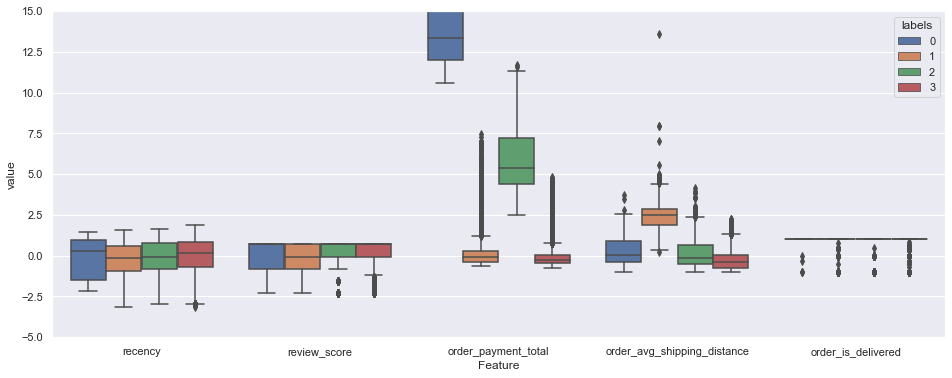

In [590]:
fig, ax = plt.subplots(figsize = (16,6))
sns.boxplot(x="Feature", y="value", hue="labels", data=pd.melt(data, id_vars=['labels'], var_name=['Feature']))
plt.ylim(-5, 15)

# 11. Comparison des Modèles

In [593]:
df_summary = pd.DataFrame()
model_name_list =[]
n_clusters_list = []
silouette_list = []
d_b_list = []
c_h_list = []
for key, dic in all_my_models.items():
    if key.startswith('KMeans'):
        for n in range(3,11):
            model_name_list.append(key)
            n_clusters_list.append(n)
            i = dic['n_clusters'].index(n)
            silouette_list.append(dic['silouette_score'][i])
            c_h_list.append(dic['c_h_score'][i])
            d_b_list.append(dic['d_b_score'][i])
df_summary["Model"] = model_name_list
df_summary["N_Clusters"] = n_clusters_list
df_summary["Silouette"] = silouette_list
df_summary["C_H"] = c_h_list
df_summary["D_B"] = d_b_list
for c, asc in zip(["Silouette", "C_H", "D_B"], [False, False, True]) :
    df_summary[c+"_Rank"] = np.zeros(len(model_name_list))
    for rank, ind in enumerate(df_summary.sort_values(c, ascending=asc).index.values) :
        df_summary.loc[ind,c+"_Rank"] = rank+1
df_summary.sort_values("Silouette", ascending=False).iloc[:50,:]

,Model,N_Clusters,Silouette,C_H,D_B,Silouette_Rank,C_H_Rank,D_B_Rank
18,KMeans_1b,5,0.418858,2792.896364,0.801244,1.0,3.0,1.0
17,KMeans_1b,4,0.410601,2968.437162,0.814622,2.0,1.0,2.0
16,KMeans_1b,3,0.388658,2112.338882,0.974255,3.0,11.0,12.0
23,KMeans_1b,10,0.367159,2637.637163,0.888825,4.0,7.0,3.0
22,KMeans_1b,9,0.363167,2729.699580,0.928952,5.0,6.0,7.0
65,KMeans_5b,4,0.359402,1548.218173,1.045749,6.0,35.0,20.0
21,KMeans_1b,8,0.356197,2806.091801,0.889118,7.0,2.0,4.0
64,KMeans_5b,3,0.345894,1350.215255,1.266354,8.0,42.0,44.0
67,KMeans_5b,6,0.341951,1790.173315,0.938492,9.0,27.0,8.0
19,KMeans_1b,6,0.341312,2756.206418,0.893452,10.0,5.0,5.0


In [687]:
df_summary = pd.DataFrame()
model_name_list =[]
n_clusters_list = []
silouette_list = []
d_b_list = []
c_h_list = []
for key, dic in all_my_models.items():
    if not key.endswith('b'):
        for n in range(4,7):
            model_name_list.append(key)
            n_clusters_list.append(n)
            i = dic['n_clusters'].index(n)
            silouette_list.append(dic['silouette_score'][i])
            c_h_list.append(dic['c_h_score'][i])
            d_b_list.append(dic['d_b_score'][i])
df_summary["Model"] = model_name_list
df_summary["N_Clusters"] = n_clusters_list
df_summary["Silouette"] = silouette_list
df_summary["C_H"] = c_h_list
df_summary["D_B"] = d_b_list
for c, asc in zip(["Silouette", "C_H", "D_B"], [False, False, True]) :
    df_summary[c+"_Rank"] = np.zeros(len(model_name_list))
    for rank, ind in enumerate(df_summary.sort_values(c, ascending=asc).index.values) :
        df_summary.loc[ind,c+"_Rank"] = rank+1
df_summary.sort_values("Silouette", ascending=False).iloc[:50,:]

,Model,N_Clusters,Silouette,C_H,D_B,Silouette_Rank,C_H_Rank,D_B_Rank
9,KMeans_1,4,0.302657,2237.460839,1.014678,1.0,1.0,1.0
0,KMeans_0,4,0.298145,2190.710830,1.032201,2.0,2.0,2.0
10,KMeans_1,5,0.292447,2126.159451,1.042950,3.0,3.0,3.0
1,KMeans_0,5,0.287581,2073.836363,1.056323,4.0,4.0,4.0
11,KMeans_1,6,0.280849,2013.379981,1.147322,5.0,5.0,7.0
2,KMeans_0,6,0.277204,1956.969284,1.148654,6.0,6.0,8.0
16,BIRCH_1,5,0.256525,1473.528706,1.146042,7.0,8.0,6.0
45,KMeans_5,4,0.255961,1476.324037,1.258837,8.0,7.0,13.0
17,BIRCH_1,6,0.245541,1267.700712,1.093469,9.0,13.0,5.0
46,KMeans_5,5,0.235623,1446.240287,1.195127,10.0,9.0,10.0


# 12. Agglomerative Clustering

In [595]:
passthrough_features = []
standardscale_features = ['recency', 'review_score']
log1pscale_features = ['order_payment_total']
logscale_features = []
preprocessor_X = create_preprocessor_X(logscale_features = logscale_features, 
                                       standardscale_features = standardscale_features,
                                       log1pscale_features = log1pscale_features)

In [596]:
X = customers_df[logscale_features + log1pscale_features + standardscale_features + passthrough_features].dropna().copy()
X_scaled = preprocessor_X.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, index = X.index, columns = X.columns).astype(float)

X_reduced = X_scaled.sample(frac=0.05, random_state=seed).astype(np.float32)
all_components = len(X_scaled.columns)

In [598]:
from sklearn.neighbors import kneighbors_graph
knn_graph = kneighbors_graph(X_scaled, 30, include_self=False)

In [599]:
agg = AgglomerativeClustering(n_clusters=4, connectivity=knn_graph, linkage='ward', compute_distances=True)
#X_train = X_scaled_0.sample(frac=0.45, random_state=42).astype(np.float32)
X_labels = agg.fit_predict(X_scaled)

In [602]:
from scipy.cluster.hierarchy import dendrogram


def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack(
        [model.children_, model.distances_, counts]
    ).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

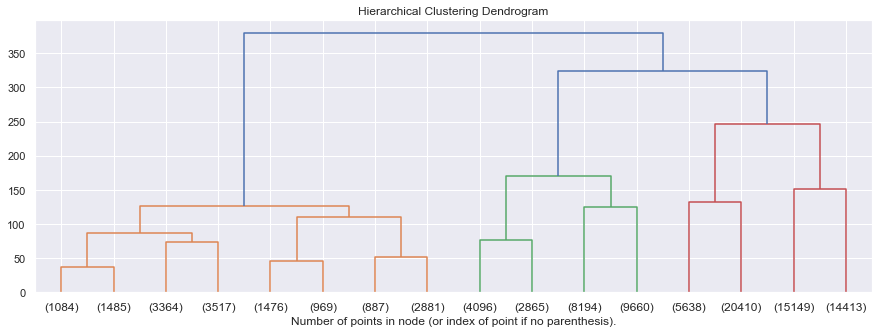

In [605]:
plt.figure(figsize=(15,5))
plt.title("Hierarchical Clustering Dendrogram")
# plot the top levels of the dendrogram
plot_dendrogram(agg, truncate_mode="level", p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

In [100]:
agg.__dict__

{'n_clusters': 4,
 'distance_threshold': None,
 'memory': None,
 'connectivity': <96088x96088 sparse matrix of type '<class 'numpy.float64'>'
 	with 2882640 stored elements in Compressed Sparse Row format>,
 'compute_full_tree': 'auto',
 'linkage': 'ward',
 'affinity': 'euclidean',
 'compute_distances': True,
 'n_features_in_': 4,
 'children_': array([[ 35768,  62330],
        [ 79821,  96024],
        [ 40770,  45097],
        ...,
        [192169, 192170],
        [192171, 192172],
        [192167, 192173]], dtype=int64),
 'n_connected_components_': 1,
 'n_leaves_': 96088,
 'distances_': array([0.00000000e+00, 6.79083262e-07, 7.54536958e-07, ...,
        2.62896278e+02, 3.20175475e+02, 3.66977986e+02]),
 'n_clusters_': 4,
 'labels_': array([0, 1, 1, ..., 3, 1, 2], dtype=int64)}